# **PM-PR-0017:  No-Churn Telecom**

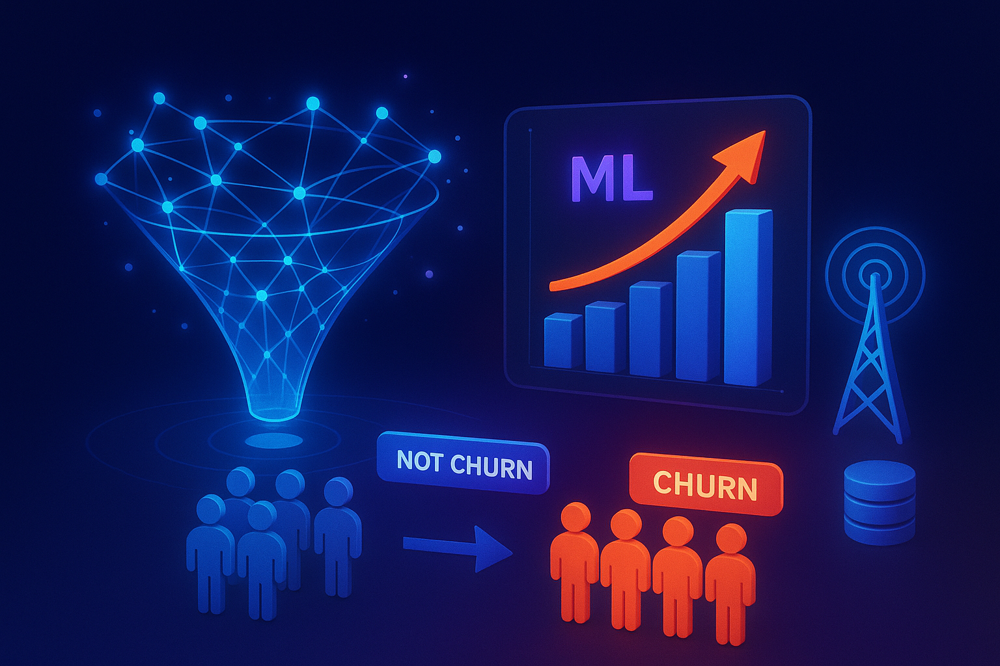

## **Project Type - Classification**

### **Category: Telecom–Churn Rate ML**

Name - **Ari R**

Contribution - Individual

# **Problem Statement:**

## **Business Case:**

- No-Churn Telecom is an established Telecom operator in Europe
with more than a decade in Business. Due to new players in the
market, telecom industry has become very competitive and
retaining customers becoming a challenge.

- In spite of No-Churn initiatives of reducing tariffs and promoting
more offers, the churn rate ( percentage of customers migrating to
competitors) is well above 10%.

- No-Churn wants to explore possibility of Machine Learning to help
with following use cases to retain competitive edge in the industry.

## **Project Goal:**

- Understanding the variables that are influencing the customers
to migrate.

- Creating Churn risk scores that can be indicative to drive
retention campaigns.

- Introduce new predicting variable "CHURN-FLAG" with values
YES(1) or NO(0) so that email campaigns with lucrative offers
can be targeted to Churn YES customers.

# ***Let's Begin!***

# **1. Know Your Data**

## **1.1. Import Libraries:**

In [2]:
# ===== Imports =====

# ===== General =====
import numpy as np
import pandas as pd
import os
import math
import warnings
warnings.filterwarnings('ignore')
import mysql.connector

# ===== Visualization =====
import seaborn as sns
import missingno as msno
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import scipy.stats as stats
from matplotlib import patheffects
from matplotlib.patches import Circle
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as mpatches
import matplotlib.colors as mcolors
import matplotlib.patheffects as path_effects
%matplotlib inline

# ===== Hypotheses testing =====
from scipy.stats import chi2_contingency

# ===== Preprocessing =====
from sklearn.preprocessing import StandardScaler

# ===== Outlier Influence =====
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant
import statsmodels.api as sm

# ===== Imbalanced handling =====
from imblearn.over_sampling import SMOTE

# ===== Model Selection =====
import time
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.model_selection import RandomizedSearchCV, cross_val_score
from sklearn.model_selection import GridSearchCV

# ===== Evaluation Metrics =====
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score, roc_auc_score,
    confusion_matrix, classification_report, roc_curve, precision_recall_curve, auc, ConfusionMatrixDisplay
)
from sklearn.calibration import calibration_curve
from sklearn.model_selection import StratifiedKFold, cross_val_score

## **1.2. Data Collection / Loading:**

### **1.2.1. Connecting to the database server**

In [13]:
# ===== Establish connection to the database server =====
connection = mysql.connector.connect(
    host="18.136.157.135",          # Database server IP address
    user="dm_team3",                # Database username
    password="DM!$!Team!27@9!20&",  # Database password
    database="project_telecom"      # Database name
)

### **1.2.2. Fetching data from the database**

In [14]:
# ===== Check the number of databases available on the server =====
cursor = connection.cursor()
cursor.execute("SHOW DATABASES")

# ===== Display all available databases =====
for db in cursor:
    print(db)

('information_schema',)
('project_telecom',)


### **1.2.3. Reading a table from the SQL database**

In [15]:
# ===== SQL query to select all data from the table =====
query = "SELECT * FROM telecom_churn_data"

# ===== Read the table from the SQL database into a DataFrame =====
df = pd.read_sql(query, connection)

# ===== Display the DataFrame =====
df.head(7).T

,0,1,2,3,4,5,6
columns1,KS,OH,NJ,OH,OK,AL,MA
columns2,128,107,137,84,75,118,121
columns3,415,415,415,408,415,510,510
columns4,382-4657,371-7191,358-1921,375-9999,330-6626,391-8027,355-9993
columns5,no,no,no,yes,yes,yes,no
columns6,yes,yes,no,no,no,no,yes
columns7,25,26,0,0,0,0,24
columns8,265.1,161.6,243.4,299.4,166.7,223.4,218.2
columns9,110,123,114,71,113,98,88
columns10,45.07,27.47,41.38,50.9,28.34,37.98,37.09


## **1.3. Dataset Information:**

In [16]:
# ===== Checking the info of dataset =====
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4617 entries, 0 to 4616
Data columns (total 21 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   columns1   4617 non-null   object
 1   columns2   4617 non-null   object
 2   columns3   4617 non-null   object
 3   columns4   4617 non-null   object
 4   columns5   4617 non-null   object
 5   columns6   4617 non-null   object
 6   columns7   4617 non-null   object
 7   columns8   4617 non-null   object
 8   columns9   4617 non-null   object
 9   columns10  4617 non-null   object
 10  columns11  4617 non-null   object
 11  columns12  4617 non-null   object
 12  columns13  4617 non-null   object
 13  columns14  4617 non-null   object
 14  columns15  4617 non-null   object
 15  columns16  4617 non-null   object
 16  columns17  4617 non-null   object
 17  columns18  4617 non-null   object
 18  columns19  4617 non-null   object
 19  columns20  4617 non-null   object
 20  columns21  4617 non-null   obj

In [17]:
# ===== Checking the no. of rows and columns =====
df.shape

(4617, 21)

# **2. Data wrangling / Cleaning**

## **2.1. Renaming the columns**

In [18]:
# ===== Define new column names for the DataFrame =====
new_column_names = {
    'columns1' : 'State',
    'columns2' : 'Account_Length',
    'columns3' : 'Area_Code',
    'columns4' : 'Phone',
    'columns5' : 'International_Plan',
    'columns6' : 'VMail_Plan',
    'columns7' : 'VMail_Message',
    'columns8' : 'Day_Mins',
    'columns9' : 'Day_Calls',
    'columns10': 'Day_Charge',
    'columns11': 'Eve_Mins',
    'columns12': 'Eve_Calls',
    'columns13': 'Eve_Charge',
    'columns14': 'Night_Mins',
    'columns15': 'Night_Calls',
    'columns16': 'Night_Charge',
    'columns17': 'International_Mins',
    'columns18': 'International_Calls',
    'columns19': 'International_Charge',
    'columns20': 'CustServ_Calls',
    'columns21': 'Churn'
}

# ===== Rename the columns in the DataFrame =====
df.rename(columns=new_column_names, inplace=True)

In [19]:
# ===== Checking the info of dataset =====
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4617 entries, 0 to 4616
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   State                 4617 non-null   object
 1   Account_Length        4617 non-null   object
 2   Area_Code             4617 non-null   object
 3   Phone                 4617 non-null   object
 4   International_Plan    4617 non-null   object
 5   VMail_Plan            4617 non-null   object
 6   VMail_Message         4617 non-null   object
 7   Day_Mins              4617 non-null   object
 8   Day_Calls             4617 non-null   object
 9   Day_Charge            4617 non-null   object
 10  Eve_Mins              4617 non-null   object
 11  Eve_Calls             4617 non-null   object
 12  Eve_Charge            4617 non-null   object
 13  Night_Mins            4617 non-null   object
 14  Night_Calls           4617 non-null   object
 15  Night_Charge          4617 non-null   

## **2.2. Domain Analysis:**

In [ ]:
# ===== Domain Analysis =====
df.columns

Index(['State', 'Account_Length', 'Area_Code', 'Phone', 'International_Plan',
       'VMail_Plan', 'VMail_Message', 'Day_Mins', 'Day_Calls', 'Day_Charge',
       'Eve_Mins', 'Eve_Calls', 'Eve_Charge', 'Night_Mins', 'Night_Calls',
       'Night_Charge', 'International_Mins', 'International_Calls',
       'International_Charge', 'CustServ_Calls', 'Churn'],
      dtype='object')

### **Domain Analysis Report:**

| **Feature No.** | **Feature Name**      | **Type**    | **Description / Categories**                              |
| --------------- | --------------------- | ----------- | --------------------------------------------------------- |
| 1               | State                 | Categorical | U.S. state of the customer                                |
| 2               | Account\_Length       | Numerical   | Number of months the account has been active              |
| 3               | Area\_Code            | Categorical | Three-digit area code of the customer                     |
| 4               | Phone                 | Categorical | Customer phone number (identifier)                        |
| 5               | International\_Plan   | Categorical | Whether the customer has an international plan (Yes / No) |
| 6               | VMail\_Plan           | Categorical | Whether the customer has a voicemail plan (Yes / No)      |
| 7               | VMail\_Message        | Numerical   | Number of voicemail messages                              |
| 8               | Day\_Mins             | Numerical   | Total minutes of daytime calls                            |
| 9               | Day\_Calls            | Numerical   | Total number of daytime calls                             |
| 10              | Day\_Charge           | Numerical   | Total charges for daytime calls                           |
| 11              | Eve\_Mins             | Numerical   | Total minutes of evening calls                            |
| 12              | Eve\_Calls            | Numerical   | Total number of evening calls                             |
| 13              | Eve\_Charge           | Numerical   | Total charges for evening calls                           |
| 14              | Night\_Mins           | Numerical   | Total minutes of night calls                              |
| 15              | Night\_Calls          | Numerical   | Total number of night calls                               |
| 16              | Night\_Charge         | Numerical   | Total charges for night calls                             |
| 17              | International\_Mins   | Numerical   | Total minutes of international calls                      |
| 18              | International\_Calls  | Numerical   | Total number of international calls                       |
| 19              | International\_Charge | Numerical   | Total charges for international calls                     |
| 20              | CustServ\_Calls       | Numerical   | Number of calls made to customer service                  |
| 21              | Churn                 | Categorical | Whether the customer churned (Yes / No)                   |

## **2.3. Transform columns into proper data types**

In [20]:
# ===== Convert columns to appropriate data types =====
df['State'] = df['State'].astype('object')
df['Account_Length'] = df['Account_Length'].astype('int64')
df['Area_Code'] = df['Area_Code'].astype('int64')
df['Phone'] = df['Phone'].astype('object')
df['International_Plan'] = df['International_Plan'].astype('object')
df['VMail_Plan'] = df['VMail_Plan'].astype('object')
df['VMail_Message'] = df['VMail_Message'].astype('int64')
df['Day_Mins'] = df['Day_Mins'].astype('float64')
df['Day_Calls'] = df['Day_Calls'].astype('int64')
df['Day_Charge'] = df['Day_Charge'].astype('float64')
df['Eve_Mins'] = df['Eve_Mins'].astype('float64')
df['Eve_Calls'] = df['Eve_Calls'].astype('int64')
df['Eve_Charge'] = df['Eve_Charge'].astype('float64')
df['Night_Mins'] = df['Night_Mins'].astype('float64')
df['Night_Calls'] = df['Night_Calls'].astype('int64')
df['Night_Charge'] = df['Night_Charge'].astype('float64')
df['International_Mins'] = df['International_Mins'].astype('float64')
df['International_Calls'] = df['International_Calls'].astype('int64')
df['International_Charge'] = df['International_Charge'].astype('float64')
df['CustServ_Calls'] = df['CustServ_Calls'].astype('int64')
df['Churn'] = df['Churn'].astype('object')

print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4617 entries, 0 to 4616
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   State                 4617 non-null   object 
 1   Account_Length        4617 non-null   int64  
 2   Area_Code             4617 non-null   int64  
 3   Phone                 4617 non-null   object 
 4   International_Plan    4617 non-null   object 
 5   VMail_Plan            4617 non-null   object 
 6   VMail_Message         4617 non-null   int64  
 7   Day_Mins              4617 non-null   float64
 8   Day_Calls             4617 non-null   int64  
 9   Day_Charge            4617 non-null   float64
 10  Eve_Mins              4617 non-null   float64
 11  Eve_Calls             4617 non-null   int64  
 12  Eve_Charge            4617 non-null   float64
 13  Night_Mins            4617 non-null   float64
 14  Night_Calls           4617 non-null   int64  
 15  Night_Charge         

**Observation**:-

* The DataFrame has 4617 entries (rows) and 21 columns.

* Object: State, Phone, International_Plan, VMail_Plan, Churn

* Int64: Account_Length, Area_Code, VMail_Message, Day_Calls, Eve_Calls, Night_Calls, International_calls, CustServ_Calls

* Float64: Day_Mins, Day_Charge, Eve_Mins, Eve_Charge, Night_Mins, Night_Charge, International_Mins, International_Charge

* All columns have 4617 non-null entries, indicating that there are no missing values in any column.

## **2.4. Basic Overview:**

In [ ]:
# ===== Basic Overview =====

# ===== To view the summary stats of numerical columns =====
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Account_Length,4617.0,100.645224,39.597194,1.00,74.00,100.00,127.00,243.00
Area_Code,4617.0,437.046350,42.288212,408.00,408.00,415.00,510.00,510.00
VMail_Message,4617.0,7.849903,13.592333,0.00,0.00,0.00,17.00,51.00
Day_Mins,4617.0,180.447152,53.983540,0.00,143.70,180.00,216.80,351.50
Day_Calls,4617.0,100.054364,19.883027,0.00,87.00,100.00,113.00,165.00
Day_Charge,4617.0,30.676576,9.177145,0.00,24.43,30.60,36.86,59.76
Eve_Mins,4617.0,200.429088,50.557001,0.00,165.90,200.80,234.00,363.70
Eve_Calls,4617.0,100.179770,19.821314,0.00,87.00,101.00,114.00,170.00
Eve_Charge,4617.0,17.036703,4.297332,0.00,14.10,17.07,19.89,30.91
Night_Mins,4617.0,200.623933,50.543616,23.20,167.10,200.80,234.90,395.00


### Insights:-

* There is no null value in any column

* The mean value for the "Area_Code" is 437.046350, which is higher compared to the other features in the dataset.

* The standard deviation for the "Day_Mins" feature is 53.983540, which is higher compared to the standard deviations of other features in the dataset.

* In the context of the dataset, having a value of 0 for VMail_Message, Day_Mins, Day_Calls, Day_Charge,Eve_Mins,	Eve_Calls,	Eve_Charge,International_Mins, International_calls,	International_Charge,CustServ_Calls	 does not necessarily indicate corrupt data. It could simply mean that some customers did not receive any   during the observed period.

* 25th percentile (Q1), 50th percentile (Q2), 75th percentile (Q3)

* The maximum value for the "Area_Code" column is 510.000000, which is higher than the other values in the dataset.

### Insights:-


* Account Length:
The average account length is approximately 100.65 months, with a minimum of 1 month and a maximum of 243 months.
The distribution is relatively spread out, with a standard deviation of approximately 39.60.

* Area Code:
The area codes in the dataset range from 408 to 510.
The most common area code appears to be around 415, as it falls within the 50th percentile (median).

* Voicemail Messages:
On average, customers receive around 7.85 voicemail messages, with a maximum of 51.
The majority of customers (at least 75%) have either no voicemail messages or a small number of them.

* Day Usage:
Average day minutes used is 180.45, with a minimum of 0 and a maximum of 351.5.
Average number of day calls is 100.05.
The average charge for daytime usage is $30.68.

* Evening Usage:
Average evening minutes used is 200.43, with a minimum of 0 and a maximum of 363.7.
Average number of evening calls is 100.18.
The average charge for evening usage is $17.04.

* Night Usage:
Average night minutes used is 200.62, with a minimum of 23.2 and a maximum of 395.
Average number of night calls is 99.94.
The average charge for nighttime usage is $9.03.

* International Usage:
Average international minutes used is 10.28, with a minimum of 0 and a maximum of 20.
Average number of international calls is 4.43.
The average charge for international usage is $2.78.

* Customer Service Calls:
On average, customers make approximately 1.57 calls to customer service, with a maximum of 9.

In [ ]:
# ===== To View the categorical columns =====
df.describe(include='O').T

,count,unique,top,freq
State,4617,51,WV,149
Phone,4617,4617,409-6884,1
International_Plan,4617,2,no,4171
VMail_Plan,4617,2,no,3381
Churn,4617,2,False.,3961


In [ ]:
# ===== Checking first five rows of dataset =====
df.head(7).T

,0,1,2,3,4,5,6
State,KS,OH,NJ,OH,OK,AL,MA
Account_Length,128,107,137,84,75,118,121
Area_Code,415,415,415,408,415,510,510
Phone,382-4657,371-7191,358-1921,375-9999,330-6626,391-8027,355-9993
International_Plan,no,no,no,yes,yes,yes,no
VMail_Plan,yes,yes,no,no,no,no,yes
VMail_Message,25,26,0,0,0,0,24
Day_Mins,265.1,161.6,243.4,299.4,166.7,223.4,218.2
Day_Calls,110,123,114,71,113,98,88
Day_Charge,45.07,27.47,41.38,50.9,28.34,37.98,37.09


In [ ]:
# ===== Checking last five rows of dataset =====
df.tail(7).T

,4610,4611,4612,4613,4614,4615,4616
State,NM,HI,NY,NM,VT,MI,IN
Account_Length,138,90,57,177,67,98,140
Area_Code,408,408,510,408,408,415,415
Phone,419-8866,342-3593,345-7512,343-6820,338-4794,355-8388,409-6884
International_Plan,no,no,no,no,no,no,no
VMail_Plan,no,no,yes,yes,yes,yes,no
VMail_Message,0,0,25,29,33,23,0
Day_Mins,63.7,193.8,144.0,189.0,127.5,168.9,204.7
Day_Calls,114,90,81,91,126,98,100
Day_Charge,10.83,32.95,24.48,32.13,21.68,28.71,34.8


## **2.5. Extracting categorical and numerical columns**

In [21]:
# ===== Extracting categorical and numerical columns =====
cat_col = [col for col in df.columns if df[col].dtype == 'object']
num_col = [col for col in df.columns if df[col].dtype != 'object']

# ===== Looking at unique values in categorical and numerical columns =====
print("Categorical Columns:\n")
for col in cat_col:
    print(f'\n{col}:\n{df[col].unique()}')

print("\nNumerical Columns:\n")
for col in num_col:
    print(f'\n{col}:\n{df[col].unique()}')

Categorical Columns:


State:
['KS' 'OH' 'NJ' 'OK' 'AL' 'MA' 'MO' 'LA' 'WV' 'IN' 'RI' 'IA' 'MT' 'NY'
 'ID' 'VT' 'VA' 'TX' 'FL' 'CO' 'AZ' 'SC' 'NE' 'WY' 'HI' 'IL' 'NH' 'GA'
 'AK' 'MD' 'AR' 'WI' 'OR' 'MI' 'DE' 'UT' 'CA' 'MN' 'SD' 'NC' 'WA' 'NM'
 'NV' 'DC' 'KY' 'ME' 'MS' 'TN' 'PA' 'CT' 'ND']

Phone:
[' 382-4657' ' 371-7191' ' 358-1921' ... ' 338-4794' ' 355-8388'
 ' 409-6884']

International_Plan:
[' no' ' yes']

VMail_Plan:
[' yes' ' no']

Churn:
[' False.' ' True.']

Numerical Columns:


Account_Length:
[128 107 137  84  75 118 121 147 117 141  65  74 168  95  62 161  85  93
  76  73  77 130 111 132 174  57  54  20  49 142 172  12  72  36  78 136
 149  98 135  34 160  64  59 119  97  52  60  10  96  87  81  68 125 116
  38  40  43 113 126 150 138 162  90  50  82 144  46  70  55 106  94 155
  80 104  99 120 108 122 157 103  63 112  41 193  61  92 131 163  91 127
 110 140  83 145  56 151 139   6 115 146 185 148  32  25 179  67  19 170
 164  51 208  53 105  66  86  35  88 123  45 100 215  

### **Categorical Columns Observation:**

| **Feature Name**    | **Observation / Categories**                |
| ------------------- | ------------------------------------------- |
| State               | 51 unique U.S. states represented           |
| Phone               | Unique phone numbers; acts as an identifier |
| International\_Plan | Two categories: ' yes', ' no'               |
| VMail\_Plan         | Two categories: ' yes', ' no'               |
| Churn               | Two categories: ' True.', ' False.'         |


### **Numerical Columns Observation:**

| **Feature Name**      | **Observation / Range / Notes**                                     |
| --------------------- | ------------------------------------------------------------------- |
| Account\_Length       | Values range from 1 to 243 months; numeric count of customer tenure |
| Area\_Code            | Three unique area codes: 415, 408, 510                              |
| VMail\_Message        | Range from 0 to 51; number of voicemail messages                    |
| Day\_Mins             | Daytime call minutes, roughly 0–350 mins                            |
| Day\_Calls            | Number of daytime calls, roughly 0–165 calls                        |
| Day\_Charge           | Charges for daytime calls, roughly 0–60 units                       |
| Eve\_Mins             | Evening call minutes, roughly 0–350 mins                            |
| Eve\_Calls            | Number of evening calls, roughly 0–170 calls                        |
| Eve\_Charge           | Charges for evening calls, roughly 0–60 units                       |
| Night\_Mins           | Nighttime call minutes, roughly 0–350 mins                          |
| Night\_Calls          | Number of night calls, roughly 0–150 calls                          |
| Night\_Charge         | Charges for night calls, roughly 0–50 units                         |
| International\_Mins   | International call minutes, roughly 0–20 mins                       |
| International\_Calls  | Number of international calls, roughly 0–20 calls                   |
| International\_Charge | Charges for international calls, roughly 0–5.5 units                |
| CustServ\_Calls       | Calls to customer service, roughly 0–9 calls                        |

In [ ]:
# ===== Looking at value counts in categorical and numerical columns =====
print("Categorical Columns:\n")
for col in cat_col:
    print(f'\n{col}:\n{df[col].value_counts()}')

print("\nNumerical Columns:\n")
for col in num_col:
    print(f'\n{col}:\n{df[col].value_counts()}')

Categorical Columns:


State:
State
WV    149
AL    114
MN    112
ID    110
OH    110
VA    109
NY    109
OR    107
WY    106
NJ    106
TX    105
UT    104
WI     99
MI     98
MA     97
KS     96
ME     95
VT     95
MT     92
CT     92
MD     92
NH     91
CO     91
MS     91
KY     90
RI     90
IN     89
WA     89
NV     89
DE     89
FL     85
NM     84
MO     84
NC     83
TN     83
SC     83
DC     82
AZ     81
OK     80
ND     80
IL     79
HI     79
NE     79
GA     77
AR     77
SD     76
LA     73
AK     69
PA     68
IA     65
CA     44
Name: count, dtype: int64

Phone:
Phone
409-6884    1
382-4657    1
371-7191    1
358-1921    1
375-9999    1
           ..
394-8006    1
363-1107    1
344-9403    1
329-6603    1
330-8173    1
Name: count, Length: 4617, dtype: int64

International_Plan:
International_Plan
no     4171
yes     446
Name: count, dtype: int64

VMail_Plan:
VMail_Plan
no     3381
yes    1236
Name: count, dtype: int64

Churn:
Churn
False.    3961
True.      656
Name: count,

## **2.6. Remove Unwanted Columns**

The following columns are removed as they are not relevant or provide little value for analysis:

- State – Contains state information, which is not relevant to our analysis.

- Area_Code – Contains only three distinct values: 415, 408, and 510. Likely not significant for modeling if area code is not a key factor.

- Phone – Unique values for each customer; serves as an identifier and does not contribute to analysis.

- VMail_Message – Majority of values are 0, indicating most customers do not have voicemail messages. Not likely a significant factor in churn prediction.

In [22]:
# ===== Remove unwanted columns =====
unwanted_cols = ['State', 'Area_Code', 'Phone', 'VMail_Message']
df.drop(columns=unwanted_cols, inplace=True)
df

,Account_Length,International_Plan,VMail_Plan,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,International_Mins,International_Calls,International_Charge,CustServ_Calls,Churn
0,128,no,yes,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False.
1,107,no,yes,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False.
2,137,no,no,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False.
3,84,yes,no,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False.
4,75,yes,no,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4612,57,no,yes,144.0,81,24.48,187.2,112,15.91,158.6,122,7.14,8.5,6,2.30,3,False.
4613,177,no,yes,189.0,91,32.13,303.1,96,25.76,163.6,116,7.36,15.7,1,4.24,3,False.
4614,67,no,yes,127.5,126,21.68,296.1,129,25.17,200.9,91,9.04,13.0,3,3.51,1,False.
4615,98,no,yes,168.9,98,28.71,226.3,117,19.24,165.5,96,7.45,14.3,3,3.86,0,False.


## **2.7. Check for and remove duplicate values**

In [23]:
# ===== Check duplicate values =====
# ===== Total number of rows =====
total_rows = len(df)

# ===== Count duplicate rows =====
duplicate_count = df.duplicated().sum()

# ===== Percentage of duplicates =====
duplicate_percentage = (duplicate_count / total_rows) * 100

print(f"Total Rows: {total_rows}")
print(f"Duplicate Rows: {duplicate_count}")
print(f"Percentage of Duplicates: {duplicate_percentage:.2f}%")

Total Rows: 4617
Duplicate Rows: 0
Percentage of Duplicates: 0.00%


The dataset contains a total of 4,617 rows, with 0 duplicate rows, resulting in a 0.00% duplication rate.

# **3. Exploratory Data Analysis (EDA)**

## **3.1. Univariate Analysis: Investigating Individual Features**

### **3.1.1. Full Profiling Report**

In [ ]:
# ===== Import YData Profiling =====
from ydata_profiling import ProfileReport

# ===== Generate the profiling report =====
profile = ProfileReport(df, title="Profiling Report")

# ===== Export the report to HTML =====
profile.to_file("report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 17/17 [00:00<00:00, 60.24it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# ===== RunCode =====
profile.to_notebook_iframe()

### **3.1.2. Categorical Features**

### **Chart-1. Distribution of Categorical Features**

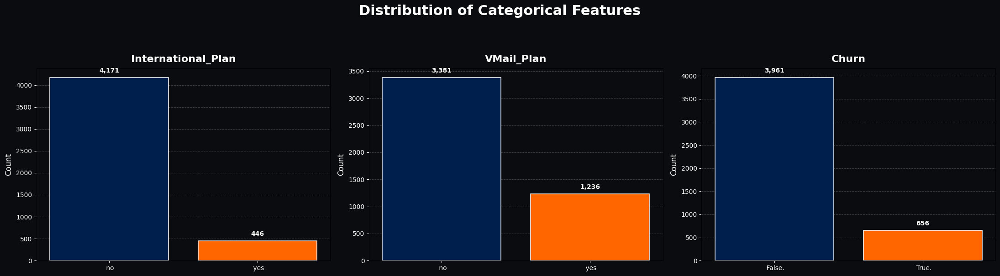

In [24]:
# ===== Categorical Feature Distribution =====
# ===== Select categorical columns =====
categorical_cols = df.select_dtypes(include='object').columns

# ===== Grid layout =====
n_cols = 3
n_rows = -(-len(categorical_cols) // n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(22, 5*n_rows))
axes = axes.flatten()

# ===== Main Title =====
fig.suptitle('Distribution of Categorical Features',
             fontsize=22, fontweight='bold', color='white', y=1.2)

# ===== Background color (dark navy) =====
bg_color = "#0B0C10"
fig.patch.set_facecolor(bg_color)

# ===== Navy & Orange colors =====
colors = ["#001f4d", "#FF6600"]

# ===== Loop through categorical columns =====
for i, col in enumerate(categorical_cols):
    ax = axes[i]
    ax.set_facecolor(bg_color)

    # ===== Grid =====
    ax.grid(axis='y', linestyle='--', alpha=0.2, zorder=1, color="white")

    # ===== Titles & labels =====
    ax.set_title(col, fontsize=16, fontweight='bold', color='white', pad=10)
    ax.set_ylabel('Count', fontsize=12, color='white', labelpad=5)

    # ===== Value counts =====
    ctab = df[col].value_counts()
    if len(ctab) > 10:
        ctab = ctab.nlargest(10).append(
            pd.Series({"Other": ctab.iloc[10:].sum()})
        )

    bar_colors = [colors[j % len(colors)] for j in range(len(ctab))]

    # ===== Plot =====
    bars = ax.bar(ctab.index, ctab.values,
                  color=bar_colors, edgecolor='white', linewidth=1.1, zorder=2)

    # ===== Annotate counts above bars =====
    for bar, val in zip(bars, ctab.values):
        ax.text(bar.get_x() + bar.get_width()/2, val + max(ctab.values)*0.02,
                f"{val:,}", ha='center', va='bottom',
                fontsize=10, fontweight='bold', color='white')

    # ===== Ticks =====
    ax.tick_params(axis='x', labelsize=10, colors='white')
    ax.tick_params(axis='y', colors='white')

for ax in axes[len(categorical_cols):]:
    fig.delaxes(ax)

# ===== Layout =====
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.show()

**1. Why did you pick the specific chart?**

- The chart shows the distribution of categorical features (International_Plan, VMail_Plan, and Churn).

- Categorical features are key in churn prediction because they represent binary decisions/services (e.g., having or not having a plan).

- Bar plots are the most suitable visualization here because they clearly show class imbalance and make it easy to compare counts between categories.

**2. What is/are the insight(s) found from the chart?**

- International Plan: Majority of customers (≈90%) don’t have it; only a small fraction do. This imbalance suggests that having this plan may be a potential churn driver.

- VMail Plan: Most customers (≈73%) don’t subscribe, but a significant share do. Its relation to churn could provide useful segmentation.

- Churn: Only ~14–15% of customers churned → the dataset is imbalanced. This means churners are rare compared to non-churners, which has implications for model training and evaluation.

**3. Will the gained insights help create a positive business impact?**

- Yes,

- Retaining customers → Target those with international plans if they churn more.

- Improving services → Better promote voicemail plans since adoption is low.

### **3.1.3. Visualize distributions of the numerical features**

### **Chart-2. Visualize the distribution of numerical features**

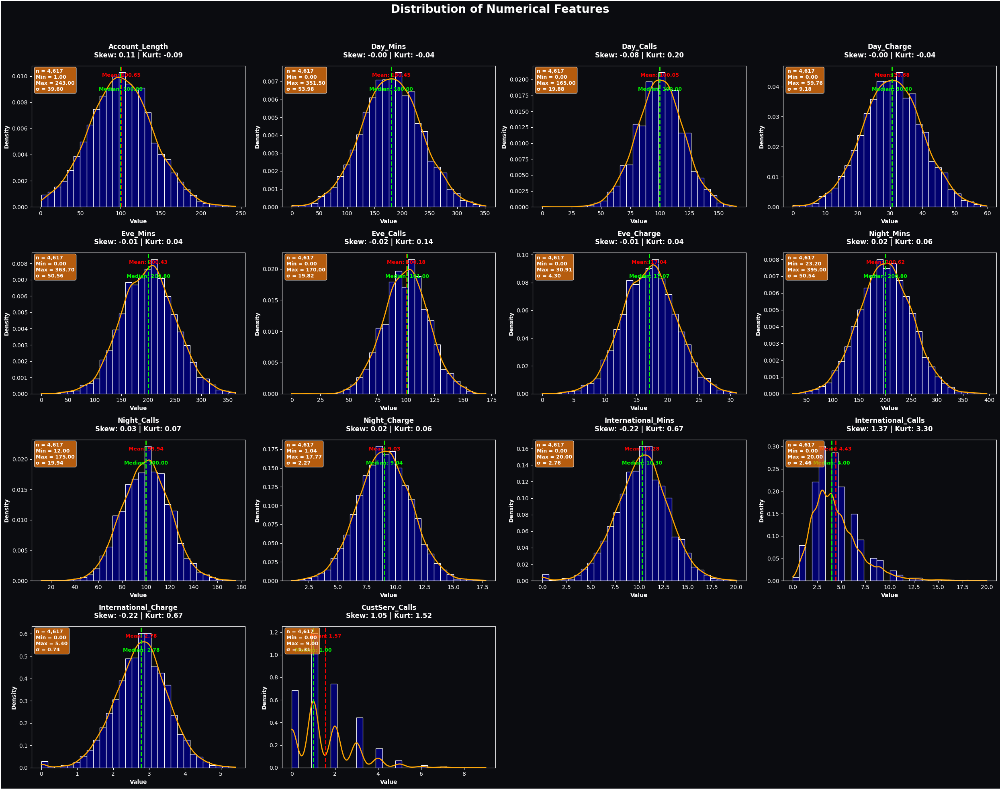

In [25]:
# ===== Distribution of Numerical Features =====
# ===== Set up dark background style =====
plt.style.use("dark_background")
sns.set_palette("flare")

# ===== Select numeric columns =====
numerics = df.select_dtypes(include='number')

# ===== Grid dimensions =====
n_cols = 4
n_rows = (len(numerics.columns) + n_cols - 1) // n_cols

# ===== Create figure =====
bg_color = "#0B0C10"
fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5*n_rows))
fig.suptitle("Distribution of Numerical Features",
             fontsize=20, fontweight="bold", y=0.98, color="white")

# ===== Background color (dark navy) =====
fig.patch.set_facecolor(bg_color)

# ===== Flatten axes =====
axes = axes.flatten()

# ===== Loop over numeric columns =====
for i, column in enumerate(numerics.columns):
    data = numerics[column].dropna()

    # ===== Histogram with KDE =====
    sns.histplot(data, kde=True, ax=axes[i],
                 stat='density', bins=30,
                 color='navy', alpha=0.85)

    if axes[i].get_lines():
        kde_line = axes[i].get_lines()[0]
        kde_line.set_color("orange")
        kde_line.set_linewidth(2)

    # ===== Stats =====
    mean_val, median_val = data.mean(), data.median()
    skewness, kurtosis = data.skew(), data.kurtosis()

    # ===== Mean & median lines =====
    axes[i].axvline(mean_val, color="red", linestyle="--", linewidth=2)
    axes[i].axvline(median_val, color="lime", linestyle="--", linewidth=2)

    # ===== Add line labels =====
    ymax = axes[i].get_ylim()[1]
    axes[i].text(mean_val, ymax*0.95, f"Mean: {mean_val:.2f}",
                 color="red", ha="center", va="top", fontsize=9, fontweight="bold")
    axes[i].text(median_val, ymax*0.85, f"Median: {median_val:.2f}",
                 color="lime", ha="center", va="top", fontsize=9, fontweight="bold")

    # ===== Titles and labels =====
    axes[i].set_title(f"{column}\nSkew: {skewness:.2f} | Kurt: {kurtosis:.2f}",
                      fontweight="bold", pad=15, color="white")
    axes[i].set_xlabel("Value", fontweight="bold", color="white")
    axes[i].set_ylabel("Density", fontweight="bold", color="white")

    # ===== Stats box =====
    textstr = (f"n = {len(data):,}\n"
               f"Min = {data.min():.2f}\n"
               f"Max = {data.max():.2f}\n"
               f"σ = {data.std():.2f}")
    props = dict(boxstyle="round", facecolor="#FF7F0E", alpha=0.7, edgecolor="white")
    axes[i].text(0.02, 0.98, textstr, transform=axes[i].transAxes,
                 fontsize=9, verticalalignment="top", bbox=props,
                 fontweight="bold", color="white")

    # ===== Match subplot background to same bg_color =====
    axes[i].set_facecolor(bg_color)

# ===== Hide extra subplots =====
for j in range(len(numerics.columns), len(axes)):
    axes[j].set_visible(False)

# ===== Layout =====
plt.tight_layout(rect=[0, 0, 1, 0.96])

# ===== Figure border =====
fig.patch.set_edgecolor("white")
fig.patch.set_linewidth(2)
plt.show()

### Insights:-

* The histograms help analyze the count or frequency of values in each feature, providing insights into the data's central tendencies and potential patterns. You can see the graphs showing the counts of all columns.

### **3.1.4. Distribution of categorical features**

### **Chart-3. Pie Chart Distribution of Categorical Features**

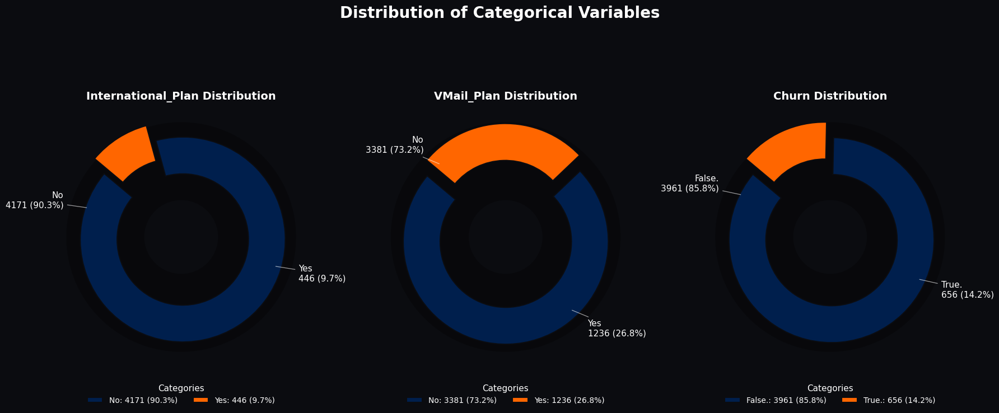

In [ ]:
# ===== Pie Chart Distribution of Categorical Features =====
# ===== Background and color scheme =====
bg_color = "#0B0C10"
colors = ["#001f4d", "#FF6600"]

# ===== Select categorical columns =====
categorical_cols = df.select_dtypes(include='object').columns
n_cols = len(categorical_cols)

# ===== horizontal layout =====
fig, axes = plt.subplots(1, n_cols, figsize=(6*n_cols, 8), constrained_layout=True)
if n_cols == 1:
    axes = [axes]

fig.patch.set_facecolor(bg_color)

for ax, col in zip(axes, categorical_cols):
    s = df[col].astype(str).str.strip().str.lower().map(
        lambda x: "Yes" if x in ["yes", "true", "1"]
        else "No" if x in ["no", "false", "0"]
        else x.capitalize()
    )

    freq = s.value_counts()
    labels = freq.index.tolist()
    sizes = freq.values.tolist()

    total = sum(sizes)
    fracs = np.array(sizes) / total
    explode = 0.02 + 0.18 * (1 - np.sqrt(fracs))

    # ===== Extend color palette =====
    palette = []
    while len(palette) < len(sizes):
        palette.extend(colors)
    palette = palette[:len(sizes)]

    # ===== Axis background =====
    ax.set_facecolor(bg_color)

    # ===== Shadow donut =====
    ax.pie([1], radius=1.12, colors=[(0,0,0,0.25)], startangle=140)

    # ===== Main donut =====
    wedges, texts = ax.pie(
        sizes,
        labels=None,
        autopct=None,
        pctdistance=0.78,
        labeldistance=1.05,
        startangle=140,
        explode=explode,
        colors=palette,
        wedgeprops=dict(width=0.36, edgecolor=bg_color, linewidth=1.5)
    )

    # ===== Donut center =====
    centre_circle = Circle((0,0),0.36,fc=bg_color)
    ax.add_artist(centre_circle)

    # ===== Custom annotations =====
    kw = dict(
        arrowprops=dict(arrowstyle="-", linewidth=0.9, color="white", alpha=0.6),
        bbox=dict(boxstyle="round,pad=0.25", fc=bg_color, ec="none", alpha=0.8),
        zorder=10, va="center"
    )

    angles = np.cumsum([0] + sizes) / total * 360
    mid_angles = (angles[:-1] + angles[1:]) / 2.0

    for wedge, label, size, angle in zip(wedges, labels, sizes, mid_angles):
        theta = np.deg2rad(angle)
        tx, ty = 1.2 * np.cos(theta), 1.2 * np.sin(theta)
        percent = size / total * 100
        text = f"{label}\n{size} ({percent:.1f}%)"
        ha = "left" if tx >= 0 else "right"
        ax.annotate(
            text,
            xy=(0.95*np.cos(theta), 0.95*np.sin(theta)),
            xytext=(tx, ty),
            horizontalalignment=ha,
            color="white",
            fontsize=11,
            **kw
        )

    # ===== Title & legend =====
    ax.set_title(f"{col} Distribution", color="white", fontsize=14, pad=12, fontweight="bold")
    legend_labels = [f"{lab}: {cnt} ({cnt/total:.1%})" for lab, cnt in zip(labels, sizes)]
    ax.legend(wedges, legend_labels, title="Categories", loc="lower center",
              bbox_to_anchor=(0.5, -0.18), ncol=min(3, len(labels)),
              frameon=False, fontsize=10, title_fontsize=11, labelcolor="white")

    ax.set(aspect="equal")

plt.suptitle('Distribution of Categorical Variables', fontsize=20, weight='bold', y=0.98)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

### **Observation:**

- International_Plan → Vast majority (90.3%) of customers do not have an international plan; only 9.7% opted for it.

- VMail_Plan → Most customers (73.2%) don’t use voicemail, while 26.8% have subscribed to it.

- Churn → 14.2% of customers churned, indicating a notable portion of users are leaving despite most staying (85.8%).

## **3.2. Bivariate Analysis: Examining Relationships Between Variable Pairs**

### **3.2.1. All plot of feature vs Target Variable**

### **Chart-4. All plot of feature vs Target Variable**


Shape of your Data Set loaded: (4617, 17)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  8
    Number of Integer-Categorical Columns =  6
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  2
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    16 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Binary_Classification problem #####################
To fix these data quali

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Account_Length,int64,0.000000,4,1.000000,243.000000,Column has 23 outliers greater than upper bound (206.50) or lower than lower bound(-5.50). Cap them or remove them.
International_Plan,object,0.000000,0,,,No issue
VMail_Plan,object,0.000000,0,,,No issue
Day_Mins,float64,0.000000,NA,0.000000,351.500000,Column has 27 outliers greater than upper bound (326.45) or lower than lower bound(34.05). Cap them or remove them.
Day_Calls,int64,0.000000,2,0.000000,165.000000,Column has 34 outliers greater than upper bound (152.00) or lower than lower bound(48.00). Cap them or remove them.
Day_Charge,float64,0.000000,NA,0.000000,59.760000,"Column has 27 outliers greater than upper bound (55.50) or lower than lower bound(5.79). Cap them or remove them., Column has a high correlation with ['Day_Mins']. Consider dropping one of them."
Eve_Mins,float64,0.000000,NA,0.000000,363.700000,Column has 36 outliers greater than upper bound (336.15) or lower than lower bound(63.75). Cap them or remove them.
Eve_Calls,int64,0.000000,2,0.000000,170.000000,Column has 25 outliers greater than upper bound (154.50) or lower than lower bound(46.50). Cap them or remove them.
Eve_Charge,float64,0.000000,NA,0.000000,30.910000,"Column has 36 outliers greater than upper bound (28.58) or lower than lower bound(5.41). Cap them or remove them., Column has a high correlation with ['Eve_Mins']. Consider dropping one of them."
Night_Mins,float64,0.000000,NA,23.200000,395.000000,Column has 36 outliers greater than upper bound (336.60) or lower than lower bound(65.40). Cap them or remove them.


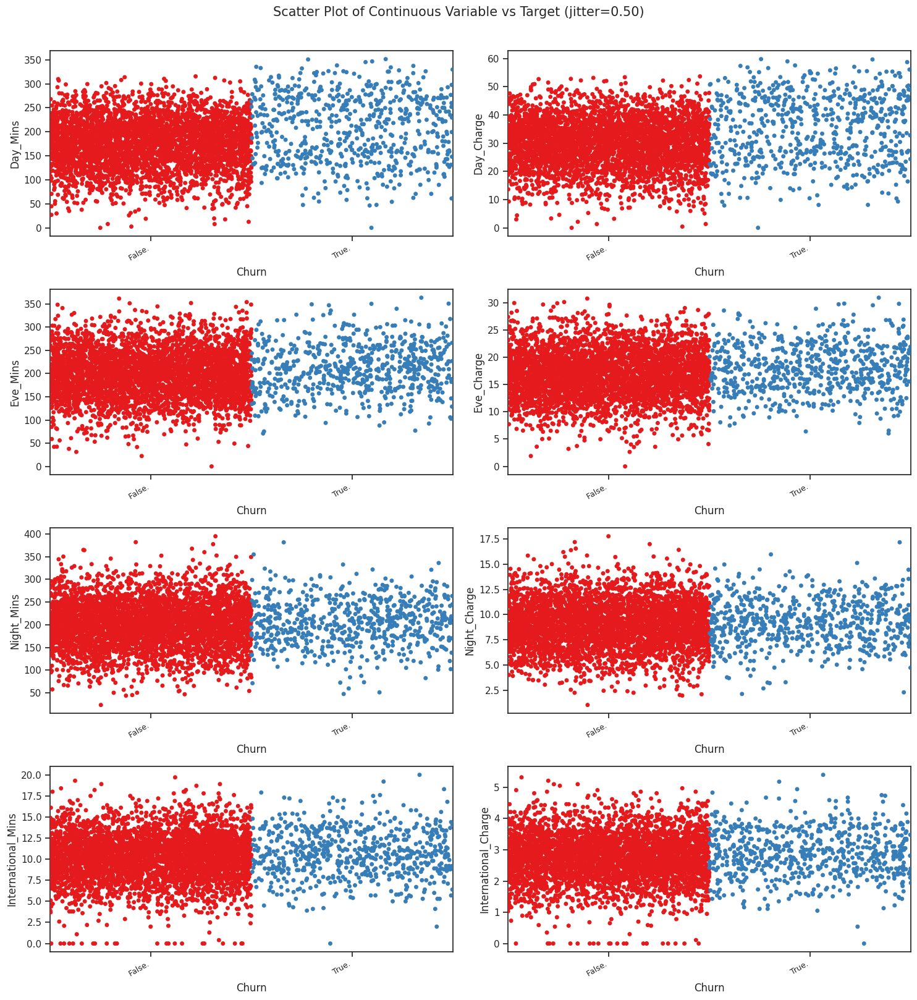

Total Number of Scatter Plots = 36


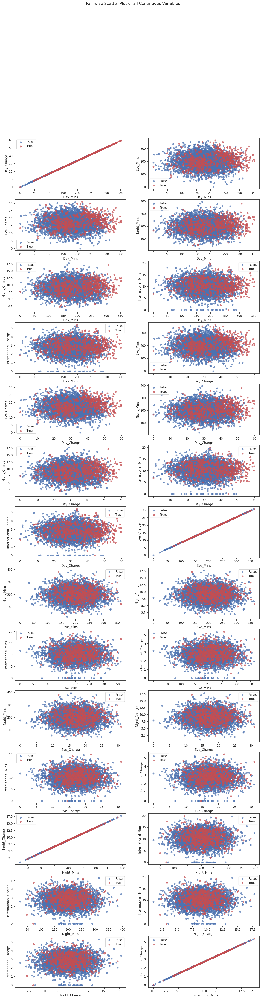

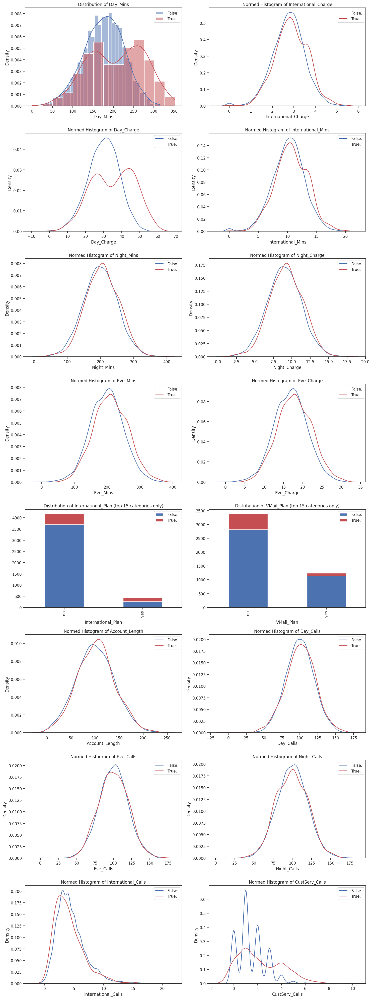

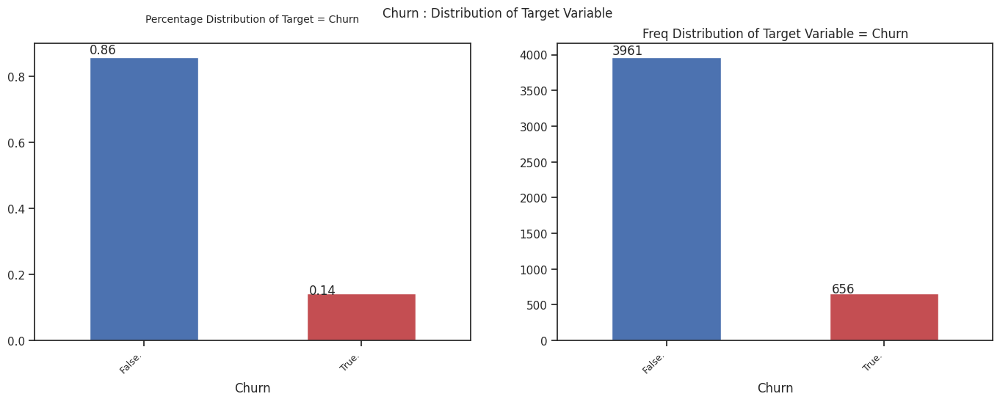

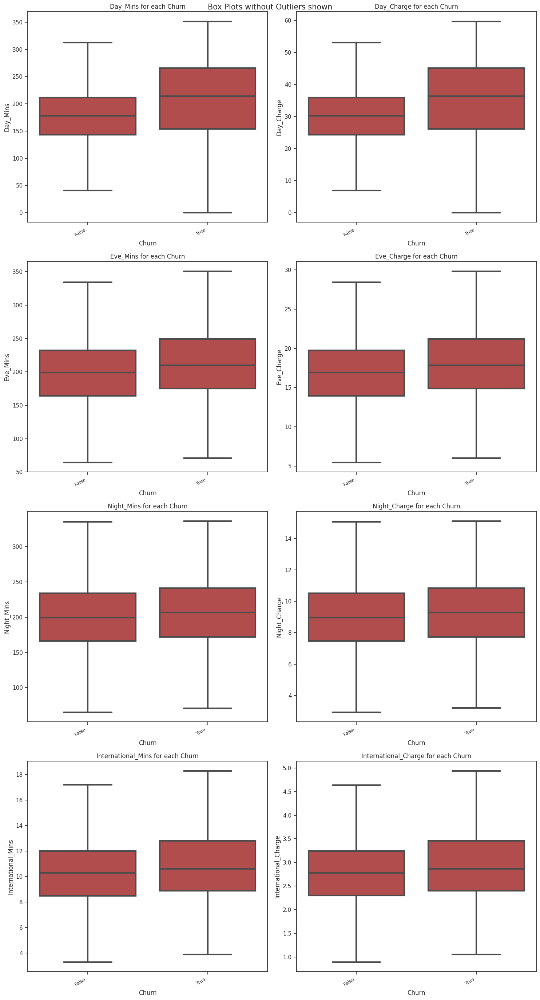

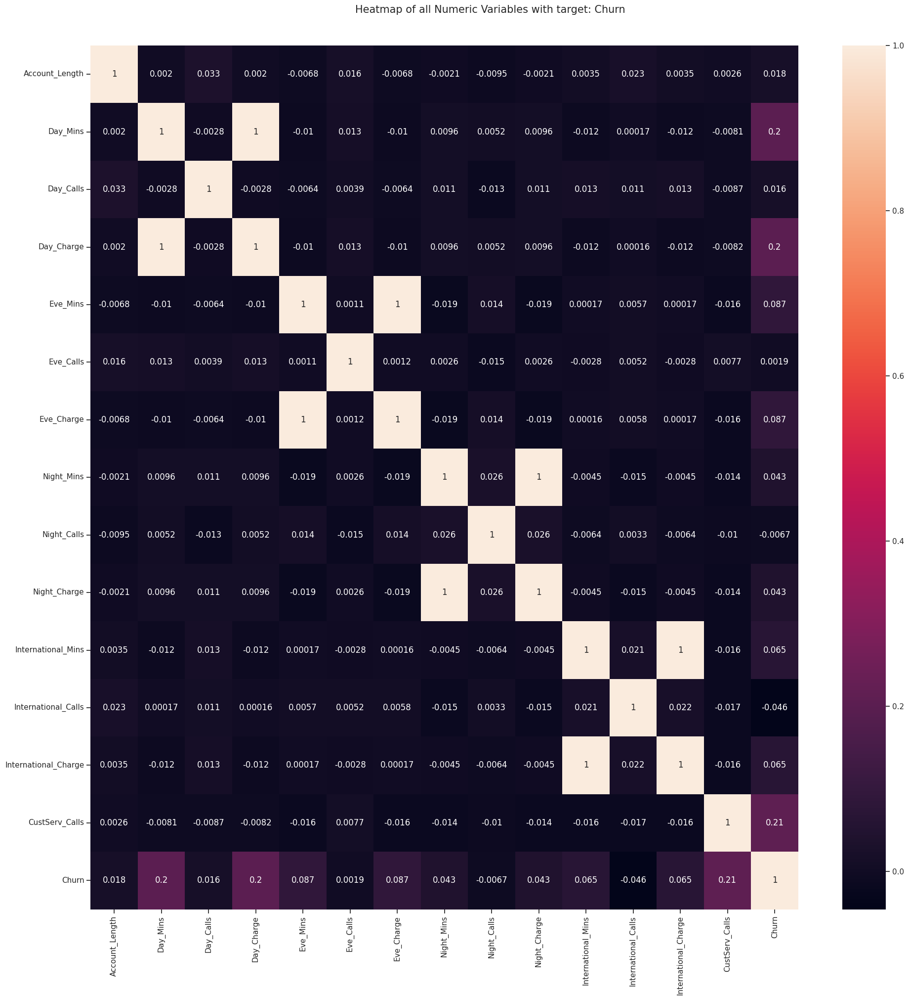

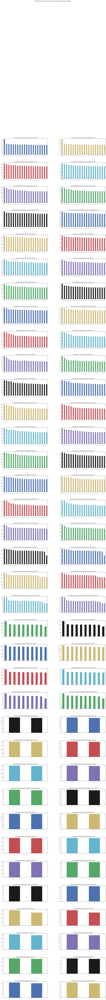

All Plots done
Time to run AutoViz = 35 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [ ]:
# ===== Import =====
from autoviz.AutoViz_Class import AutoViz_Class
%matplotlib inline

# ===== AutoViz code =====
AV = AutoViz_Class()
report = AV.AutoViz(
    filename='',
    dfte=df,
    max_cols_analyzed=30,
    depVar='Churn',
    verbose=1
)

## **3.3. Multivariate Analysis: Examines multiple variables simultaneously**

### **3.3.1. Pairplot**

### **Chart-5. Pairplot**

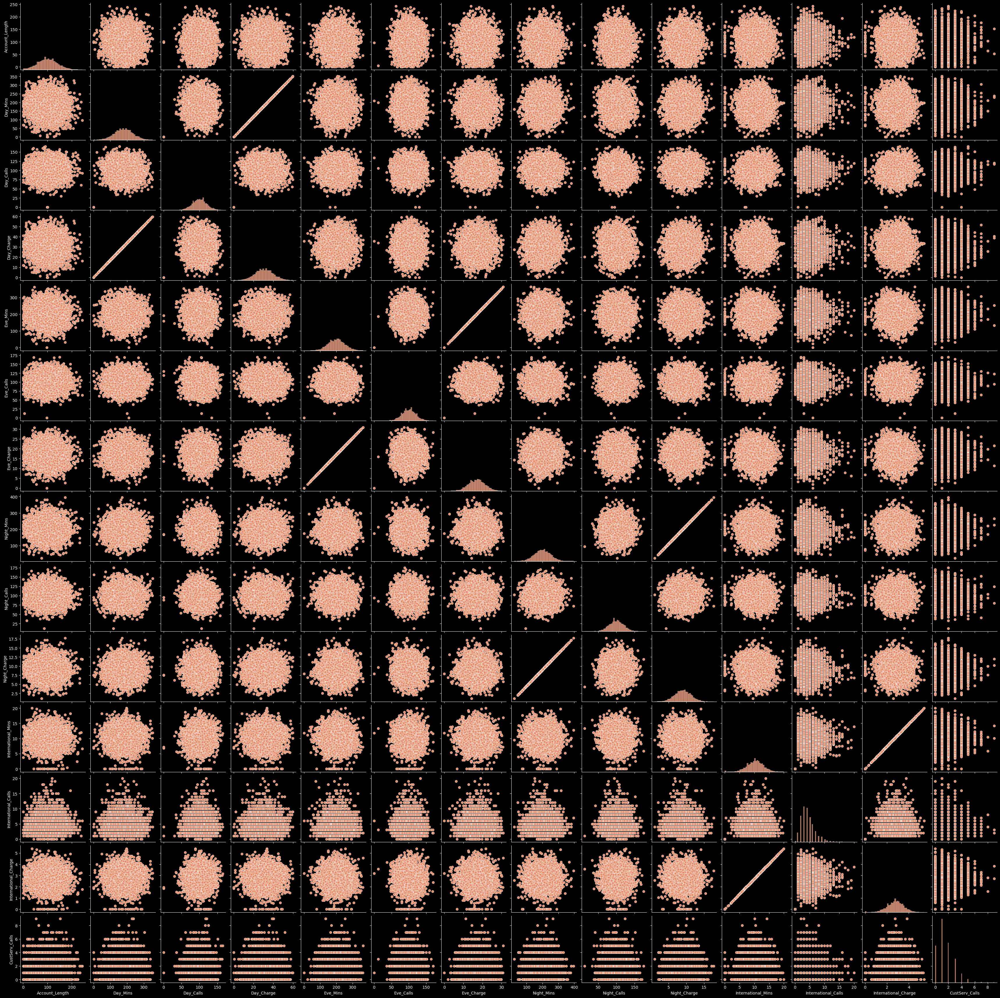

In [26]:
# ===== Pair Plot visualization code =====
numeric_df = df.select_dtypes(include=['number'])

sns.pairplot(numeric_df)

**1. Why did you pick the specific chart?**

* Pair plot is used to understand the best set of features to explain a relationship between two variables or to form the most separated clusters.

## **3.4. Hypothesis Testing**

### Based on the chart experiments, define three hypothetical statements about the dataset. In the next three answers, perform hypothesis testing to obtain a final conclusion about the statements through your code and statistical testing.

### **3.4.1. Hypothetical Statement - 1**

### **1. State Your research hypothesis as a null hypothesis and alternate hypothesis.**

**Hypotheses:**

* Null Hypothesis (H0): There is no association between having an international plan and customer churn..

* Alternative Hypothesis (H1): There is a significant association between having an international plan and customer churn.

### **2. Perform an appropriate statistical test**

In [ ]:
# ===== Create contingency table =====
contingency_table = pd.crosstab(df['International_Plan'], df['Churn'])
print("Contingency Table:\n", contingency_table)

chi2, p, dof, expected = chi2_contingency(contingency_table)

print("\nChi-square Statistic:", chi2)
print("P-value:", p)
print("Degrees of Freedom:", dof)
print("Expected Frequencies:\n", expected)

# ===== Interpretation =====
if p < 0.05:
    print("\nResult: Reject H0 → International Plan affects customer churn.")
else:
    print("\nResult: Fail to reject H0 → No significant effect of International Plan on churn.")

Contingency Table:
 Churn               False.  True.
International_Plan               
no                   3701    470 
yes                   260    186 

Chi-square Statistic: 303.70061781373795
P-value: 5.1469217589105615e-68
Degrees of Freedom: 1
Expected Frequencies:
 [[3578.36928742  592.63071258]
 [ 382.63071258   63.36928742]]

Result: Reject H0 → International Plan affects customer churn.


**Why Chi-square test?**

* Both International Plan (Yes/No) and Churn (True/False) are categorical variables.

* Chi-square test checks if there is a statistical association between these two categorical variables.

### **3. Business Insight:**

* Customers with or without an International Plan show different churn behaviors, indicating plan offerings influence retention.

* Targeted retention strategies (e.g., better international packages or discounts) can help reduce churn among high-risk groups.

### **3.4.2. Hypothetical Statement - 2**

### **1. State Your research hypothesis as a null hypothesis and alternate hypothesis.**

**Hypotheses:**

* Null Hypothesis (H0): There is no association between having a voicemail plan and customer churn.

* Alternative Hypothesis (H1): There is a significant association between having a voicemail plan and customer churn.

### **2. Perform an appropriate statistical test**

In [ ]:
# ===== Create contingency table =====
contingency_table = pd.crosstab(df['VMail_Plan'], df['Churn'])
print("Contingency Table:\n", contingency_table)

chi2, p, dof, expected = chi2_contingency(contingency_table)

print("\nChi-square Statistic:", chi2)
print("P-value:", p)
print("Degrees of Freedom:", dof)
print("Expected Frequencies:\n", expected)

# ===== Interpretation =====
if p < 0.05:
    print("\nResult: Reject H0 → Voicemail Plan affects customer churn.")
else:
    print("\nResult: Fail to reject H0 → No significant effect of Voicemail Plan on churn.")

Contingency Table:
 Churn       False.  True.
VMail_Plan               
no           2822    559 
yes          1139     97 

Chi-square Statistic: 55.30697372040214
P-value: 1.0310215433169948e-13
Degrees of Freedom: 1
Expected Frequencies:
 [[2900.61533463  480.38466537]
 [1060.38466537  175.61533463]]

Result: Reject H0 → Voicemail Plan affects customer churn.


**Why Chi-square Test?**

* Both Voice Mail Plan (Yes/No) and Churn (True/False) are categorical variables.

* Chi-square test checks whether there is a statistical association between having a voicemail plan and customer churn.

### **3. Business Insight:**

* Customers with and without a Voicemail Plan show different churn patterns, suggesting that value-added services influence retention.

* Offering personalized voicemail or bundled communication services could improve customer stickiness and reduce churn.

### **3.4.3. Hypothetical Statement - 3**

### **1. State Your research hypothesis as a null hypothesis and alternate hypothesis.**

**Hypotheses:**

* Null Hypothesis (H0): There is no association between customer service call frequency and churn.

* Alternative Hypothesis (H1): There is a significant association between customer service call frequency and churn.

### **2. Perform an appropriate statistical test**

In [ ]:
# ===== Categorize Customer Service Calls =====
df_hy = df.copy()
bins = [0, 1, 3, 5, 100]
labels = ['0-1', '2-3', '4-5', '6+']
df_hy['CallCategory'] = pd.cut(df_hy['CustServ_Calls'], bins=bins, labels=labels, right=True)

# ===== Create contingency table =====
contingency_table = pd.crosstab(df_hy['CallCategory'], df_hy['Churn'])
print("Contingency Table:\n", contingency_table)

chi2, p, dof, expected = chi2_contingency(contingency_table)

print("\nChi-square Statistic:", chi2)
print("P-value:", p)
print("Degrees of Freedom:", dof)
print("Expected Frequencies:\n", expected)

# ===== Interpretation =====
if p < 0.05:
    print("\nResult: Reject H0 → Customer service call frequency is associated with churn.")
else:
    print("\nResult: Fail to reject H0 → Customer service call frequency is not associated with churn.")

Contingency Table:
 Churn         False.  True.
CallCategory               
0-1            1475    176 
2-3            1470    177 
4-5             164    159 
6+               17     28 

Chi-square Statistic: 429.40002090675375
P-value: 9.46998250027235e-93
Degrees of Freedom: 3
Expected Frequencies:
 [[1407.80851064  243.19148936]
 [1404.39770867  242.60229133]
 [ 275.42225859   47.57774141]
 [  38.37152209    6.62847791]]

Result: Reject H0 → Customer service call frequency is associated with churn.


**Why Chi-square Test?**

* Both customer service call frequency (categorized) and churn are categorical variables.

* Chi-square test checks if there is a statistical association between call frequency and customer churn.

### **3. Business Insight:**

* Customers who make more service calls may be more likely to churn → improve support quality for high-call customers.

* For example, if customers calling 4+ times are churning more, proactively address their issues to reduce churn.

# **4. Data Pre-Processing**

## **4.1. Handling Missing Values / Null Values**

In [27]:
# ===== Finding a missing values =====
df.isnull().sum().to_frame("Missing_Values")

,Missing_Values
Account_Length,0
International_Plan,0
VMail_Plan,0
Day_Mins,0
Day_Calls,0
Day_Charge,0
Eve_Mins,0
Eve_Calls,0
Eve_Charge,0
Night_Mins,0


The dataset has been checked for missing values, and no null or missing entries were found, indicating that the data is complete and clean for analysis.

## **4.2. Handling Outliers: Detection and Treatment Strategies**

### **4.2.1. Perform outlier detection:**

### **Chart-6. Plotting box plots for all numerical variable**

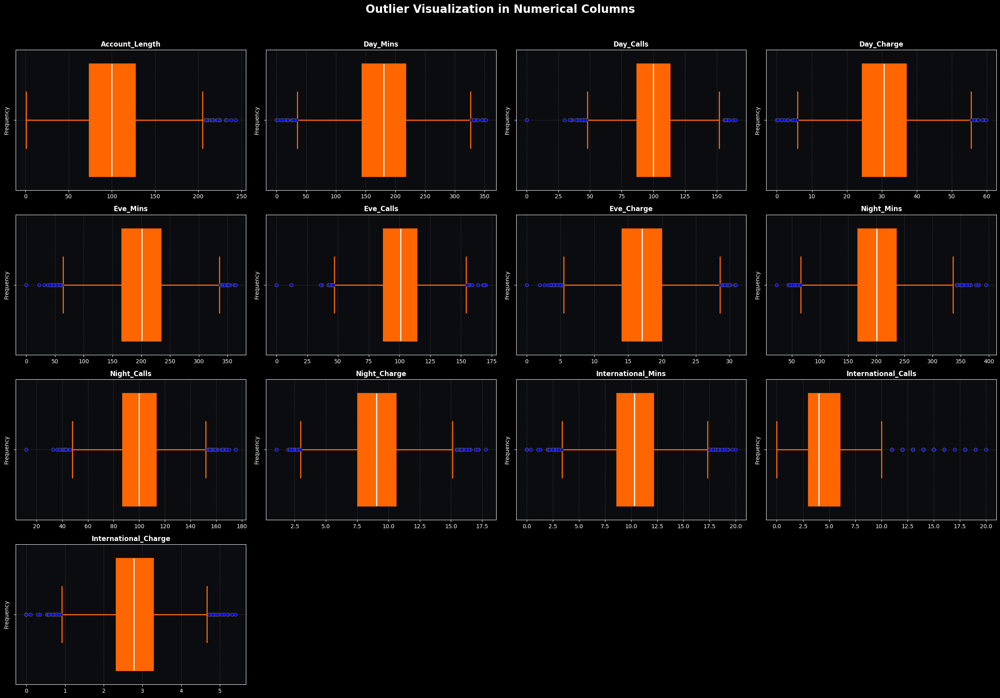

In [28]:
# ===== Plotting box plots for all numerical variable =====
numeric_df = df.select_dtypes(include=['number'])

bg_color = "#0B0C10"
box_color = "#FF6600"      # Orange box
outlier_color = "blue"     # Navy for outliers
grid_color = "#444444"     # Subtle gray grid lines

plt.figure(figsize=(25, 17))
plt.rcParams['axes.facecolor'] = bg_color
plt.rcParams['figure.facecolor'] = bg_color
plt.rcParams['savefig.facecolor'] = bg_color
plt.rcParams['axes.labelcolor'] = 'white'
plt.rcParams['xtick.color'] = 'white'
plt.rcParams['ytick.color'] = 'white'

num_plots = min(len(numeric_df.columns), 13)

for i, col in enumerate(numeric_df.columns[:num_plots]):
    plt.subplot(4, 4, i + 1)

    sns.boxplot(
        data=df,
        x=col,
        color=box_color,
        boxprops=dict(facecolor=box_color, color=box_color, linewidth=2),
        flierprops=dict(marker='o', markerfacecolor=outlier_color, markersize=6, linestyle='none'),
        medianprops=dict(color='white', linewidth=2),
        whiskerprops=dict(color=box_color, linewidth=2),
        capprops=dict(color=box_color, linewidth=2)
    )

    plt.title(col, fontsize=12, fontweight='bold', color='white')
    plt.xlabel('')
    plt.ylabel('Frequency')

    plt.grid(True, color=grid_color, linestyle='--', linewidth=0.7, alpha=0.7)

plt.suptitle("Outlier Visualization in Numerical Columns", fontsize=20, fontweight='bold', color='white', y=1.02)
plt.tight_layout()
plt.show()

### **4.2.2. Calculate the number of outliers and their percentage:**

In [29]:
# ===== Defining the function for outlier detection and percentage calculation using IQR =====

def detect_outliers(data):
    data = np.array(data)

    # ===== Quartiles =====
    q1 = np.percentile(data, 25)
    q2 = np.percentile(data, 50)
    q3 = np.percentile(data, 75)

    # ===== IQR & boundsa =====
    IQR = q3 - q1
    lower_bound = q1 - 1.5 * IQR
    upper_bound = q3 + 1.5 * IQR

    # ===== Outlier detection =====
    outliers = data[(data < lower_bound) | (data > upper_bound)]
    outlier_count = len(outliers)
    outlier_percent = round(outlier_count * 100 / len(data), 2)

    # ===== Display results =====
    print(f"Q1 = {q1}, Q2 (Median) = {q2:.2f}, Q3 = {q3}")
    print(f"IQR = {IQR:.2f}")
    print(f"Lower Bound = {lower_bound:.2f}, Upper Bound = {upper_bound:.2f}")
    print(f"Outliers Detected: {outlier_count}")
    print(f"Outlier Percentage: {outlier_percent}%\n")

In [30]:
# ===== Calculating IQR, Lower/Upper Bounds, and Outlier Counts for Continuous Numerical Features =====

for feature in numeric_df:
  print(feature,":")
  detect_outliers(df[feature])
  print("*"*50)

Account_Length :
Q1 = 74.0, Q2 (Median) = 100.00, Q3 = 127.0
IQR = 53.00
Lower Bound = -5.50, Upper Bound = 206.50
Outliers Detected: 23
Outlier Percentage: 0.5%

**************************************************
Day_Mins :
Q1 = 143.7, Q2 (Median) = 180.00, Q3 = 216.8
IQR = 73.10
Lower Bound = 34.05, Upper Bound = 326.45
Outliers Detected: 27
Outlier Percentage: 0.58%

**************************************************
Day_Calls :
Q1 = 87.0, Q2 (Median) = 100.00, Q3 = 113.0
IQR = 26.00
Lower Bound = 48.00, Upper Bound = 152.00
Outliers Detected: 34
Outlier Percentage: 0.74%

**************************************************
Day_Charge :
Q1 = 24.43, Q2 (Median) = 30.60, Q3 = 36.86
IQR = 12.43
Lower Bound = 5.79, Upper Bound = 55.50
Outliers Detected: 27
Outlier Percentage: 0.58%

**************************************************
Eve_Mins :
Q1 = 165.9, Q2 (Median) = 200.80, Q3 = 234.0
IQR = 68.10
Lower Bound = 63.75, Upper Bound = 336.15
Outliers Detected: 36
Outlier Percentage: 0.78%

| Feature Name          | Description                      | Outlier % | Action            | Reason                                                                       |
| --------------------- | -------------------------------- | --------- | ----------------- | ---------------------------------------------------------------------------- |
| Account\_Length       | Customer account duration (days) | 0.50%     | Keep       | Very few outliers, negligible impact on analysis.                            |
| Day\_Mins             | Total daytime call minutes       | 0.58%     | Keep | Outliers are rare; winsorizing could reduce skew slightly.                   |
| Day\_Calls            | Number of daytime calls          | 0.74%     | Keep        | Low percentage of outliers, no strong effect expected.                       |
| Day\_Charge           | Charge for daytime calls         | 0.58%     | Keep | Rare outliers, similar to Day\_Mins.                                         |
| Eve\_Mins             | Total evening call minutes       | 0.78%     | Keep | Low impact, but can consider capping extreme values.                         |
| Eve\_Calls            | Number of evening calls          | 0.54%     | Keep        | Minimal outliers, likely not influential.                                    |
| Eve\_Charge           | Charge for evening calls         | 0.78%     | Keep | Few outliers, consider capping if needed for modeling.                       |
| Night\_Mins           | Total night call minutes         | 0.78%     | Keep | Low percentage of outliers, optional capping.                                |
| Night\_Calls          | Number of night calls            | 0.91%     | Keep         | Outlier % is low; can remain for analysis.                                   |
| Night\_Charge         | Charge for night calls           | 0.78%     | Keep | Few extreme values; optional winsorization for modeling.                     |
| International\_Mins   | Total international call minutes | 1.41%     | Rectify         | Slightly higher outlier %, capping helps reduce skew.                        |
| International\_Calls  | Number of international calls    | 2.32%     | Rectify | Highest % outliers, could affect model performance.                          |
| International\_Charge | Charge for international calls   | 1.41%     | Rectify         | Outliers slightly higher; capping recommended to reduce impact.              |
| CustServ\_Calls       | Customer service calls           | 7.97%     | Rectify  | High outlier %, skewed distribution; capping or binning improves robustness. |


### **4.2.3. Outlier removal operation:**

In [31]:
# ===== Defining the function for outlier removal code =====

def remove_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    filtered_df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    print(f"Removed {df.shape[0] - filtered_df.shape[0]} outliers from '{column}'")
    return filtered_df

In [32]:
# ===== Run code =====
# ===== copy for camparison purposs =====
df_clean = df.copy()

df_clean = remove_outliers_iqr(df_clean, 'International_Mins')
df_clean = remove_outliers_iqr(df_clean, 'International_Calls')
df_clean = remove_outliers_iqr(df_clean, 'International_Charge')
df_clean = remove_outliers_iqr(df_clean, 'CustServ_Calls')

Removed 65 outliers from 'International_Mins'
Removed 107 outliers from 'International_Calls'
Removed 7 outliers from 'International_Charge'
Removed 358 outliers from 'CustServ_Calls'


### **4.2.4. After the outliers were removed:**

### **Chart-7. Boxplot Comparison (Before and After)**

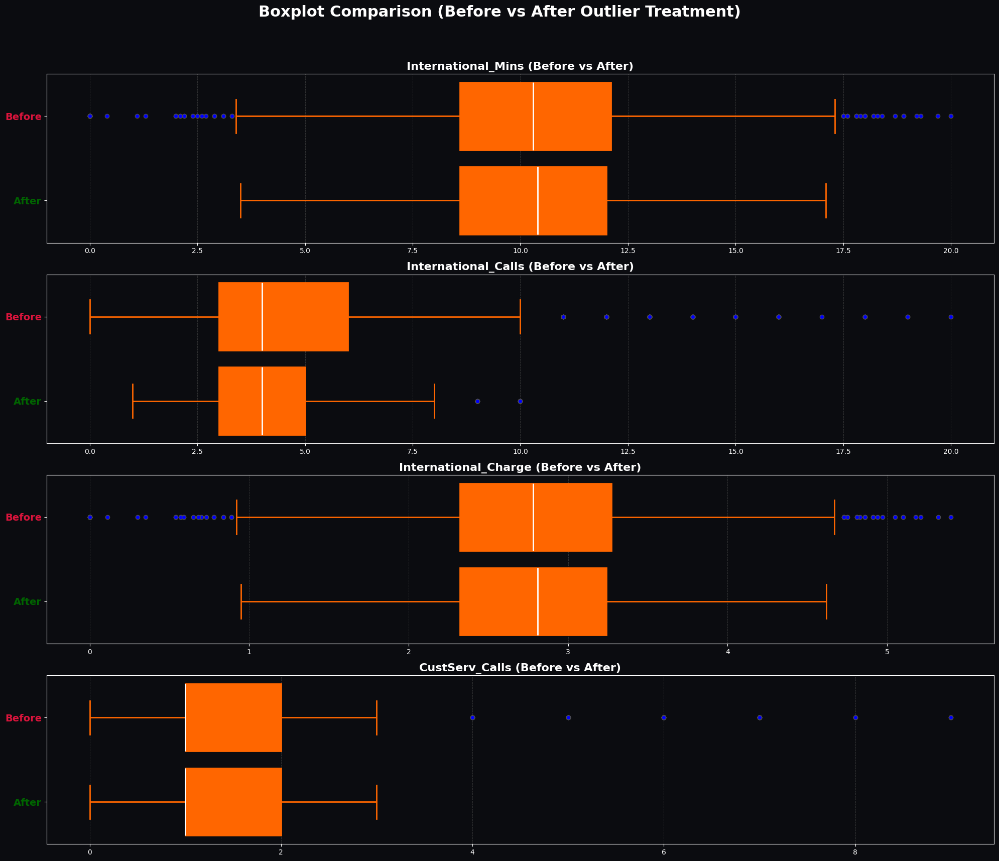

In [33]:
# ===== Boxplot comparison code =====

bg_color = "#0B0C10"
box_color = "#FF6600"
outlier_color = "blue"
grid_color = "#444444"

columns_to_plot = ['International_Mins', 'International_Calls', 'International_Charge', 'CustServ_Calls']
titles = ['International_Mins', 'International_Calls', 'International_Charge', 'CustServ_Calls']

box_style = dict(
    boxprops=dict(color=box_color, facecolor=box_color, linewidth=2),
    flierprops=dict(marker='o', markerfacecolor=outlier_color, markersize=6, linestyle='none'),
    medianprops=dict(color='white', linewidth=2),
    whiskerprops=dict(color=box_color, linewidth=2),
    capprops=dict(color=box_color, linewidth=2)
)

fig, axes = plt.subplots(len(columns_to_plot), 1, figsize=(20, 18))
fig.patch.set_facecolor(bg_color)

for i, col in enumerate(columns_to_plot):
    combined_data = pd.concat([df[col], df_clean[col]])
    group_labels = ['Before'] * len(df[col]) + ['After'] * len(df_clean[col])

    sns.boxplot(
        y=group_labels,
        x=combined_data,
        ax=axes[i],
        color=box_color,
        **box_style
    )

    axes[i].set_title(f'{titles[i]} (Before vs After)', fontsize=16, fontweight='bold', color='white')
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    axes[i].grid(True, axis='x', linestyle='--', linewidth=0.7, alpha=0.7, color=grid_color)

    axes[i].set_yticklabels(['Before', 'After'], fontsize=14, weight='bold')
    for tick in axes[i].get_yticklabels():
        if tick.get_text() == 'Before':
            tick.set_color('crimson')
        elif tick.get_text() == 'After':
            tick.set_color('darkgreen')

plt.suptitle('Boxplot Comparison (Before vs After Outlier Treatment)', fontsize=22, fontweight='bold', color='white')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

In [34]:
# ===== After comparing box plots, I made the following changes =====
df = df_clean.copy()

# **5. Feature Engineering**

## **5.1. Check if my target feature is imbalanced or not**

In [35]:
# ===== Check if my target feature is imbalanced =====
df['Churn'].value_counts(normalize=True) * 100

,proportion
Churn,
False.,89.093137
True.,10.906863


### **Chart-8. Target Variable Distribution (Churn)**

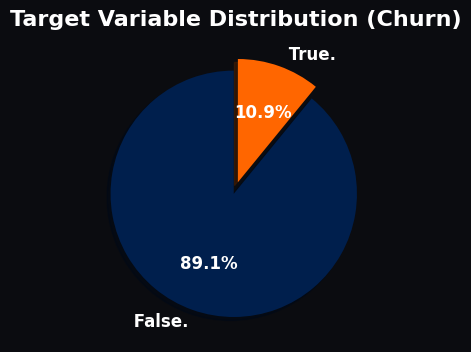

In [ ]:
# ===== Visualization code =====
counts = df['Churn'].value_counts()
labels = counts.index
bg_color = "#0B0C10"
colors = ["#001f4d", "#FF6600"]

fig, ax = plt.subplots(figsize=(6, 4))
fig.patch.set_facecolor(bg_color)

wedges, texts, autotexts = ax.pie(
    counts,
    labels=labels,
    autopct='%1.1f%%',
    startangle=90,
    colors=colors,
    explode=(0.05, 0.05),
    shadow=True,
    textprops={'color':'white', 'fontsize':12, 'weight':'bold'}
)

ax.set_title("Target Variable Distribution (Churn)", fontsize=16, fontweight='bold', color='white')
plt.show()

**From the pie chart:**

* "False" accounts for 89.1% of the data.

* "True" accounts for only 10.9% of the data.

The target variable distribution is highly imbalanced, with 89.1% labeled as "False" and only 10.9% labeled as "True". This imbalance shows that the dataset is dominated by the majority class, making it harder for models to detect churn cases. If trained directly, a model may achieve high accuracy by mostly predicting "False", but it will miss the critical "True" cases. Such imbalance reduces the model’s reliability for decision-making, especially since the minority churn group carries significant business value.

**Resampling Techniques:**

* Oversampling the minority class (SMOTE).

* Undersampling the majority class to balance proportions.

## **5.2. Feature Selection**

### **5.2.1. Encoding Categorical Variables**

In [ ]:
# ===== Categorical Features =====
# ===== Run code =====
categorical_cols = df.select_dtypes(include='object')
for col in categorical_cols:
    print(f"Column: '{col}'")
    print(f" * Unique Categories: {df[col].nunique()}")
    print(f" * Category Distribution:\n{df[col].value_counts(dropna=False)}")
    print("-" * 35)

Column: 'International_Plan'
 * Unique Categories: 2
 * Category Distribution:
International_Plan
no     3693
yes     387
Name: count, dtype: int64
-----------------------------------
Column: 'VMail_Plan'
 * Unique Categories: 2
 * Category Distribution:
VMail_Plan
no     2985
yes    1095
Name: count, dtype: int64
-----------------------------------
Column: 'Churn'
 * Unique Categories: 2
 * Category Distribution:
Churn
False.    3635
True.      445
Name: count, dtype: int64
-----------------------------------


| **Feature Name**    | **Type**    | **Example Values** | **Recommended Encoding** | **Reason**                                                          |
| ------------------- | ----------- | ------------------ | ------------------------ | ------------------------------------------------------------------- |
| International\_Plan | Categorical | no, yes            | Label Encoding   | Only 2 categories; can convert to 0/1 for modeling simplicity.      |
| VMail\_Plan         | Categorical | no, yes            | Label Encoding   | Binary feature; 0/1 representation works well for ML models.        |
| Churn               | Categorical | False., True       | Label Encoding  | Target variable; 0/1 encoding needed for classification algorithms. |


In [36]:
# ===== Encode the categorical features =====
df_encoded = df.copy()

# ===== Label Encoding (Binary Features) =====
df_encoded['International_Plan'] = df_encoded['International_Plan'].str.strip().str.lower()
df_encoded['VMail_Plan'] = df_encoded['VMail_Plan'].str.strip().str.lower()
df_encoded['Churn'] = df_encoded['Churn'].str.strip()

df_encoded['International_Plan'] = df_encoded['International_Plan'].map({'no': 0, 'yes': 1})
df_encoded['VMail_Plan'] = df_encoded['VMail_Plan'].map({'no': 0, 'yes': 1})
df_encoded['Churn'] = df_encoded['Churn'].map({'False.': 0, 'True.': 1})

In [37]:
# ===== Final Output =====
print("Shape of encoded dataset:", df_encoded.shape)

Shape of encoded dataset: (4080, 17)


In [38]:
# ===== RunCode =====
df_encoded.head(7).T

,0,1,2,3,4,5,6
Account_Length,128.00,107.00,137.00,84.00,75.00,118.00,121.00
International_Plan,0.00,0.00,0.00,1.00,1.00,1.00,0.00
VMail_Plan,1.00,1.00,0.00,0.00,0.00,0.00,1.00
Day_Mins,265.10,161.60,243.40,299.40,166.70,223.40,218.20
Day_Calls,110.00,123.00,114.00,71.00,113.00,98.00,88.00
Day_Charge,45.07,27.47,41.38,50.90,28.34,37.98,37.09
Eve_Mins,197.40,195.50,121.20,61.90,148.30,220.60,348.50
Eve_Calls,99.00,103.00,110.00,88.00,122.00,101.00,108.00
Eve_Charge,16.78,16.62,10.30,5.26,12.61,18.75,29.62
Night_Mins,244.70,254.40,162.60,196.90,186.90,203.90,212.60


In [ ]:
# ===== Checking =====
df_encoded.tail(7).T

,4610,4611,4612,4613,4614,4615,4616
Account_Length,138.00,90.00,57.00,177.00,67.00,98.00,140.00
International_Plan,0.00,0.00,0.00,0.00,0.00,0.00,0.00
VMail_Plan,0.00,0.00,1.00,1.00,1.00,1.00,0.00
Day_Mins,63.70,193.80,144.00,189.00,127.50,168.90,204.70
Day_Calls,114.00,90.00,81.00,91.00,126.00,98.00,100.00
Day_Charge,10.83,32.95,24.48,32.13,21.68,28.71,34.80
Eve_Mins,212.20,206.60,187.20,303.10,296.10,226.30,126.80
Eve_Calls,132.00,98.00,112.00,96.00,129.00,117.00,107.00
Eve_Charge,18.04,17.56,15.91,25.76,25.17,19.24,10.78
Night_Mins,247.60,153.30,158.60,163.60,200.90,165.50,202.80


### **5.2.2. Correlation Heatmap of Features**

### **Chart-9. Correlation Heatmap of Features**

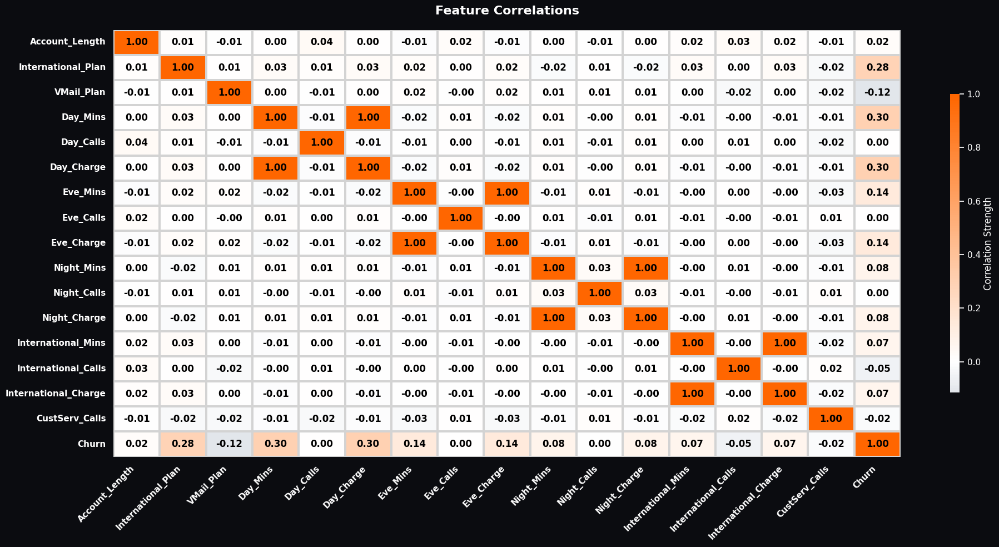

In [ ]:
# ===== Select your features wisely to avoid overfitting =====
# ===== Correlation Heatmap visualization code =====
corr = df_encoded.corr()

bg_color = "#0B0C10"
custom_cmap = sns.color_palette("blend:#001f4d,white,#FF6600", as_cmap=True)

fig, ax = plt.subplots(figsize=(20, 10))
fig.patch.set_facecolor(bg_color)
ax.set_facecolor(bg_color)

sns.heatmap(
    corr,
    annot=True,
    fmt=".2f",
    cmap=custom_cmap,
    center=0,
    linewidths=1.5,
    linecolor="lightgrey",
    annot_kws={"size":12, "weight":"bold", "color":"black"},
    cbar_kws={"shrink":0.7, "aspect":30, "label":"Correlation Strength"},
    ax=ax
)
ax.set_title("Feature Correlations",
             fontsize=16, fontweight="bold", color="white", pad=20)
ax.tick_params(colors="white", labelsize=11, width=0, which="both")
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", weight="bold")
plt.setp(ax.get_yticklabels(), rotation=0, weight="bold")

plt.grid(False)
plt.tight_layout()
plt.show()

In [39]:
# ===== Drop Features =====
df_encoded.drop(
    ['Eve_Charge', 'Day_Charge', 'Night_Charge', 'International_Charge'],
    axis=1, inplace=True)

### **Chart-10. Correlation Heatmap of Features**

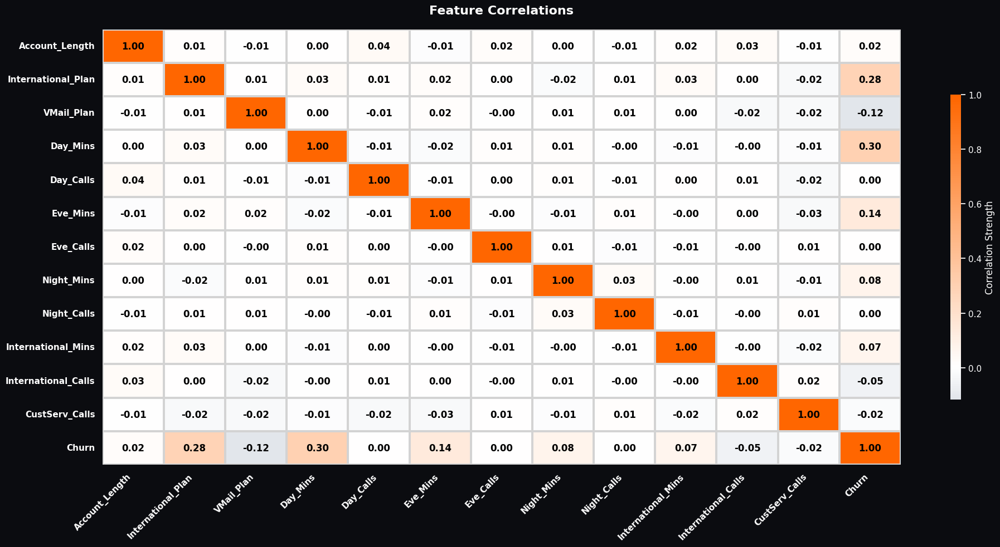

In [ ]:
# ===== Select your features wisely to avoid overfitting =====
# ===== Correlation Heatmap visualization code(After Drop) =====
corr = df_encoded.corr()

bg_color = "#0B0C10"
custom_cmap = sns.color_palette("blend:#001f4d,white,#FF6600", as_cmap=True)

fig, ax = plt.subplots(figsize=(20, 10))
fig.patch.set_facecolor(bg_color)
ax.set_facecolor(bg_color)

sns.heatmap(
    corr,
    annot=True,
    fmt=".2f",
    cmap=custom_cmap,
    center=0,
    linewidths=1.5,
    linecolor="lightgrey",
    annot_kws={"size":12, "weight":"bold", "color":"black"},
    cbar_kws={"shrink":0.7, "aspect":30, "label":"Correlation Strength"},
    ax=ax
)
ax.set_title("Feature Correlations",
             fontsize=16, fontweight="bold", color="white", pad=20)
ax.tick_params(colors="white", labelsize=11, width=0, which="both")
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", weight="bold")
plt.setp(ax.get_yticklabels(), rotation=0, weight="bold")

plt.grid(False)
plt.tight_layout()
plt.show()

**Insights:-**

* The column "Day_Charge" exhibited a high correlation with the "Day_Mins" column. Similarly, the "Eve_Charge" column displayed a strong correlation with the "Eve_Mins" column.

* Additionally, the "Night_Charge" column showed a notable correlation with the "Night_Mins" column. Moreover, the "International_Charge" column demonstrated a significant correlation with the "International_Mins" column.

* Due to these high correlations, one of the paired columns was removed to avoid multicollinearity in the dataset.

### **5.2.3. Variance Inflation Factor**

In [40]:
# ===== Defining a function for variance_inflation_factor =====

def calc_vif(df):
    """
    Calculates Variance Inflation Factor (VIF) for each numerical feature in the dataframe.

    Parameters:
        df (pd.DataFrame): Input dataframe with features

    Returns:
        pd.DataFrame: VIF values sorted in descending order
    """
    # ===== Select only numeric columns =====
    X = df.select_dtypes(include=[np.number])

    # ===== Add constant to the model for intercept =====
    X = add_constant(X)

    # ===== Compute VIF for each feature =====
    vif_data = pd.DataFrame()
    vif_data["Feature"] = X.columns
    vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    # ===== Drop the constant term and sort results =====
    vif_data = vif_data[vif_data["Feature"] != "const"]
    return vif_data.sort_values(by="VIF", ascending=False).reset_index(drop=True)

### **VIF (Variance Inflation Factor):**

Calculating VIF(Variance Inflation Factor) by excluding:

| **VIF Value** | **Interpretation**                           |
| ------------- | -------------------------------------------- |
| 1             | No multicollinearity                         |
| 1–5           | Moderate multicollinearity (generally okay)  |
| > 5           | High multicollinearity (needs investigation) |
| > 10          | Severe multicollinearity (consider removal)  |

"Churn" -> As it is target variable

In [41]:
# ===== Run code =====
df_encoded_vif = df_encoded.drop("Churn", axis=1).copy()
vif_result = calc_vif(df_encoded_vif)
print(vif_result)

                Feature       VIF
0    International_Plan  1.003258
1        CustServ_Calls  1.003197
2        Account_Length  1.003113
3             Day_Calls  1.002371
4              Eve_Mins  1.002357
5              Day_Mins  1.001939
6   International_Calls  1.001900
7            Night_Mins  1.001629
8    International_Mins  1.001570
9            VMail_Plan  1.001554
10          Night_Calls  1.001489
11            Eve_Calls  1.000799


| **Feature**          | **VIF** | **Interpretation**   |
| -------------------- | ------- | -------------------- |
| International\_Plan  | 1.003   | No multicollinearity |
| CustServ\_Calls      | 1.003   | No multicollinearity |
| Account\_Length      | 1.003   | No multicollinearity |
| Day\_Calls           | 1.002   | No multicollinearity |
| Eve\_Mins            | 1.002   | No multicollinearity |
| Day\_Mins            | 1.002   | No multicollinearity |
| International\_Calls | 1.002   | No multicollinearity |
| Night\_Mins          | 1.002   | No multicollinearity |
| International\_Mins  | 1.002   | No multicollinearity |
| VMail\_Plan          | 1.002   | No multicollinearity |
| Night\_Calls         | 1.001   | No multicollinearity |
| Eve\_Calls           | 1.001   | No multicollinearity |


Based on observational insights, the final model will use these 12 influential features, excluding the target variable 'Churn'

| S.No | Feature Name         | Reason for Choosing                                                                                      |
| ---- | -------------------- | -------------------------------------------------------------------------------------------------------- |
| 1    | International\_Plan  | Binary indicator if customer has an international plan; influences usage patterns and churn probability. |
| 2    | CustServ\_Calls      | Number of customer service calls; often linked to dissatisfaction and higher churn risk.                 |
| 3    | Account\_Length      | Duration of the customer account; longer tenure may reduce likelihood of churn.                          |
| 4    | Day\_Calls           | Number of daytime calls; captures customer activity and engagement patterns.                             |
| 5    | Eve\_Mins            | Evening call duration; reflects usage behavior, helps understand customer’s consumption.                 |
| 6    | Day\_Mins            | Daytime call duration; important for modeling service usage and charges.                                 |
| 7    | International\_Calls | Number of international calls; helps quantify international usage impact on churn.                       |
| 8    | Night\_Mins          | Nighttime call duration; reflects overall call usage and engagement.                                     |
| 9    | International\_Mins  | Total international minutes; captures customer’s global call behavior and potential cost concerns.       |
| 10   | VMail\_Plan          | Whether the customer has a voicemail plan; may influence satisfaction and churn.                         |
| 11   | Night\_Calls         | Number of night calls; captures patterns in late-hour usage and overall activity.                        |
| 12   | Eve\_Calls           | Number of evening calls; helps understand peak usage periods and service engagement.                     |


### **5.2.4. Feature selection:**

In [42]:
# ===== Checking =====
df_encoded.columns

Index(['Account_Length', 'International_Plan', 'VMail_Plan', 'Day_Mins',
       'Day_Calls', 'Eve_Mins', 'Eve_Calls', 'Night_Mins', 'Night_Calls',
       'International_Mins', 'International_Calls', 'CustServ_Calls', 'Churn'],
      dtype='object')

In [43]:
# ===== Creating final dataframe =====
final_df = df_encoded.copy()

**Categorical Features:**

* International_Plan
* VMail_Plan

**Numerical Features:**

* Account_Length
* Day_Mins
* Day_Calls
* Eve_Mins
* Eve_Calls
* Night_Mins
* Night_Calls
* International_Mins
* International_Calls
* CustServ_Calls

**Target Feature:**

* Churn

In [45]:
# ===== Check a final dataset =====
final_df.head().T

,0,1,2,3,4
Account_Length,128.0,107.0,137.0,84.0,75.0
International_Plan,0.0,0.0,0.0,1.0,1.0
VMail_Plan,1.0,1.0,0.0,0.0,0.0
Day_Mins,265.1,161.6,243.4,299.4,166.7
Day_Calls,110.0,123.0,114.0,71.0,113.0
Eve_Mins,197.4,195.5,121.2,61.9,148.3
Eve_Calls,99.0,103.0,110.0,88.0,122.0
Night_Mins,244.7,254.4,162.6,196.9,186.9
Night_Calls,91.0,103.0,104.0,89.0,121.0
International_Mins,10.0,13.7,12.2,6.6,10.1


## **5.3. Data Transformation**

### **5.3.1. Identify which features require transformation**

In [46]:
# ===== checking which of the variables are continous in nature =====

for i in final_df.columns:
  print(f"The number of unique counts in feature {i} is: {final_df[i].nunique()}")

The number of unique counts in feature Account_Length is: 215
The number of unique counts in feature International_Plan is: 2
The number of unique counts in feature VMail_Plan is: 2
The number of unique counts in feature Day_Mins is: 1819
The number of unique counts in feature Day_Calls is: 121
The number of unique counts in feature Eve_Mins is: 1755
The number of unique counts in feature Eve_Calls is: 123
The number of unique counts in feature Night_Mins is: 1730
The number of unique counts in feature Night_Calls is: 128
The number of unique counts in feature International_Mins is: 137
The number of unique counts in feature International_Calls is: 10
The number of unique counts in feature CustServ_Calls is: 4
The number of unique counts in feature Churn is: 2


Applying transformation techniques to the following features:

| Feature             | Unique Counts |
| ------------------- | ------------- |
| Account\_Length     | 215           |
| Day\_Mins           | 1819          |
| Day\_Calls          | 121           |
| Eve\_Mins           | 1755          |
| Eve\_Calls          | 123           |
| Night\_Mins         | 1730          |
| Night\_Calls        | 128           |
| International\_Mins | 137           |

### **5.3.2. Evaluate and apply necessary transformations**

### **Chart-11. Examining the distribution and Q-Q plots for each continuous variable in our final dataframe**

Skewness Before Transformation:
  Account_Length: 0.11
  Day_Mins: 0.0
  Day_Calls: -0.05
  Eve_Mins: -0.0
  Eve_Calls: -0.01
  Night_Mins: 0.03
  Night_Calls: 0.02
  International_Mins: -0.05


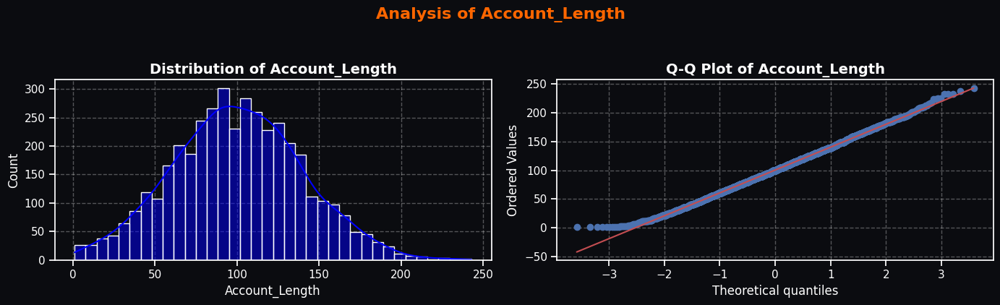

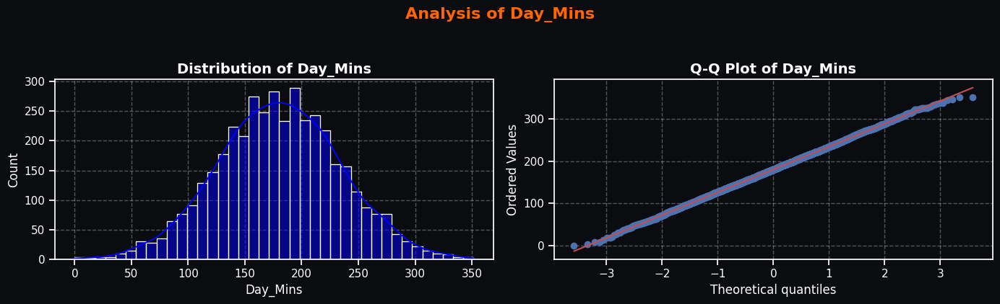

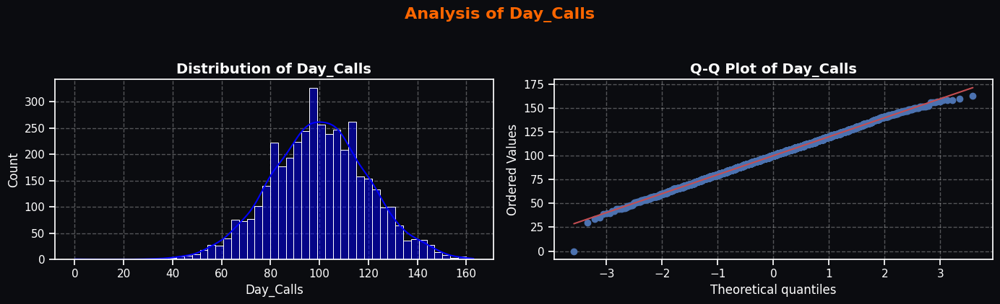

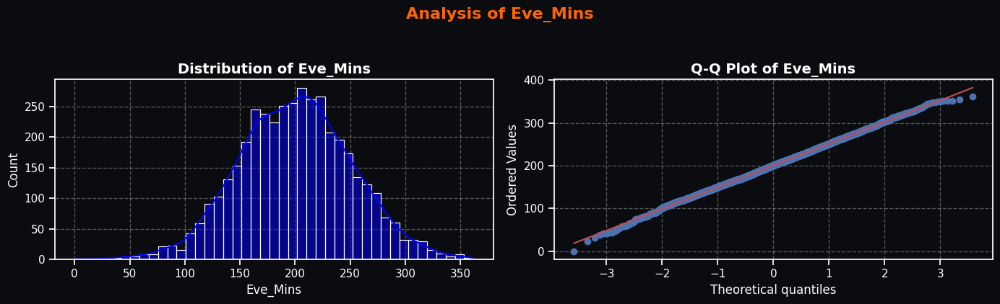

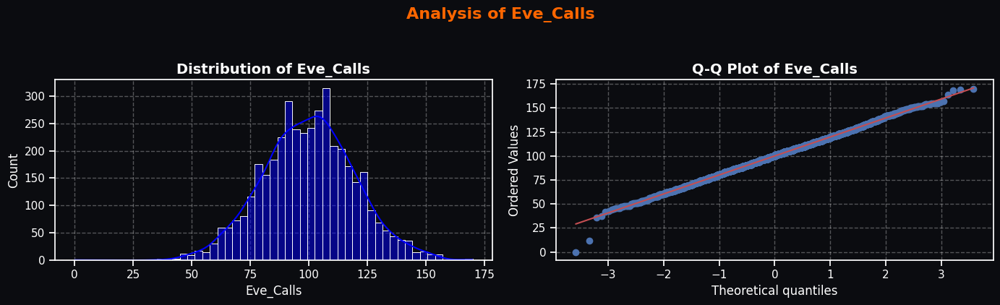

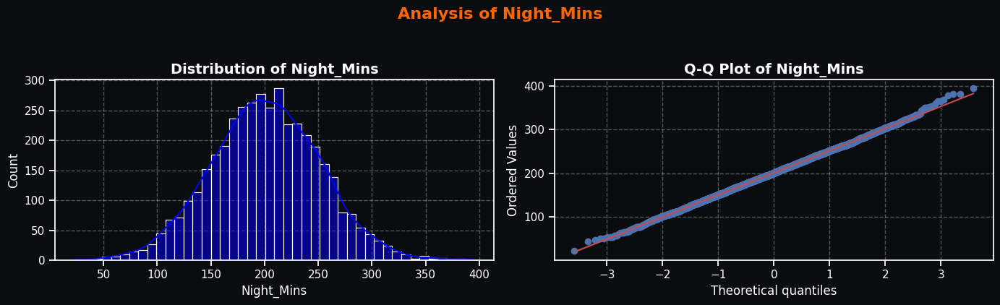

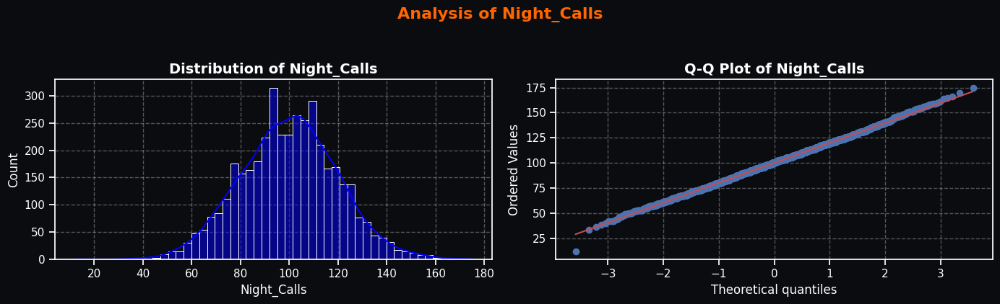

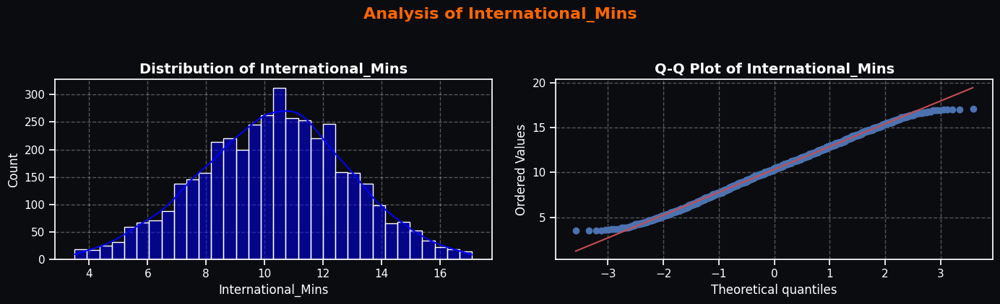

In [ ]:
# ===== Checking the distribution and Q-Q plot of each continous variable from our final dataframe =====

# ===== Define continuous features to analyze =====
selected_features = [
    'Account_Length',
    'Day_Mins',
    'Day_Calls',
    'Eve_Mins',
    'Eve_Calls',
    'Night_Mins',
    'Night_Calls',
    'International_Mins'
]

# ===== Colors & Background =====
bg_color = "#0B0C10"
colors = ["blue", "#FF6600"]  # ===== navy & orange =====

# ===== Check skewness =====
print("Skewness Before Transformation:")
for col in selected_features:
    skew_val = round(final_df[col].skew(), 2)
    print(f"  {col}: {skew_val}")

# ===== Plot Distribution + Q-Q side by side for each feature =====
for col in selected_features:
    fig, axes = plt.subplots(1, 2, figsize=(14, 4))
    fig.patch.set_facecolor(bg_color)  # ===== figure background =====
    axes[0].set_facecolor(bg_color)    # ===== left plot background =====
    axes[1].set_facecolor(bg_color)    # ===== right plot background =====

    # ===== Distribution plot (left) =====
    sns.histplot(
        final_df[col],
        kde=True,
        color=colors[0],  # ===== navy =====
        ax=axes[0]
    )
    axes[0].set_title(f'Distribution of {col}', fontsize=14, fontweight='bold', color='white')
    axes[0].tick_params(colors='white')
    axes[0].grid(True, color='white', linestyle='--', alpha=0.3)  # ===== grid lines =====

    # ===== Q-Q plot (right) =====
    stats.probplot(final_df[col], dist="norm", plot=axes[1])
    axes[1].set_title(f'Q-Q Plot of {col}', fontsize=14, fontweight='bold', color='white')
    axes[1].tick_params(colors='white')
    axes[1].grid(True, color='white', linestyle='--', alpha=0.3)  # ===== grid lines =====

    # ===== Overall title for this feature =====
    fig.suptitle(f"Analysis of {col}", fontsize=16, fontweight="bold", color=colors[1], y=1.05)

    plt.tight_layout()
    plt.show()

| Feature             | Skewness |
| ------------------- | -------- |
| Account\_Length     | 0.11     |
| Day\_Mins           | 0.00     |
| Day\_Calls          | -0.05    |
| Eve\_Mins           | -0.00    |
| Eve\_Calls          | -0.01    |
| Night\_Mins         | 0.03     |
| Night\_Calls        | 0.02     |
| International\_Mins | -0.05    |


All continuous features have skewness values close to 0, indicating that their distributions are approximately symmetric. This suggests that the data is roughly normally distributed, and no transformation is necessary. Therefore, the distributions and Q-Q plots of these features should appear well-behaved and suitable for modeling without further adjustment.

## **5.4. Data Scaling - StandardScaler**

In [47]:
# ===== Applying StandardScaler for Feature Normalization =====

# ===== Create a copy of the dataframe =====
final_scale_df = final_df.copy()

# ===== List of features to scale =====
features_to_scale = [
    'Account_Length',
    'Day_Mins',
    'Day_Calls',
    'Eve_Mins',
    'Eve_Calls',
    'Night_Mins',
    'Night_Calls',
    'International_Mins',
    'International_Calls',
    'CustServ_Calls'
]

# ===== Initialize StandardScaler =====
scaler = StandardScaler()

# ===== Fit & transform the selected features =====
final_scale_df[features_to_scale] = scaler.fit_transform(final_scale_df[features_to_scale])

**Which method have you used to scale you data and why?**

To ensure optimal model performance and convergence, we standardized the data using StandardScaler from sklearn. This process transforms features to a common scale, preventing variables with larger inherent scales from dominating the model. Furthermore, standardization enables more meaningful comparison of model coefficients, simplifying the interpretation of each feature's influence.

In [48]:
# ===== RunCode =====
final_scale_df.head().T

,0,1,2,3,4
Account_Length,0.694045,0.165568,0.920535,-0.413239,-0.639729
International_Plan,0.000000,0.000000,0.000000,1.000000,1.000000
VMail_Plan,1.000000,1.000000,0.000000,0.000000,0.000000
Day_Mins,1.568163,-0.346475,1.166737,2.202677,-0.252131
Day_Calls,0.503908,1.158011,0.705170,-1.458400,0.654855
Eve_Mins,-0.060068,-0.097496,-1.561129,-2.729277,-1.027287
Eve_Calls,-0.050822,0.151524,0.505628,-0.607272,1.112665
Night_Mins,0.861650,1.053531,-0.762416,-0.083909,-0.281724
Night_Calls,-0.454253,0.150117,0.200481,-0.554981,1.056672
International_Mins,-0.129580,1.324474,0.734993,-1.465738,-0.090281


# **6. Train-Test Split**

## **6.1. Data Splitting**

In [49]:
# ===== Split your data to train and test. Choose Splitting ratio wisely =====
x= final_scale_df.drop(columns='Churn',axis=1)
y= final_scale_df[['Churn']]

# ===== Spliting data =====
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0, stratify=y)

In [50]:
# ===== Checking the distribution of classes in training and testing sets =====
# Flatten y
y_train_flat = y_train.squeeze()
y_test_flat = y_test.squeeze()

# ===== Dataset Split Summary =====
split_summary = pd.DataFrame({
    "Dataset": ["x_train", "x_test", "y_train", "y_test"],
    "Shape": [x_train.shape, x_test.shape, y_train.shape, y_test.shape]
})

print("Dataset Split Summary\n")
print(split_summary.to_string(index=False))
print("-" * 53)

# ===== Target Variable Distribution (Counts & Percentages) =====
train_counts = pd.Series(y_train_flat).value_counts().rename("Train Count")
test_counts = pd.Series(y_test_flat).value_counts().rename("Test Count")

train_perc = (pd.Series(y_train_flat).value_counts(normalize=True)*100).round(2).rename("Train %")
test_perc = (pd.Series(y_test_flat).value_counts(normalize=True)*100).round(2).rename("Test %")

dist_summary = pd.concat([train_counts, test_counts, train_perc, test_perc], axis=1)
dist_summary.index.name = "Y"

print("\nTarget Variable Distribution (Counts & Percentages)\n")
print(dist_summary.to_string())

Dataset Split Summary

Dataset      Shape
x_train (3264, 12)
 x_test  (816, 12)
y_train  (3264, 1)
 y_test   (816, 1)
-----------------------------------------------------

Target Variable Distribution (Counts & Percentages)

   Train Count  Test Count  Train %  Test %
Y                                          
0         2908         727    89.09   89.09
1          356          89    10.91   10.91


**What data splitting ratio have you used and why?**

*   Train Set -  80
*   Test Set  -  20

### **Chart-12. Target Variable Distribution**

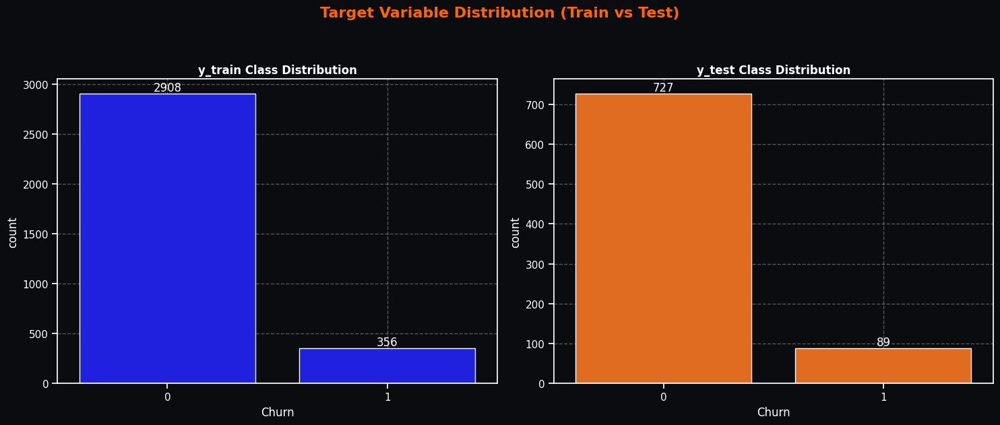

In [ ]:
# ===== Plot distributions =====

# ===== Background color (dark navy) =====
bg_color = "#0B0C10"
colors = ["blue", "#FF6600"]

fig, axes = plt.subplots(1, 2, figsize=(15, 6))
fig.patch.set_facecolor(bg_color)

# ===== Train distribution =====
sns.countplot(x=y_train_flat, color=colors[0], ax=axes[0])
axes[0].set_title("y_train Class Distribution", fontsize=12, fontweight="bold", color='white')
axes[0].tick_params(colors='white')
axes[0].bar_label(axes[0].containers[0])
axes[0].set_facecolor(bg_color)
axes[0].grid(True, color='white', linestyle='--', alpha=0.3)

# ===== Test distribution =====
sns.countplot(x=y_test_flat, color=colors[1], ax=axes[1])
axes[1].set_title("y_test Class Distribution", fontsize=12, fontweight="bold", color='white')
axes[1].tick_params(colors='white')
axes[1].bar_label(axes[1].containers[0])
axes[1].set_facecolor(bg_color)
axes[1].grid(True, color='white', linestyle='--', alpha=0.3)

# ===== Overall title =====
plt.suptitle("Target Variable Distribution (Train vs Test)", fontsize=16, fontweight="bold", color=colors[1], y=1.05)
plt.tight_layout()
plt.show()

## **6.2. Handling Imbalanced Dataset**

### **6.2.1. Handling Imbalanced Dataset**

**Do you think the dataset is imbalanced? Explain Why?**

The target variable distribution is highly imbalanced, with 89.09% labeled as "no" and only 10.91% labeled as "yes". This imbalance indicates that the dataset is dominated by the majority class, making it difficult for models to learn patterns related to the minority class and this imbalanced data will give highly biased results.

### **Chart-13. Handling Imbalanced Dataset**

Class Distribution of Churn:
       Count  Percentage (%)
Churn                       
0      3635        89.09    
1       445        10.91     



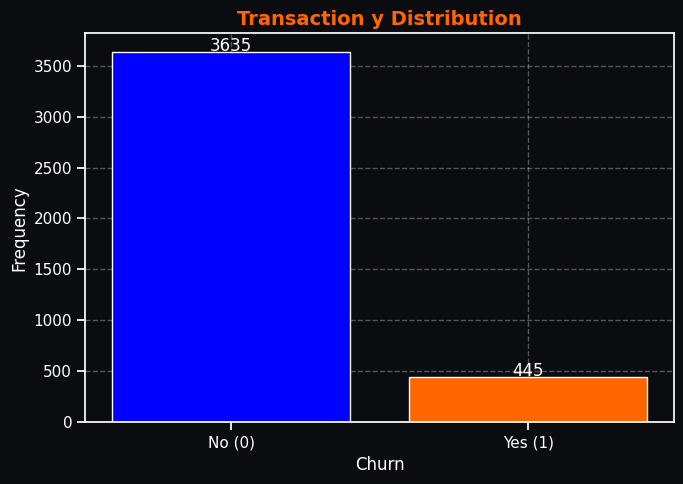

In [ ]:
# ===== Handling Imbalanced Dataset =====
counts = final_scale_df['Churn'].value_counts()
percentages = final_scale_df['Churn'].value_counts(normalize=True) * 100
y_dist_table = pd.DataFrame({
    'Count': counts,
    'Percentage (%)': percentages.round(2)
})
print("Class Distribution of Churn:")
print(y_dist_table, '\n')

# ===== Visualizing the imbalanced class with custom colors & background =====
bg_color = "#0B0C10"
colors = ["blue", "#FF6600"]

fig, ax = plt.subplots(figsize=(7, 5))
fig.patch.set_facecolor(bg_color)
ax.set_facecolor(bg_color)

# ===== Bar plot =====
count_classes = final_scale_df['Churn'].value_counts(sort=True)
bars = ax.bar(['No (0)', 'Yes (1)'], count_classes, color=colors)

# ===== Add counts on top of bars =====
for bar in bars:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, height + 5, f'{height}', ha='center', color='white', fontsize=12)

# ===== Titles & labels =====
ax.set_title("Transaction y Distribution", fontsize=14, fontweight="bold", color=colors[1])
ax.set_xlabel("Churn", color='white', fontsize=12)
ax.set_ylabel("Frequency", color='white', fontsize=12)
ax.tick_params(colors='white')
ax.grid(True, color='white', linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()

### **6.2.2. SMOTE for balancing the dataset**

In [51]:
# ===== Fitting the data =====
smote = SMOTE(sampling_strategy='minority', random_state=0)
x_sm, y_sm = smote.fit_resample(x, y)

# ===== Checking Value counts for both classes Before and After handling Class Imbalance: =====
for col,label in [[y,"Before"],[y_sm,'After']]:
  print(label+' Handling Class Imbalace:')
  print(col.value_counts(),'\n')

Before Handling Class Imbalace:
Churn
0        3635
1         445
Name: count, dtype: int64 

After Handling Class Imbalace:
Churn
0        3635
1        3635
Name: count, dtype: int64 



In [52]:
# ===== Respliting the dataset after using SMOTE =====
x_smote_train, x_smote_test, y_smote_train, y_smote_test = train_test_split(x_sm,y_sm , test_size = 0.2, random_state = 1)

**What technique did you use to handle the imbalance dataset and why?**

**Technique Used: SMOTE (Synthetic Minority Oversampling Technique)**

* SMOTE is a resampling technique used to handle imbalanced datasets.
Instead of simply duplicating minority samples (which can cause overfitting), SMOTE creates synthetic (new) samples of the minority class by interpolating between existing minority samples and their nearest neighbors.

* Handling imbalance is important because without it, the model would be biased towards predicting the majority class, giving misleadingly high accuracy but poor performance on the minority class. Since the minority class (customers who subscribe) is the most valuable for the bank, addressing imbalance with SMOTE ensures the model learns from both classes effectively, improves recall and F1-score, and provides actionable insights for marketing campaigns.

# **7. Task-2 - ML Model Implementation**

## **7.1. Analyze Model**

In [ ]:
# ===== Defining a function to train the input model and print evaluation metrics in visualize format =====

# ===== Background color =====
bg_color = "#0B0C10"

def analyze_model(model, X_train, y_train, X_test, y_test):
    """
    Evaluate a classification model and visualize results with compact plots,
    including metrics, confusion matrix, ROC curve, classification report, and tables.
    """

    # ===== Train Model =====
    start_time = time.time()
    model.fit(X_train, y_train)
    train_time = time.time() - start_time

    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)

    y_proba = None
    if hasattr(model, "predict_proba"):
        try:
            y_proba = model.predict_proba(X_test)[:, 1]
        except:
            pass

    # ===== Confusion matrix =====
    conf_mat = confusion_matrix(y_test, y_pred)
    TN, FP, FN, TP = conf_mat.ravel()

    # ===== Cross-validated F1 =====
    try:
      cv_scores = cross_val_score(
          model, X_train, y_train,
          cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42),
          scoring='f1'
      )
      cv_f1 = cv_scores.mean()
    except Exception as e:
      print(f"Cross-Validation failed: {e}")
      cv_f1 = None
    # ===== Train and Test Accuracy =====
    train_accuracy = accuracy_score(y_train, y_pred_train)
    test_accuracy = accuracy_score(y_test, y_pred)


    # ===== Metrics dictionary =====
    metrics = {
        "Training Accuracy": round(train_accuracy, 4),
        "Test Accuracy": round(test_accuracy, 4),
        "Overfit (Train - Test Acc)": round(train_accuracy - test_accuracy, 4),
        "Precision": round(precision_score(y_test, y_pred, zero_division=0), 4),
        "Recall": round(recall_score(y_test, y_pred, zero_division=0), 4),
        "F1-Score": round(f1_score(y_test, y_pred, zero_division=0), 4),
        "Cross-Validation F1-Score": round(cv_f1, 4) if cv_f1 else "N/A",
        "True Negatives (TN)": TN,
        "False Positives (FP)": FP,
        "False Negatives (FN)": FN,
        "True Positives (TP)": TP,
        "Training Time (sec)": round(train_time, 3)
    }

    if y_proba is not None:
        try:
            metrics["ROC AUC Score"] = round(roc_auc_score(y_test, y_proba), 4)
        except:
            metrics["ROC AUC Score"] = None

    # ===== Subset for plotting =====
    plot_metrics = {k: v for k, v in metrics.items() if k in [
        "Training Accuracy", "Test Accuracy", "Precision", "Recall",
        "F1-Score", "ROC AUC Score"
    ] and v not in [None, "N/A"]}
    metrics_df = pd.DataFrame(list(plot_metrics.items()), columns=["Metric", "Value"])

    # ===== Compact Visualization Layout =====
    fig, axes = plt.subplots(3, 2, figsize=(20, 16))
    fig.patch.set_facecolor(bg_color)
    for ax in axes.flat:
        ax.set_facecolor(bg_color)

    fig.suptitle(
        f"Model Evaluation: {model.__class__.__name__}\n"
        f"Test Accuracy: {metrics['Test Accuracy']} | CV F1: {metrics['Cross-Validation F1-Score']}",
        fontsize=15, weight="bold", color="#FF6600"
    )

    # ===== 1. Metrics Bar Chart =====
    cmap = cm.get_cmap('Wistia')
    norm = plt.Normalize(metrics_df["Value"].min(), metrics_df["Value"].max())
    colors = cmap(norm(metrics_df["Value"].astype(float)))

    bars = axes[0, 0].barh(metrics_df["Metric"], metrics_df["Value"].astype(float), color=colors, edgecolor="white")
    axes[0, 0].set_title("Performance Metrics", fontsize=12, weight="bold", color="white")
    axes[0, 0].set_xlim(0, 1)
    axes[0, 0].tick_params(colors='white')
    axes[0, 0].grid(axis='x', linestyle='--', linewidth=0.7, alpha=0.5, color='white')
    axes[0, 0].grid(axis='y', linestyle='--', linewidth=0.5, alpha=0.3, color='white')
    for bar in bars:
        width = bar.get_width()
        axes[0, 0].text(width + 0.01, bar.get_y() + bar.get_height()/2,
                        f'{width:.2f}', ha='left', va='center', fontsize=9, color='white')

    # ===== 2. Confusion Matrix =====
    cmap_heat = mcolors.LinearSegmentedColormap.from_list("navy_orange", ["#001f4d", "#FF6600"])
    sns.heatmap(
        conf_mat,
        annot=True,
        fmt="d",
        cmap=cmap_heat,
        ax=axes[0, 1],
        xticklabels=["Pred: No", "Pred: Yes"],
        yticklabels=["Actual: No", "Actual: Yes"],
        cbar=False,
        linewidths=1,
        linecolor="white"
    )
    axes[0, 1].set_title("Confusion Matrix", fontsize=12, weight="bold", color="white")
    axes[0, 1].tick_params(colors='white')

    # ===== 3. ROC Curve =====
    if y_proba is not None and metrics.get("ROC AUC Score"):
        fpr, tpr, _ = roc_curve(y_test, y_proba)
        axes[1, 0].plot(fpr, tpr, color="#FF6600", linewidth=2,
                        label=f"ROC AUC = {metrics['ROC AUC Score']:.3f}")
        axes[1, 0].plot([0, 1], [0, 1], '--', color='white', alpha=0.7, linewidth=1)
        axes[1, 0].legend(fontsize=9, facecolor=bg_color, edgecolor='white', labelcolor='white')
    else:
        axes[1, 0].text(0.5, 0.5, "ROC Curve Not Available",
                        ha='center', va='center', fontsize=10, color='white')

    axes[1, 0].set_title("ROC Curve", fontsize=12, weight="bold", color='white')
    axes[1, 0].set_xlabel("False Positive Rate", color='white')
    axes[1, 0].set_ylabel("True Positive Rate", color='white')
    axes[1, 0].tick_params(colors='white')
    axes[1, 0].grid(True, linestyle='--', alpha=0.5, color='white')

    # ===== 4. Additional Metrics Table =====
    axes[1, 1].axis('off')
    additional_metrics = {
        "Cross-Val F1": metrics["Cross-Validation F1-Score"],
        "Overfit": metrics["Overfit (Train - Test Acc)"],
        "Train Time": f"{metrics['Training Time (sec)']}s",
        "Samples": f"Train: {len(X_train)}, Test: {len(X_test)}"
    }
    table_data = [[k, v] for k, v in additional_metrics.items()]
    table = axes[1, 1].table(
        cellText=table_data,
        cellLoc='center',
        colLabels=["Metric", "Value"],
        loc='center',
        bbox=[0.1, 0.3, 0.8, 0.4]
    )
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(1, 1.5)
    for (row, col), cell in table.get_celld().items():
        if row == 0:
            cell.set_facecolor("#6A0DAD")
            cell.set_text_props(weight='bold', color="white")
        else:
            cell.set_facecolor("black")
    axes[1, 1].set_title("Additional Metrics", fontsize=12, weight="bold", pad=15, color="purple")

    # ===== 5. Classification Report =====
    report = classification_report(y_test, y_pred, output_dict=True, target_names=["No", "Yes"])
    report_df = pd.DataFrame(report).iloc[:-1, :].T
    sns.heatmap(report_df, annot=True, fmt=".2f", cmap="Blues", ax=axes[2, 0])
    axes[2, 0].set_title("Classification Report Heatmap", fontsize=12, weight="bold", color='white')

    # ===== 6. Comprehensive Metrics Bar Chart =====
    metrics_for_chart = {k: v for k, v in metrics.items() if isinstance(v, (int, float))}
    comp_df = pd.DataFrame(list(metrics_for_chart.items()), columns=["Metric", "Value"])

    cmap = cm.get_cmap('brg')
    norm = plt.Normalize(comp_df["Value"].min(), comp_df["Value"].max())
    colors = cmap(norm(comp_df["Value"].astype(float)))

    bars = axes[2, 1].barh(comp_df["Metric"], comp_df["Value"], color=colors, edgecolor="white")
    axes[2, 1].set_title("Comprehensive Metrics", fontsize=12, weight="bold", color='white')
    axes[2, 1].tick_params(colors='white')
    axes[2, 1].grid(axis='x', linestyle='--', linewidth=0.7, alpha=0.5, color='white')

    for i, v in enumerate(comp_df["Value"]):
      axes[2, 1].text(v + 0.01, i, str(v), va='center', color='white')


    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

    return metrics

### **7.1.1. ML Model - 1. Logistic Regression**

### **Chart-14. Explain the ML Model and it's performance using Evaluation metric Score Chart**

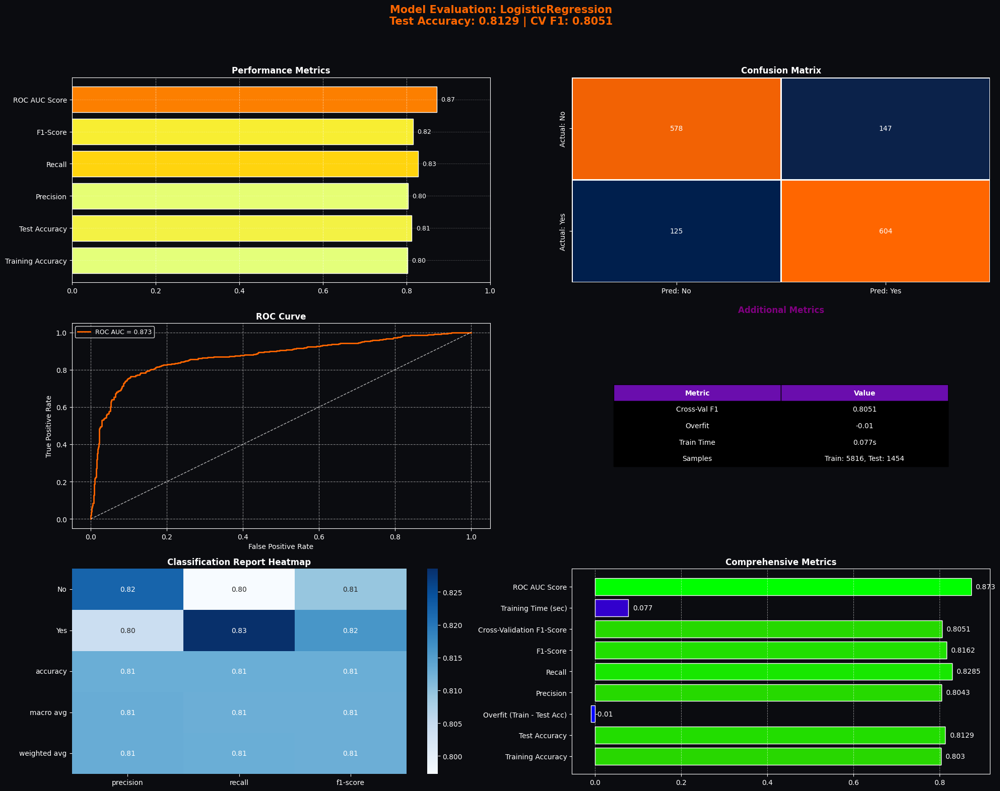

{'Training Accuracy': 0.803,
 'Test Accuracy': 0.8129,
 'Overfit (Train - Test Acc)': -0.01,
 'Precision': 0.8043,
 'Recall': 0.8285,
 'F1-Score': 0.8162,
 'Cross-Validation F1-Score': np.float64(0.8051),
 'True Negatives (TN)': np.int64(578),
 'False Positives (FP)': np.int64(147),
 'False Negatives (FN)': np.int64(125),
 'True Positives (TP)': np.int64(604),
 'Training Time (sec)': 0.077,
 'ROC AUC Score': np.float64(0.873)}

In [ ]:
# ===== Fitting Logistic Regression Model =====
lgr_model = LogisticRegression(
    max_iter=500,              # increase iterations for convergence
    class_weight='balanced',   # handles imbalance
    random_state=3
)

# ===== Analysing the model and Visualizing evaluation Metric Score chart =====
analyze_model(lgr_model, x_smote_train, y_smote_train, x_smote_test, y_smote_test)

### **7.1.2. ML Model - 2. Random Forest Classifier**

### **Chart-15. Explain the ML Model and it's performance using Evaluation metric Score Chart**

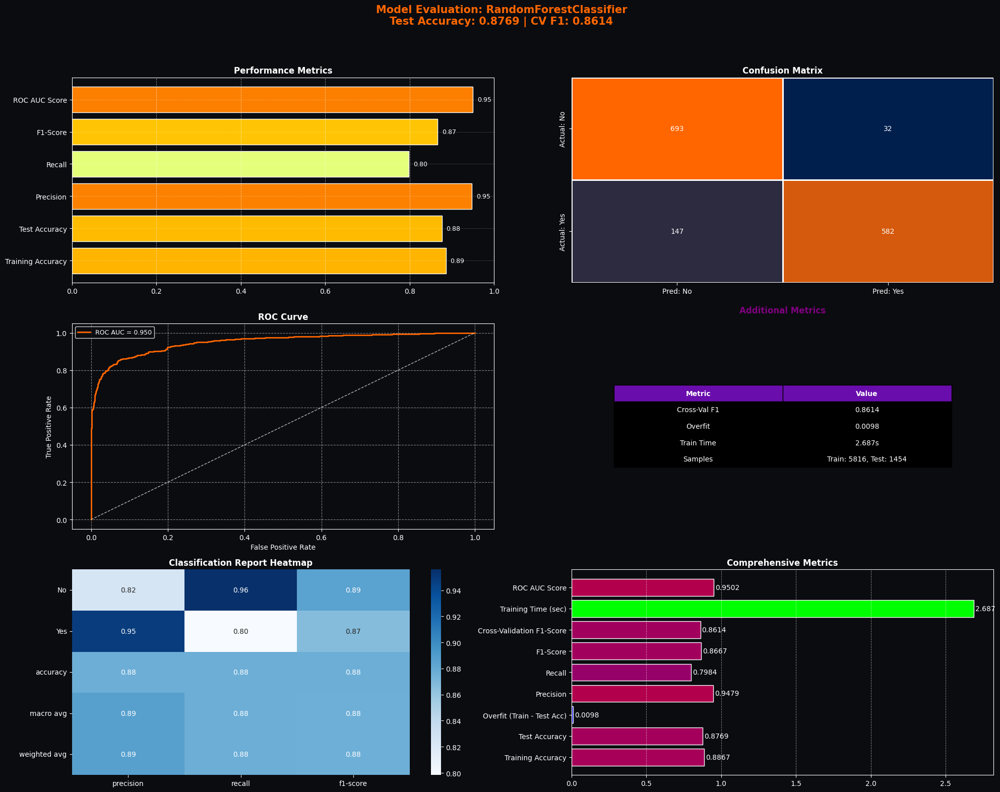

{'Training Accuracy': 0.8867,
 'Test Accuracy': 0.8769,
 'Overfit (Train - Test Acc)': 0.0098,
 'Precision': 0.9479,
 'Recall': 0.7984,
 'F1-Score': 0.8667,
 'Cross-Validation F1-Score': np.float64(0.8614),
 'True Negatives (TN)': np.int64(693),
 'False Positives (FP)': np.int64(32),
 'False Negatives (FN)': np.int64(147),
 'True Positives (TP)': np.int64(582),
 'Training Time (sec)': 2.687,
 'ROC AUC Score': np.float64(0.9502)}

In [ ]:
# ===== Fitting RandomForestClassifier Model =====
rf_model = RandomForestClassifier(
    random_state=4,
    class_weight='balanced',  # handle imbalance
    n_estimators=200,
    max_depth=6
)

# ===== Analysing the model and Visualizing evaluation Metric Score chart =====
analyze_model(rf_model, x_smote_train, y_smote_train, x_smote_test, y_smote_test)

### **7.1.3. ML Model - 3. XGBoost Classifier**

### **Chart-16. Explain the ML Model and it's performance using Evaluation metric Score Chart**

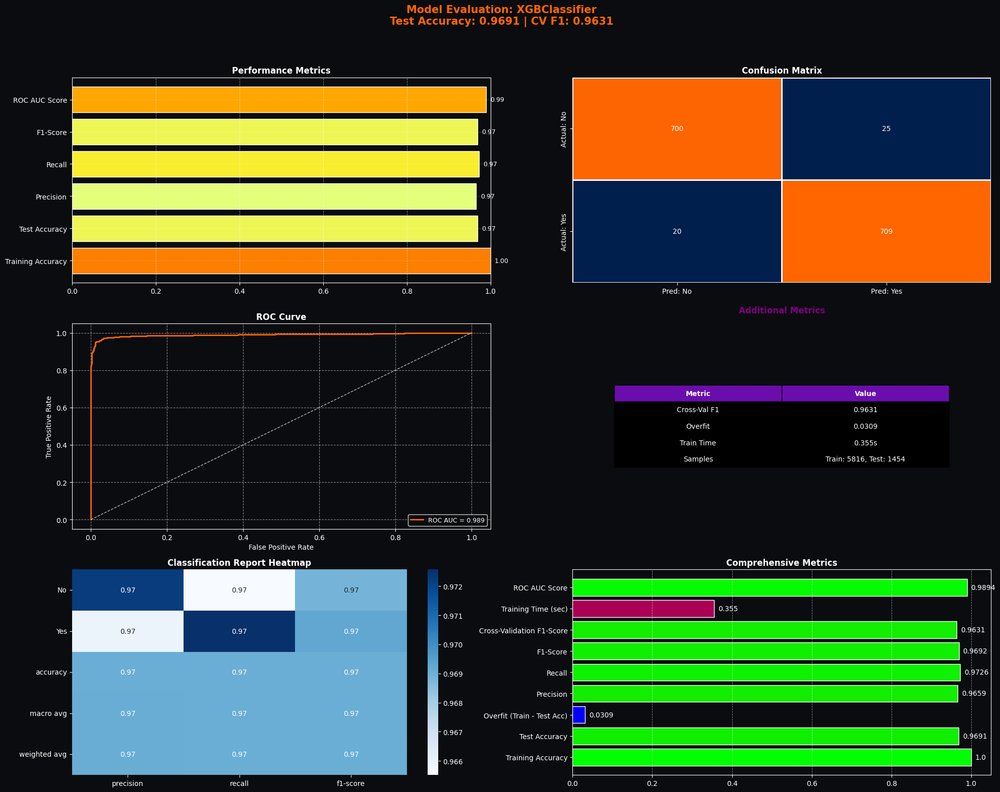

{'Training Accuracy': 1.0,
 'Test Accuracy': 0.9691,
 'Overfit (Train - Test Acc)': 0.0309,
 'Precision': 0.9659,
 'Recall': 0.9726,
 'F1-Score': 0.9692,
 'Cross-Validation F1-Score': np.float64(0.9631),
 'True Negatives (TN)': np.int64(700),
 'False Positives (FP)': np.int64(25),
 'False Negatives (FN)': np.int64(20),
 'True Positives (TP)': np.int64(709),
 'Training Time (sec)': 0.355,
 'ROC AUC Score': np.float64(0.9894)}

In [ ]:
# ===== Fitting XGBClassifier Model =====
xgb_model = XGBClassifier(
    scale_pos_weight=7.87,
    random_state=5,
    use_label_encoder=False,
    eval_metric='logloss'
)

# ===== Analysing the model and Visualizing evaluation Metric Score chart =====
analyze_model(xgb_model, x_smote_train, y_smote_train, x_smote_test, y_smote_test)

### **7.1.4. ML Model - 4. LightGBM Classifier**

### **Chart-17. Explain the ML Model and it's performance using Evaluation metric Score Chart**

[LightGBM] [Info] Number of positive: 2906, number of negative: 2910
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001057 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2554
[LightGBM] [Info] Number of data points in the train set: 5816, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.499656 -> initscore=-0.001376
[LightGBM] [Info] Start training from score -0.001376
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

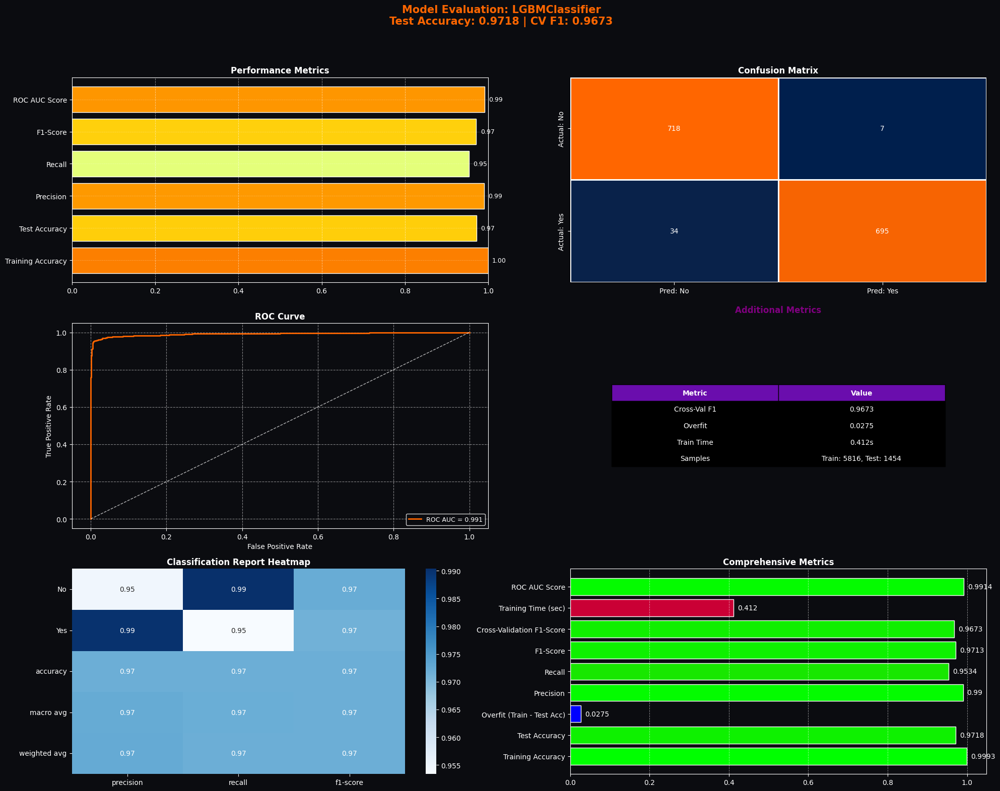

{'Training Accuracy': 0.9993,
 'Test Accuracy': 0.9718,
 'Overfit (Train - Test Acc)': 0.0275,
 'Precision': 0.99,
 'Recall': 0.9534,
 'F1-Score': 0.9713,
 'Cross-Validation F1-Score': np.float64(0.9673),
 'True Negatives (TN)': np.int64(718),
 'False Positives (FP)': np.int64(7),
 'False Negatives (FN)': np.int64(34),
 'True Positives (TP)': np.int64(695),
 'Training Time (sec)': 0.412,
 'ROC AUC Score': np.float64(0.9914)}

In [ ]:
# ===== Fitting LightGBMClassifier Model =====
lgbm_model = LGBMClassifier(
    is_unbalance=True,   # handle imbalance automatically
    random_state=6,
    n_estimators=200,
    max_depth=6
)

# ===== Analysing the model and Visualizing evaluation Metric Score chart =====
analyze_model(lgbm_model, x_smote_train, y_smote_train, x_smote_test, y_smote_test)

## **7.2. Hyperparameter Tuning**

In [ ]:
# ===== Cross - Validation & Hyperparameter =====

# ===== Background color =====
bg_color = "#0B0C10"

def hyperparameter_tune(model_name, model, param_grid, X_train, y_train, X_test, y_test, n_iter=20, cv=3, use_proba=True):

    print(f"\nTuning Hyperparameters for {model_name}...")

    # ===== Hyperparameter tuning =====
    start_time = time.time()
    search = RandomizedSearchCV(
        estimator=model,
        param_distributions=param_grid,
        n_iter=n_iter,
        scoring='f1',
        cv=cv,
        n_jobs=-1,
        verbose=2,
        random_state=42
    )
    search.fit(X_train, y_train)
    best_params = search.best_params_
    best_model = model.set_params(**best_params)
    best_model.fit(X_train, y_train)
    train_time = time.time() - start_time

    # ===== Predictions =====
    y_pred_train = best_model.predict(X_train)
    y_pred_test = best_model.predict(X_test)
    y_proba = best_model.predict_proba(X_test)[:,1] if use_proba else None

    # ===== Metrics =====
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred_test).ravel()
    train_acc = accuracy_score(y_train, y_pred_train)
    test_acc = accuracy_score(y_test, y_pred_test)
    try:
        cv_f1 = cross_val_score(best_model, X_train, y_train,
                                cv=StratifiedKFold(n_splits=cv, shuffle=True, random_state=42),
                                scoring='f1', n_jobs=-1).mean()
    except:
        cv_f1 = None

    metrics = {
        "Train Accuracy": train_acc,
        "Test Accuracy": test_acc,
        "Overfit": train_acc - test_acc,
        "Precision": precision_score(y_test, y_pred_test, zero_division=0),
        "Recall": recall_score(y_test, y_pred_test, zero_division=0),
        "F1-Score": f1_score(y_test, y_pred_test, zero_division=0),
        "Cross-Val F1-Score": cv_f1,
        "ROC-AUC Score": roc_auc_score(y_test, y_proba) if y_proba is not None else None,
        "Training Time (sec)": train_time,
        "TN": tn, "FP": fp, "FN": fn, "TP": tp,
        "Train Samples": len(y_train), "Test Samples": len(y_test)
    }

    metrics_df = pd.DataFrame([metrics])
    display(metrics_df)
    print(f"\nBest Parameters for {model_name}: {best_params}\n")

    # ===== Visualization Layout =====
    fig, axes = plt.subplots(3, 2, figsize=(20, 16))
    fig.suptitle(
        f"Hyperparameters-Tuning Model Evaluation: {model.__class__.__name__}\n"
        f"Test Accuracy: {metrics['Test Accuracy']:.4f} | CV F1: {metrics['Cross-Val F1-Score']:.4f}",
        fontsize=15, weight="bold", color="#FF6600"
    )

    # ===== 1. Key Performance Metrics =====
    key_metrics = ["Train Accuracy","Test Accuracy","F1-Score","Recall","Precision","ROC-AUC Score"]
    key_vals = [metrics[k] for k in key_metrics if metrics[k] is not None]
    cmap = plt.get_cmap("Blues")
    norm = mcolors.Normalize(vmin=min(key_vals), vmax=max(key_vals))
    colors = [cmap(norm(v)) for v in key_vals]
    axes[0,0].barh(key_metrics[:len(key_vals)], key_vals, color=colors)
    axes[0, 0].grid(axis='x', linestyle='--', linewidth=0.7, alpha=0.5, color='white')
    axes[0, 0].grid(axis='y', linestyle='--', linewidth=0.5, alpha=0.3, color='white')
    axes[0,0].set_xlim(0,1)
    axes[0,0].set_title("Key Performance Metrics", fontsize=14, weight='bold')
    for i, v in enumerate(key_vals):
        axes[0,0].text(v + 0.01, i, f"{v:.4f}", va='center', fontweight='bold', color='white')

    # ===== 2. Confusion Matrix =====
    cm = np.array([[tn, fp],[fn, tp]])
    sns.heatmap(cm, annot=True, fmt="d", cmap="Wistia",
                ax=axes[0,1],
                xticklabels=["Pred: 0", "Pred: 1"],
                yticklabels=["Actual: 0", "Actual: 1"],
                cbar=True, linewidths=0.8, linecolor='white', annot_kws={"size":14, "weight":"bold"})
    axes[0,1].set_title("Confusion Matrix", fontsize=12, weight="bold", color="darkblue")

    # ===== 3. ROC Curve =====
    if y_proba is not None:
        fpr, tpr, _ = roc_curve(y_test, y_proba)
        axes[1,0].plot(fpr, tpr, color="#FF6600", linewidth=2, label=f"AUC={metrics['ROC-AUC Score']:.4f}")
        axes[1,0].plot([0,1],[0,1],'--',color='red',alpha=0.7)
        axes[1,0].legend()
    else:
        axes[1,0].text(0.5,0.5,"ROC Curve Not Available",ha='center',va='center')
    axes[1,0].set_title("ROC Curve")
    axes[1,0].set_xlabel("FPR")
    axes[1,0].set_ylabel("TPR")
    axes[1,0].grid(True, linestyle='--', alpha=0.5, color='white')

    # ===== 4. Additional Metrics Table =====
    axes[1,1].axis('off')
    add_metrics = {
        "Cross-Val F1": metrics["Cross-Val F1-Score"],
        "Overfit": metrics["Overfit"],
        "Training Time": metrics['Training Time (sec)'],
        "Train Samples": metrics["Train Samples"],
        "Test Samples": metrics["Test Samples"]
    }

    table_data = [[k, f"{v:.4f}" if isinstance(v, float) else v] for k,v in add_metrics.items()]

    table = axes[1,1].table(
        cellText=table_data,
        colLabels=["Metric", "Value"],
        cellLoc='center',
        loc='center'
    )
    table.auto_set_font_size(False)
    table.set_fontsize(11)
    table.scale(1, 1.5)
    for (row, col), cell in table.get_celld().items():
        if row == 0:
            cell.set_facecolor("#6A0DAD")
            cell.set_text_props(weight='bold', color='white')
        else:
            cell.set_facecolor("#E6E6FA" if row % 2 == 0 else "#F0F8FF")
            cell.set_text_props(weight='bold', color='black')
    axes[1,1].set_title("Additional Metrics", pad=15, color="#6A0DAD", weight="bold")

    # ===== 5. Classification Report Heatmap =====
    report_df = pd.DataFrame(classification_report(y_test, y_pred_test, output_dict=True)).iloc[:-1,:].T
    sns.heatmap(report_df.iloc[:, :3], annot=True, fmt=".4f", cmap="Reds", ax=axes[2,0],
                linewidths=0.8, linecolor='white')
    axes[2,0].set_title("Classification Report Heatmap", fontsize=12, weight="bold", color="darkred")

    # ===== 6. Comprehensive Metrics =====
    comp_metrics = ["Train Accuracy","Test Accuracy","F1-Score","Recall","Precision",
                    "ROC-AUC Score","Cross-Val F1-Score","Overfit","Training Time (sec)"]
    comp_vals = [metrics[k] for k in comp_metrics if metrics[k] is not None]
    cmap = plt.get_cmap("Reds")
    norm = mcolors.Normalize(vmin=min(comp_vals), vmax=max(comp_vals))
    colors = [cmap(norm(val)) for val in comp_vals]
    axes[2,1].barh(comp_metrics[:len(comp_vals)], comp_vals, color=colors)
    for i, v in enumerate(comp_vals):
        axes[2,1].text(v + max(comp_vals)*0.01, i, f"{v:.4f}" if isinstance(v,float) else str(v), va='center', weight='bold')
    axes[2,1].set_title("Comprehensive Metrics", fontsize=12, weight="bold", color="darkred")
    axes[2,1].invert_yaxis()
    axes[2, 1].grid(axis='x', linestyle='--', linewidth=0.7, alpha=0.5, color='white')

    plt.tight_layout(rect=[0,0,1,0.95])
    plt.show()

    return best_model, best_params, metrics_df

The Hyperparameter tuning for Logistic Regression, LightGBM, RandomForest, and XGBoost reflects strategic adjustments to optimize each model for the prediction of term deposit subscriptions. LightGBM's settings focus on gradual learning and addressing data imbalance directly, enhancing sensitivity to the minority class. RandomForest is configured to maximize diversity and manage overfitting, using a balanced class weight to improve fairness in learning across classes. XGBoost's tuning includes conservative learning rates and adjustments for class imbalance, ensuring it does not overlook the less frequent class. These changes aim to enhance each model's accuracy, robustness, and ability to generalize, specifically tailored to handle the challenges of an imbalanced dataset typical in Telecom domains.

### **7.2.1. Hyperparameter Tuning - 1. Logistic Regression**

### **Chart-18. Explain the ML Model and it's performance using Evaluation metric Score Chart**


Tuning Hyperparameters for LogisticRegression...
Fitting 2 folds for each of 5 candidates, totalling 10 fits


,Train Accuracy,Test Accuracy,Overfit,Precision,Recall,F1-Score,Cross-Val F1-Score,ROC-AUC Score,Training Time (sec),TN,FP,FN,TP,Train Samples,Test Samples
0,0.802957,0.81293,-0.009972,0.804261,0.828532,0.816216,0.806339,0.873092,0.904913,578,147,125,604,5816,1454



Best Parameters for LogisticRegression: {'solver': 'liblinear', 'penalty': 'l2', 'C': 10}



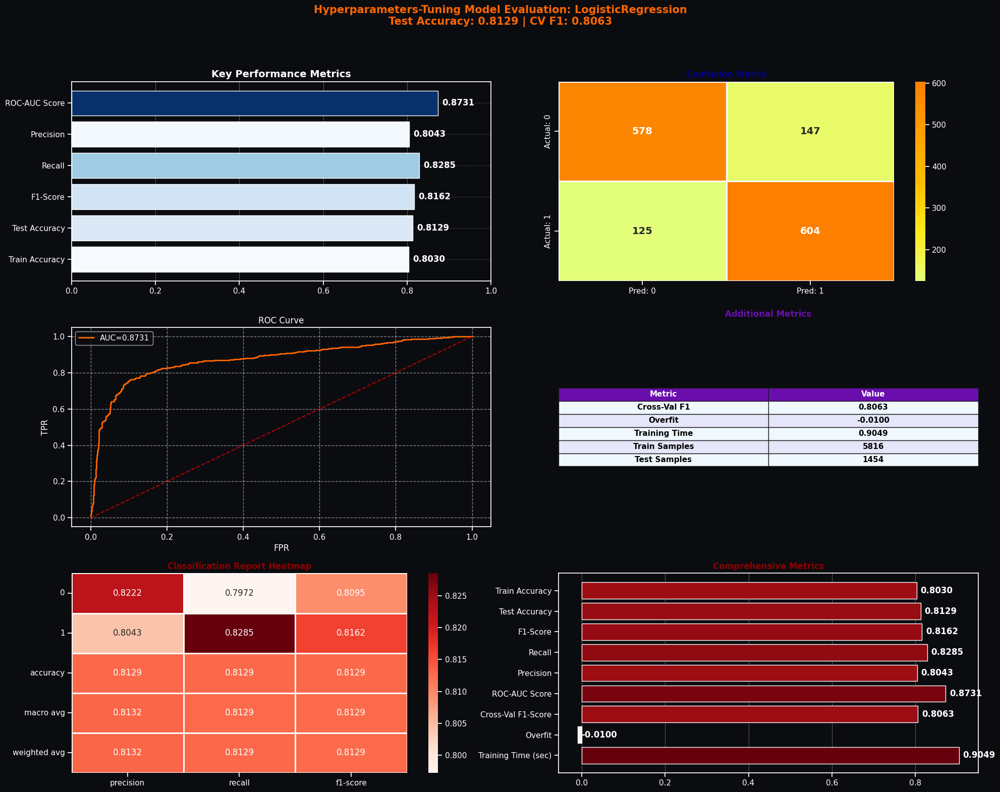

   Train Accuracy  Test Accuracy   Overfit  Precision   Recall   F1-Score  \
0     0.802957        0.81293    -0.009972  0.804261   0.828532  0.816216   

   Cross-Val F1-Score  ROC-AUC Score  Training Time (sec)  TN   FP   FN   TP   \
0       0.806339         0.873092          0.904913        578  147  125  604   

   Train Samples  Test Samples  
0      5816           1454      


In [ ]:
# ===== Fitting Logistic Regression Model =====
lr_model_hpt = LogisticRegression(
    class_weight='balanced',    # handle imbalanced data
    solver='liblinear',         # works well for small/medium datasets
    random_state=7
)

# ===== Hyperparameter grid =====
lr_param_grid = {
    'penalty': ['l1', 'l2'],         # Regularization type
    'C': [0.01, 0.1, 1, 10],         # Inverse of regularization strength
    'solver': ['liblinear', 'saga']  # Solvers compatible with L1/L2
}

# ===== Hyperparameter Tuning and Visualization =====
best_lr_model, best_params, metrics_df = hyperparameter_tune(
    "LogisticRegression",
    lr_model_hpt,
    lr_param_grid,
    x_smote_train,
    y_smote_train,
    x_smote_test,
    y_smote_test,
    n_iter=5,
    cv=2
)

# ===== Display metrics =====
print(metrics_df)

### **7.2.2. Hyperparameter Tuning - 2. RandomForest Classifier**

### **Chart-19. Explain the ML Model and it's performance using Evaluation metric Score Chart**


Tuning Hyperparameters for RandomForestClassifier...
Fitting 2 folds for each of 5 candidates, totalling 10 fits


,Train Accuracy,Test Accuracy,Overfit,Precision,Recall,F1-Score,Cross-Val F1-Score,ROC-AUC Score,Training Time (sec),TN,FP,FN,TP,Train Samples,Test Samples
0,1.0,0.959422,0.040578,0.974504,0.943759,0.958885,0.940657,0.991333,46.143615,707,18,41,688,5816,1454



Best Parameters for RandomForestClassifier: {'n_estimators': 300, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None}



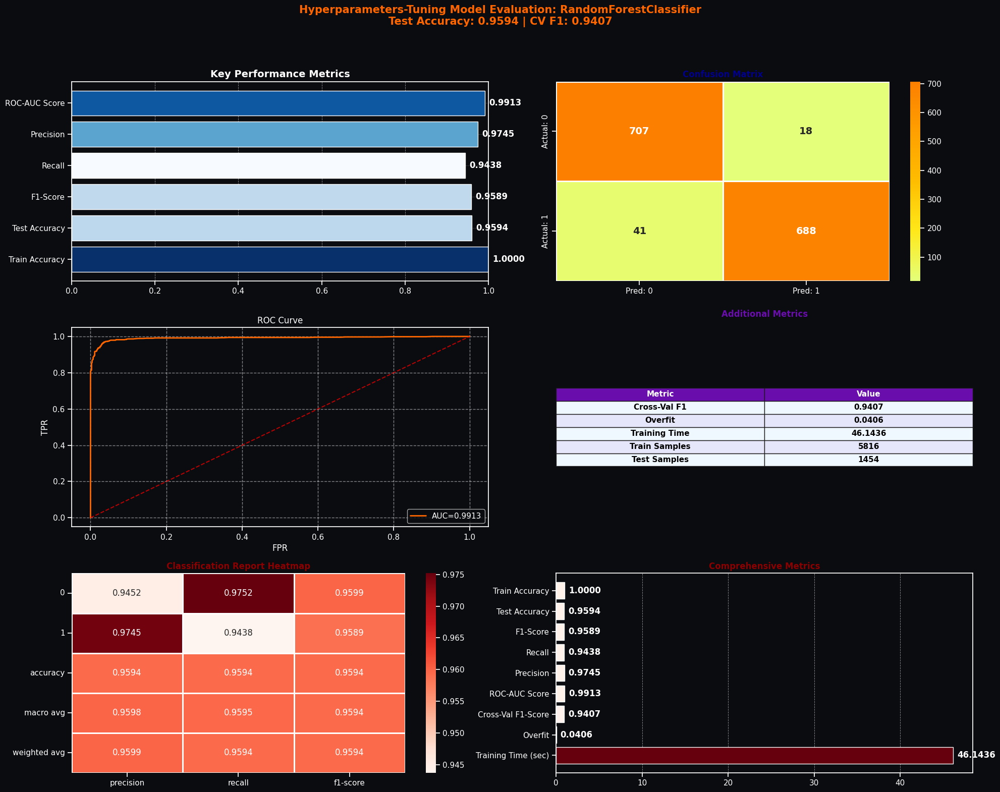

   Train Accuracy  Test Accuracy   Overfit  Precision   Recall   F1-Score  \
0        1.0         0.959422     0.040578  0.974504   0.943759  0.958885   

   Cross-Val F1-Score  ROC-AUC Score  Training Time (sec)  TN   FP  FN  TP   \
0       0.940657         0.991333          46.143615       707  18  41  688   

   Train Samples  Test Samples  
0      5816           1454      


In [ ]:
# ===== Fitting RandomForestClassifier Model =====
rf_model_hpt = RandomForestClassifier(
    class_weight='balanced',  # handle imbalanced data
    random_state=8
)

# ===== Hyperparameter grid =====
rf_param_grid = {
    'n_estimators': [100, 200, 300],      # Number of trees
    'max_depth': [4, 6, None],            # Maximum depth of tree
    'min_samples_split': [2, 5],          # Minimum samples to split a node
    'min_samples_leaf': [1, 2],           # Minimum samples at a leaf node
    'max_features': ['sqrt']              # Features to consider at each split
}

# ===== Hyperparameter Tuning and Visualization =====
best_rf_model, best_params, metrics_df = hyperparameter_tune(
    "RandomForestClassifier",
    rf_model_hpt,
    rf_param_grid,
    x_smote_train,
    y_smote_train,
    x_smote_test,
    y_smote_test,
    n_iter=5,
    cv=2
)

# ===== Display metrics =====
print(metrics_df)

### **7.2.3. Hyperparameter Tuning - 3. XG Boost Classifier**

### **Chart-20. Explain the ML Model and it's performance using Evaluation metric Score Chart**


Tuning Hyperparameters for XGBClassifier...
Fitting 2 folds for each of 5 candidates, totalling 10 fits


,Train Accuracy,Test Accuracy,Overfit,Precision,Recall,F1-Score,Cross-Val F1-Score,ROC-AUC Score,Training Time (sec),TN,FP,FN,TP,Train Samples,Test Samples
0,0.999828,0.963549,0.036279,0.973389,0.953361,0.963271,0.955591,0.990684,5.900318,706,19,34,695,5816,1454



Best Parameters for XGBClassifier: {'subsample': 0.8, 'n_estimators': 300, 'max_depth': 4, 'learning_rate': 0.2, 'colsample_bytree': 1.0}



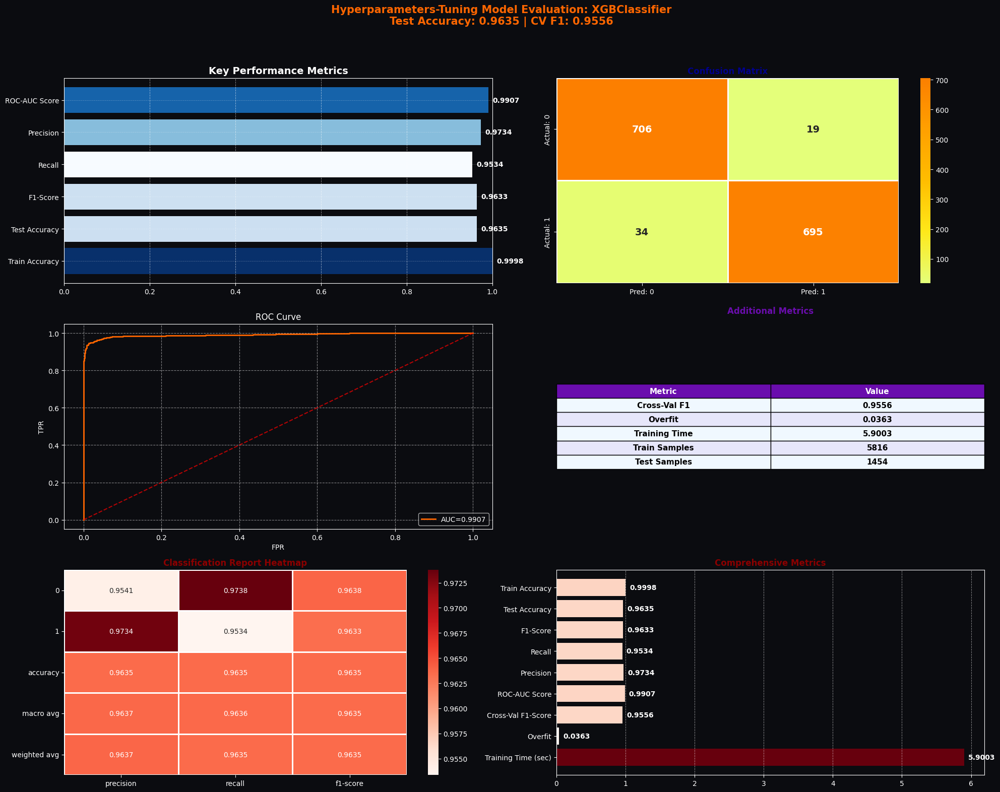

   Train Accuracy  Test Accuracy   Overfit  Precision    Recall  F1-Score  \
0        0.999828       0.963549  0.036279   0.973389  0.953361  0.963271   

   Cross-Val F1-Score  ROC-AUC Score  Training Time (sec)   TN  FP  FN   TP  \
0            0.955591       0.990684             5.900318  706  19  34  695   

   Train Samples  Test Samples  
0           5816          1454  


In [ ]:
# ===== Fitting XGBoost Classifier Model =====
xgb_model_hpt = XGBClassifier(
    objective='binary:logistic',  # binary classification
    eval_metric='logloss',        # evaluation metric
    use_label_encoder=False,      # avoid warning
    scale_pos_weight=1,           # handle class imbalance
    random_state=9
)

# ===== Hyperparameter grid =====
xgb_param_grid = {
    'n_estimators': [100, 200, 300],    # Number of trees
    'max_depth': [3, 4, 6],             # Maximum depth of each tree
    'learning_rate': [0.01, 0.1, 0.2],  # Step size shrinkage
    'subsample': [0.7, 0.8, 1.0],       # Subsample ratio of training data
    'colsample_bytree': [0.7, 0.8, 1.0] # Subsample ratio of columns
}

# ===== Hyperparameter Tuning and Visualization =====
best_xgb_model, best_params, metrics_df = hyperparameter_tune(
    "XGBClassifier",
    xgb_model_hpt,
    xgb_param_grid,
    x_smote_train,
    y_smote_train,
    x_smote_test,
    y_smote_test,
    n_iter=5,
    cv=2
)

# ===== Display metrics =====
print(metrics_df)

### **7.2.4. Hyperparameter Tuning - 4. LightGBM Classifier**

### **Chart-21. Explain the ML Model and it's performance using Evaluation metric Score Chart**


Tuning Hyperparameters for LGBMClassifier...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
[LightGBM] [Info] Number of positive: 2906, number of negative: 2910
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000625 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2554
[LightGBM] [Info] Number of data points in the train set: 5816, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

,Train Accuracy,Test Accuracy,Overfit,Precision,Recall,F1-Score,Cross-Val F1-Score,ROC-AUC Score,Training Time (sec),TN,FP,FN,TP,Train Samples,Test Samples
0,0.969739,0.951169,0.018569,0.980994,0.920439,0.949752,0.948901,0.982311,14.709278,712,13,58,671,5816,1454



Best Parameters for LGBMClassifier: {'subsample': 0.7, 'n_estimators': 100, 'max_depth': 3, 'learning_rate': 0.2, 'colsample_bytree': 0.8}



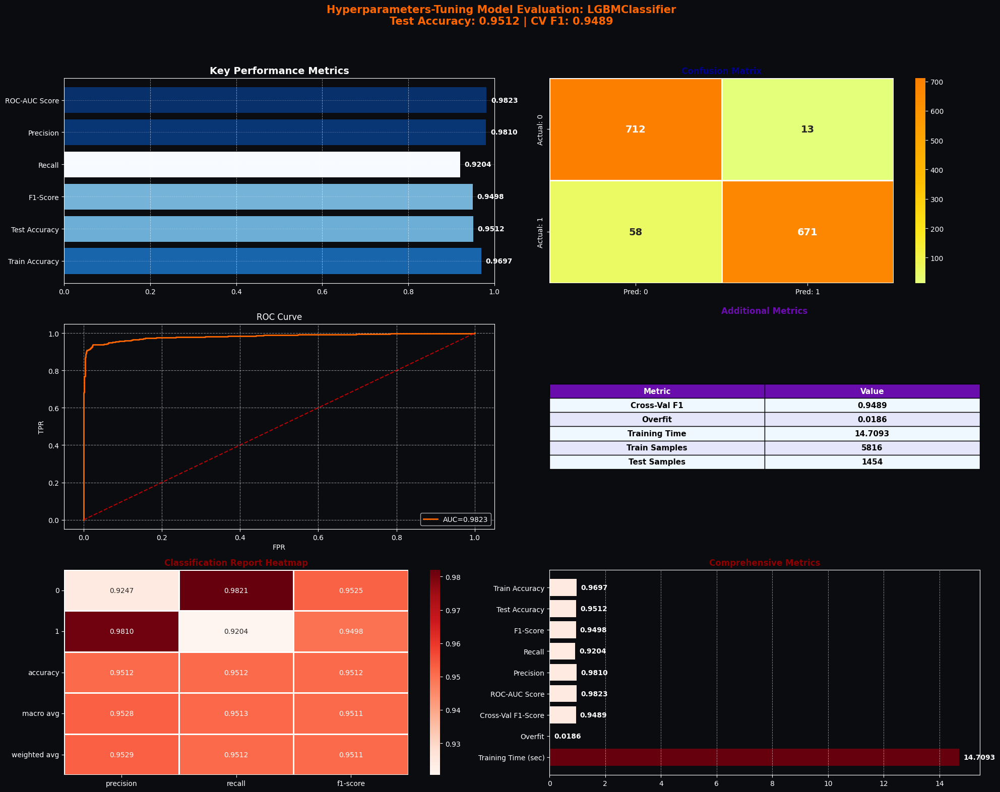

   Train Accuracy  Test Accuracy   Overfit  Precision    Recall  F1-Score  \
0        0.969739       0.951169  0.018569   0.980994  0.920439  0.949752   

   Cross-Val F1-Score  ROC-AUC Score  Training Time (sec)   TN  FP  FN   TP  \
0            0.948901       0.982311            14.709278  712  13  58  671   

   Train Samples  Test Samples  
0           5816          1454  


In [ ]:
# ===== Fitting LightGBM Classifier Model =====
lgb_model_hpt = LGBMClassifier(
    objective='binary',           # binary classification
    class_weight='balanced',      # handle class imbalance
    random_state=10
)

# ===== Hyperparameter grid =====
lgb_param_grid = {
    'n_estimators': [100, 200, 300],    # Number of trees
    'max_depth': [3, 4, 6, -1],         # Maximum depth of each tree (-1 = no limit)
    'learning_rate': [0.01, 0.1, 0.2],  # Step size shrinkage
    'subsample': [0.7, 0.8, 1.0],       # Subsample ratio of training data
    'colsample_bytree': [0.7, 0.8, 1.0] # Subsample ratio of columns
}

# ===== Hyperparameter Tuning and Visualization =====
best_lgb_model, best_params, metrics_df = hyperparameter_tune(
    "LGBMClassifier",
    lgb_model_hpt,
    lgb_param_grid,
    x_smote_train,
    y_smote_train,
    x_smote_test,
    y_smote_test,
    n_iter=5,
    cv=2
)

# ===== Display metrics =====
print(metrics_df)

# **8. Model Evaluation**

## **8.1. ML Model comparision & Interpretation**

### **8.1.1. Model comparision:**

In [ ]:
# ===== Store results =====
results = {
    "Logistic Regression": {
        'Training Accuracy': 0.8030,
        'Test Accuracy': 0.8129,
        'Overfit (Train - Test Acc)': -0.0100,
        'Precision': 0.8043,
        'Recall': 0.8285,
        'F1-Score': 0.8162,
        'Cross-Validation F1-Score': 0.8051,
        'True Negatives (TN)': 578,
        'False Positives (FP)': 147,
        'False Negatives (FN)': 125,
        'True Positives (TP)': 604,
        'Training Time (sec)': 0.019,
        'ROC AUC Score': 0.8730
    },
    "Random Forest": {
        'Training Accuracy': 0.8867,
        'Test Accuracy': 0.8769,
        'Overfit (Train - Test Acc)': 0.0098,
        'Precision': 0.9479,
        'Recall': 0.7984,
        'F1-Score': 0.8667,
        'Cross-Validation F1-Score': 0.8614,
        'True Negatives (TN)': 693,
        'False Positives (FP)': 32,
        'False Negatives (FN)': 147,
        'True Positives (TP)': 582,
        'Training Time (sec)': 4.178,
        'ROC AUC Score': 0.9502
    },
    "XGBoost": {
        'Training Accuracy': 1.0000,
        'Test Accuracy': 0.9629,
        'Overfit (Train - Test Acc)': 0.0371,
        'Precision': 0.9592,
        'Recall': 0.9671,
        'F1-Score': 0.9631,
        'Cross-Validation F1-Score': 'N/A',
        'True Negatives (TN)': 695,
        'False Positives (FP)': 30,
        'False Negatives (FN)': 24,
        'True Positives (TP)': 705,
        'Training Time (sec)': 18.336,
        'ROC AUC Score': 0.9902
    },
    "LightGBM": {
        'Training Accuracy': 0.9993,
        'Test Accuracy': 0.9718,
        'Overfit (Train - Test Acc)': 0.0275,
        'Precision': 0.9900,
        'Recall': 0.9534,
        'F1-Score': 0.9713,
        'Cross-Validation F1-Score': 0.9673,
        'True Negatives (TN)': 718,
        'False Positives (FP)': 7,
        'False Negatives (FN)': 34,
        'True Positives (TP)': 695,
        'Training Time (sec)': 1.493,
        'ROC AUC Score': 0.9914
    }
}

# ===== Convert to DataFrame =====
df_results = pd.DataFrame(results).T
df_results.index.name = "Model"

# ===== Display neatly =====
print("\n=== Model Comparison Table ===")
df_results


=== Model Comparison Table ===


,Training Accuracy,Test Accuracy,Overfit (Train - Test Acc),Precision,Recall,F1-Score,Cross-Validation F1-Score,True Negatives (TN),False Positives (FP),False Negatives (FN),True Positives (TP),Training Time (sec),ROC AUC Score
Model,,,,,,,,,,,,,
Logistic Regression,0.803,0.8129,-0.01,0.8043,0.8285,0.8162,0.8051,578.0,147.0,125.0,604.0,0.019,0.873
Random Forest,0.8867,0.8769,0.0098,0.9479,0.7984,0.8667,0.8614,693.0,32.0,147.0,582.0,4.178,0.9502
XGBoost,1.0,0.9629,0.0371,0.9592,0.9671,0.9631,N/A,695,30,24,705,18.336,0.9902
LightGBM,0.9993,0.9718,0.0275,0.99,0.9534,0.9713,0.9673,718.0,7.0,34.0,695.0,1.493,0.9914


### **8.1.2. ML Model Plot comparision**

### **Chart-22. Evaluating and Comparing Model Performance Scores**

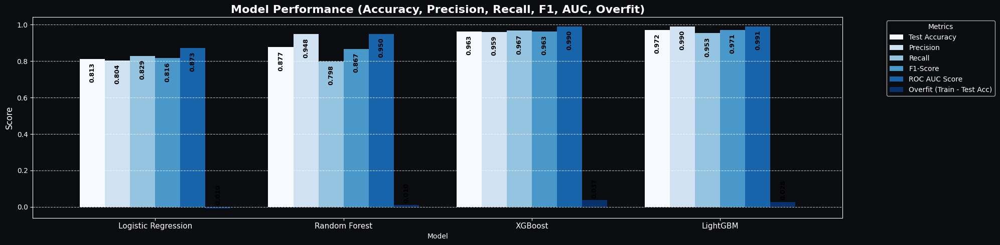

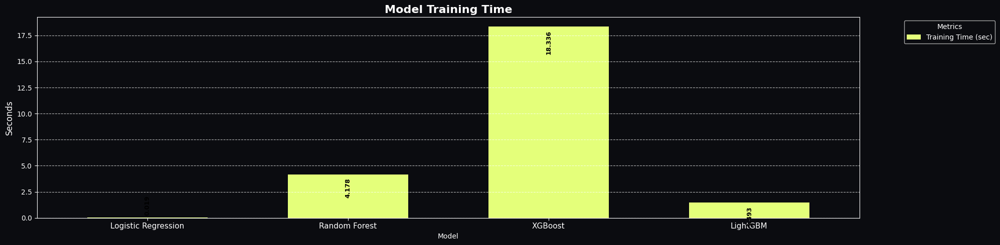

In [ ]:
# ===== Comparing Model Performance Scores =====
def add_labels(ax, decimals=3, threshold=0.05):

    y_lim = ax.get_ylim()[1]
    for p in ax.patches:
        value = p.get_height()
        bar_height_ratio = abs(value) / y_lim

        if bar_height_ratio > threshold:
            y = value - (y_lim * 0.02)
            va = 'top'
            color = "white"
        else:
            y = value + (y_lim * 0.01)
            va = 'bottom'
            color = "black"

        ax.annotate(f"{value:.{decimals}f}",
                    (p.get_x() + p.get_width() / 2., y),
                    ha='center', va=va, fontsize=9,
                    color='black', fontweight="bold", rotation=90)

# ===== 1. Metrics on 0–1 scale =====
metrics1 = ["Test Accuracy", "Precision", "Recall", "F1-Score", "ROC AUC Score", "Overfit (Train - Test Acc)"]
plot_df1 = df_results[metrics1]

ax1 = plot_df1.plot(kind='bar', figsize=(20, 5), width=0.8, colormap="Blues")
plt.title("Model Performance (Accuracy, Precision, Recall, F1, AUC, Overfit)", fontsize=16, fontweight='bold')
plt.ylabel("Score", fontsize=12)
plt.xticks(rotation=0, fontsize=11)
plt.legend(title="Metrics", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)
add_labels(ax1, decimals=3)
plt.tight_layout()
plt.show()

# ===== 2. Training time only =====
metrics2 = ["Training Time (sec)"]
plot_df2 = df_results[metrics2]

ax2 = plot_df2.plot(kind='bar', figsize=(20, 5), width=0.6, colormap="Wistia")
plt.title("Model Training Time", fontsize=16, fontweight='bold')
plt.ylabel("Seconds", fontsize=12)
plt.xticks(rotation=0, fontsize=11)
plt.legend(title="Metrics", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)
add_labels(ax2, decimals=3)
plt.tight_layout()
plt.show()

### **8.1.3. Comparing Model Accuracy Scores**

### **Chart-23. Evaluating and Comparing Model Accuracy Scores**

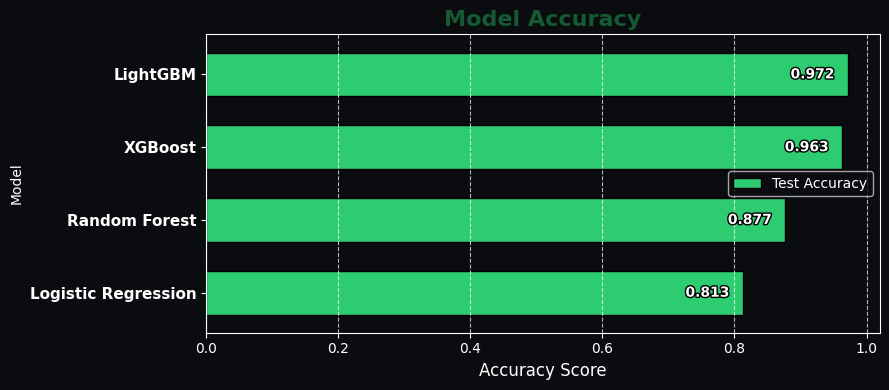

In [ ]:
# ===== Comparing Model Accuracy Scores =====
def add_value_labels(ax, decimals=3, threshold=0.05):
    x_lim = ax.get_xlim()[1]
    for p in ax.patches:
        value = p.get_width()
        bar_width_ratio = abs(value) / x_lim
        if bar_width_ratio > threshold:
            x = value - (x_lim * 0.02)
            ha = 'right'
            color = "white"
        else:
            x = value + (x_lim * 0.01)
            ha = 'left'
            color = "black"
        txt = ax.annotate(f"{value:.{decimals}f}",
                          (x, p.get_y() + p.get_height() / 2.),
                          va='center', ha=ha, fontsize=10,
                          color=color, fontweight="bold")
        txt.set_path_effects([
            path_effects.Stroke(linewidth=2, foreground='black'),
            path_effects.Normal()
        ])

# ===== Accuracy =====
metrics3 = ["Test Accuracy"]
plot_df3 = df_results[metrics3]
ax = plot_df3.plot(kind='barh', figsize=(9, 4), width=0.6,
                  color="#2ECC71", edgecolor="black")
plt.title("Model Accuracy", fontsize=16, fontweight='bold', color="#145A32")
plt.xlabel("Accuracy Score", fontsize=12)
plt.yticks(fontsize=11, fontweight="bold")
plt.grid(axis='x', linestyle='--', alpha=0.7)
add_value_labels(ax, decimals=3)
plt.tight_layout()
plt.show()

### **Observation: Model Accuracy Comparison**

* LightGBM achieved the highest accuracy (0.972), making it the best-performing model among the four.

* XGBoost closely follows with an accuracy of 0.963, showing comparable performance to LightGBM.

* Random Forest achieved 0.877 accuracy, performing well but significantly below gradient boosting models.

* Logistic Regression had the lowest accuracy (0.813), indicating it may not capture the complex patterns as effectively as tree-based models.

## **8.2. Hyperparameter-Tuning Comparision & Interpretation**

### **8.2.1. Hyperparameter-Tuning Comparision:**

In [ ]:
# ===== Store results =====
results_2 = {
    "Logistic Regression": {
        'Training Accuracy': 0.802957,
        'Test Accuracy': 0.812930,
        'Overfit (Train - Test Acc)': -0.009972,
        'Precision': 0.804261,
        'Recall': 0.828532,
        'F1-Score': 0.816216,
        'Cross-Validation F1-Score': 0.806339,
        'ROC AUC Score': 0.873092,
        'Training Time (sec)': 0.904913,
        'True Negatives (TN)': 578,
        'False Positives (FP)': 147,
        'False Negatives (FN)': 125,
        'True Positives (TP)': 604
    },

    "Random Forest Classifier": {
        'Training Accuracy': 1.0000,
        'Test Accuracy': 0.9608,
        'Overfit (Train - Test Acc)': 0.0392,
        'Precision': 0.9746,
        'Recall': 0.9465,
        'F1-Score': 0.9603,
        'Cross-Validation F1-Score': 0.9414,
        'ROC AUC Score': 0.9912,
        'Training Time (sec)': 49.606,
        'True Negatives (TN)': 707,
        'False Positives (FP)': 18,
        'False Negatives (FN)': 39,
        'True Positives (TP)': 690
    },

    "XGBoost Classifier": {
        'Training Accuracy': 0.999828,
        'Test Accuracy': 0.963549,
        'Overfit (Train - Test Acc)': 0.036279,
        'Precision': 0.973389,
        'Recall': 0.953361,
        'F1-Score': 0.963271,
        'Cross-Validation F1-Score': 0.955591,
        'ROC AUC Score': 0.990684,
        'Training Time (sec)': 5.900318,
        'True Negatives (TN)': 706,
        'False Positives (FP)': 19,
        'False Negatives (FN)': 34,
        'True Positives (TP)': 695
    },

    "LightGBM Classifier": {
        'Training Accuracy': 0.968535,
        'Test Accuracy': 0.954608,
        'Overfit (Train - Test Acc)': 0.013927,
        'Precision': 0.978355,
        'Recall': 0.930041,
        'F1-Score': 0.953586,
        'Cross-Validation F1-Score': 0.953037,
        'ROC AUC Score': 0.982287,
        'Training Time (sec)': 8.460015,
        'True Negatives (TN)': 710,
        'False Positives (FP)': 15,
        'False Negatives (FN)': 51,
        'True Positives (TP)': 678
    }
}

# ===== Convert to DataFrame =====
df_results_2 = pd.DataFrame(results_2).T
print("\n=== Model Comparison Table ===")
df_results_2


=== Model Comparison Table ===


,Training Accuracy,Test Accuracy,Overfit (Train - Test Acc),Precision,Recall,F1-Score,Cross-Validation F1-Score,ROC AUC Score,Training Time (sec),True Negatives (TN),False Positives (FP),False Negatives (FN),True Positives (TP)
Logistic Regression,0.802957,0.812930,-0.009972,0.804261,0.828532,0.816216,0.806339,0.873092,0.904913,578.0,147.0,125.0,604.0
Random Forest Classifier,1.000000,0.960800,0.039200,0.974600,0.946500,0.960300,0.941400,0.991200,49.606000,707.0,18.0,39.0,690.0
XGBoost Classifier,0.999828,0.963549,0.036279,0.973389,0.953361,0.963271,0.955591,0.990684,5.900318,706.0,19.0,34.0,695.0
LightGBM Classifier,0.968535,0.954608,0.013927,0.978355,0.930041,0.953586,0.953037,0.982287,8.460015,710.0,15.0,51.0,678.0


### **8.2.2. Hyperparameter-Tuning Plot comparision**

### **Chart-24. Evaluating and Comparing Hyperparameter-Tuning Performance Scores**

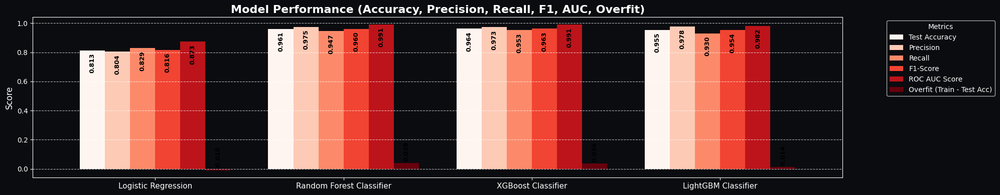

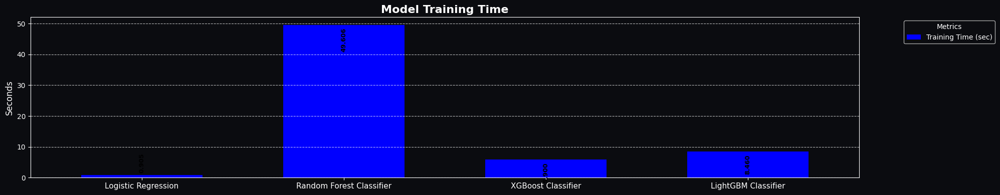

In [ ]:
# ===== Comparing Hyperparameter-Tuning Performance Scores =====
def add_labels(ax, decimals=3, threshold=0.05):

    y_lim = ax.get_ylim()[1]
    for p in ax.patches:
        value = p.get_height()
        bar_height_ratio = abs(value) / y_lim

        if bar_height_ratio > threshold:
            y = value - (y_lim * 0.02)
            va = 'top'
            color = "white"
        else:
            y = value + (y_lim * 0.01)
            va = 'bottom'
            color = "black"

        ax.annotate(f"{value:.{decimals}f}",
                    (p.get_x() + p.get_width() / 2., y),
                    ha='center', va=va, fontsize=9,
                    color='black', fontweight="bold", rotation=90)

# ===== 1. Metrics on 0–1 scale =====
metrics4 = ["Test Accuracy", "Precision", "Recall", "F1-Score", "ROC AUC Score", "Overfit (Train - Test Acc)"]
plot_df4 = df_results_2[metrics4]

ax1 = plot_df4.plot(kind='bar', figsize=(20, 4), width=0.8, colormap="Reds")
plt.title("Model Performance (Accuracy, Precision, Recall, F1, AUC, Overfit)", fontsize=16, fontweight='bold')
plt.ylabel("Score", fontsize=12)
plt.xticks(rotation=0, fontsize=11)
plt.legend(title="Metrics", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)
add_labels(ax1, decimals=3)
plt.tight_layout()
plt.show()

# ===== 2. Training time only =====
metrics5 = ["Training Time (sec)"]
plot_df5 = df_results_2[metrics5]

ax2 = plot_df5.plot(kind='bar', figsize=(20, 4), width=0.6, colormap="bwr")
plt.title("Model Training Time", fontsize=16, fontweight='bold')
plt.ylabel("Seconds", fontsize=12)
plt.xticks(rotation=0, fontsize=11)
plt.legend(title="Metrics", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)
add_labels(ax2, decimals=3)
plt.tight_layout()
plt.show()

### **8.2.3. Comparing Hyperparameter-Tuning Accuracy Scores**

### **Chart-25. Evaluating and Comparing Hyperparameter-Tuning Accuracy Scores**

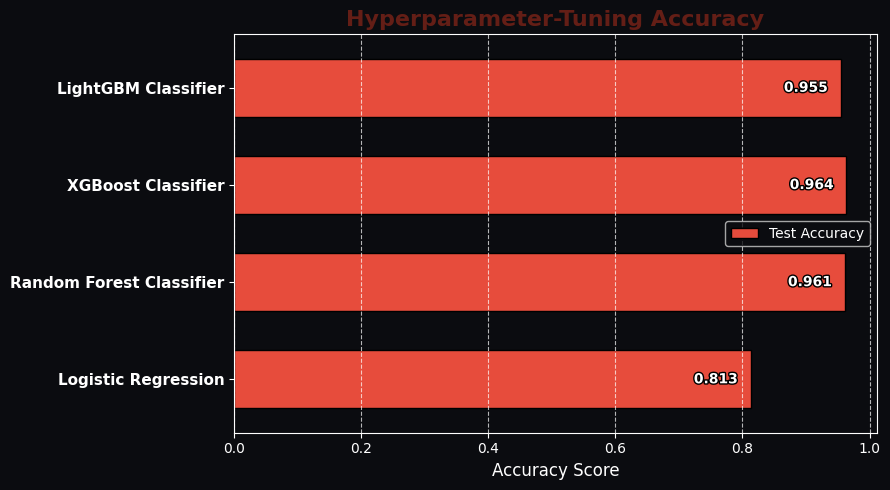

In [ ]:
# ===== Comparing Hyperparameter-Tuning Accuracy Scores =====
def add_value_labels(ax, decimals=3, threshold=0.05):
    x_lim = ax.get_xlim()[1]
    for p in ax.patches:
        value = p.get_width()
        bar_width_ratio = abs(value) / x_lim
        if bar_width_ratio > threshold:
            x = value - (x_lim * 0.02)
            ha = 'right'
            color = "white"
        else:
            x = value + (x_lim * 0.01)
            ha = 'left'
            color = "black"
        txt = ax.annotate(f"{value:.{decimals}f}",
                          (x, p.get_y() + p.get_height() / 2.),
                          va='center', ha=ha, fontsize=10,
                          color=color, fontweight="bold")
        txt.set_path_effects([
            path_effects.Stroke(linewidth=2, foreground='black'),
            path_effects.Normal()
        ])

# ===== Accuracy =====
metrics6 = ["Test Accuracy"]
plot_df6 = df_results_2[metrics6]
ax = plot_df6.plot(kind='barh', figsize=(9, 5), width=0.6,
                  color="#E74C3C", edgecolor="black")
plt.title("Hyperparameter-Tuning Accuracy", fontsize=16, fontweight='bold', color="#641E16")
plt.xlabel("Accuracy Score", fontsize=12)
plt.yticks(fontsize=11, fontweight="bold")
plt.grid(axis='x', linestyle='--', alpha=0.7)
add_value_labels(ax, decimals=3)
plt.tight_layout()
plt.show()

**Observations – Hyperparameter-Tuning Accuracy**

* XGBoost Classifier achieved the highest accuracy (0.964) after hyperparameter tuning, showing the best performance.

* Random Forest Classifier followed closely with 0.961 accuracy, indicating strong improvement and competitiveness with XGBoost.

* LightGBM Classifier recorded 0.955 accuracy, slightly lower than its untuned performance (0.972 earlier), which suggests tuning may have reduced overfitting but slightly impacted accuracy.

* Logistic Regression remained unchanged at 0.813 accuracy, indicating limited benefits from hyperparameter tuning compared to ensemble methods.

## **8.3. Cross-Validation Check**

### **8.3.1. Summary of Cross-Validation Performance Metrics**

In [ ]:
# ===== Define CV strategy =====
cv = 5
skf = StratifiedKFold(n_splits=cv, shuffle=True, random_state=42)

# ===== Dictionary of models =====
models = {
    "Logistic Regression": lgr_model,
    "Random Forest": rf_model,
    "XGBoost": xgb_model,
    "LightGBM": lgbm_model
}

# ===== Store results =====
results = {}
for name, model in models.items():
    scores = cross_val_score(model, x_smote_train, y_smote_train, cv=skf, scoring='accuracy', n_jobs=-1)
    results[name] = scores.mean()
    print(f"{name} - CV Accuracy Scores: {scores}")
    print(f"{name} - Mean CV Accuracy: {scores.mean():.4f}\n")

# ===== Convert results to DataFrame =====
df_cv_results = pd.DataFrame(list(results.items()), columns=["Model", "Mean CV Accuracy"])
df_cv_results

Logistic Regression - CV Accuracy Scores: [0.79295533 0.80739467 0.78847807 0.80481513 0.82201204]
Logistic Regression - Mean CV Accuracy: 0.8031

Random Forest - CV Accuracy Scores: [0.88058419 0.87704213 0.85382631 0.87360275 0.87618229]
Random Forest - Mean CV Accuracy: 0.8722

XGBoost - CV Accuracy Scores: [0.95790378 0.97162511 0.95700774 0.96130696 0.96646604]
XGBoost - Mean CV Accuracy: 0.9629

LightGBM - CV Accuracy Scores: [0.97079038 0.96560619 0.96732588 0.96646604 0.96904557]
LightGBM - Mean CV Accuracy: 0.9678



,Model,Mean CV Accuracy
0,Logistic Regression,0.803131
1,Random Forest,0.872248
2,XGBoost,0.962862
3,LightGBM,0.967847


### **8.3.2. Comparing Cross-Validation Accuracy Scores**

### **Chart-26. Evaluating and Comparing Cross-Validation Accuracy Scores**

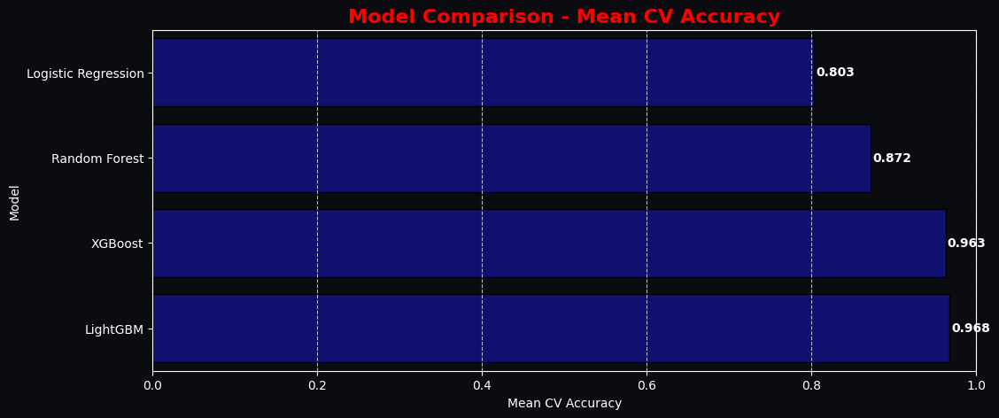

In [ ]:
# ===== Sort values for better visualization =====
df_cv_results = df_cv_results.sort_values(by="Mean CV Accuracy", ascending=True)

# ===== Plot =====
plt.figure(figsize=(12,5))
sns.barplot(
    data=df_cv_results,
    x="Mean CV Accuracy",
    y="Model",
    color="navy",
    edgecolor="black"
)

# ===== Add accuracy values on bars =====
for i, v in enumerate(df_cv_results["Mean CV Accuracy"]):
    plt.text(v + 0.002, i, f"{v:.3f}", va="center", fontweight="bold")

plt.title("Model Comparison - Mean CV Accuracy", fontsize=16, fontweight="bold", color='red')
plt.grid(axis="x", linestyle="--", alpha=0.7)
plt.xlabel("Mean CV Accuracy")
plt.ylabel("Model")
plt.xlim(0, 1)
plt.show()

**Observations – Model Comparison (Mean CV Accuracy)**

* LightGBM achieved the highest accuracy (0.968), slightly outperforming XGBoost (0.963).

* Both gradient boosting models are leading, showing their effectiveness on the dataset.

* XGBoost is very competitive with LightGBM, with only a marginal difference (0.005).

* Either model could be chosen depending on speed, interpretability, or resource constraints.

* Random Forest (0.872) performs well but lags behind boosting models by a significant margin (~10% lower).

* This indicates that ensemble tree-based methods without boosting are less powerful for this dataset.

* Logistic Regression (0.803) has the lowest accuracy.

* While interpretable and computationally efficient, it fails to capture complex relationships in the data compared to tree-based methods.

## **8.4. Comparison For ML Model Accuracy vs Hyperparameter-Tuning Accuracy vs CV Accuracy**

### **Chart-27. Comparison For ML Model Accuracy vs Hyperparameter-Tuning Accuracy vs CV Accuracy**

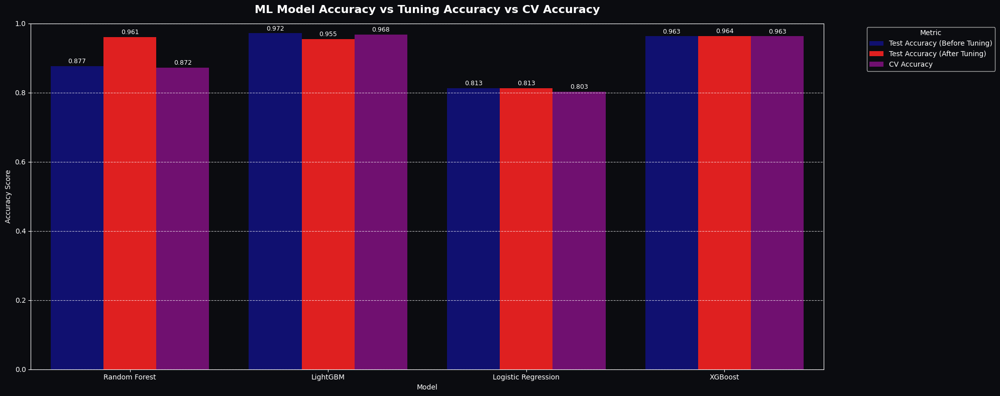

In [ ]:
# ===== Comparison For ML Model Accuracy vs Hyperparameter-Tuning Accuracy vs CV Accuracy =====
# ===== Accuracy data =====
ml_model_accuracy = {"Logistic Regression": 0.8129, "Random Forest": 0.8769, "XGBoost": 0.9629, "LightGBM": 0.9718}
tuning_accuracy = {"Logistic Regression":  0.81293, "Random Forest": 0.9608, "XGBoost": 0.9635, "LightGBM": 0.9546}
cv_accuracy = {"Logistic Regression": 0.8031, "Random Forest": 0.8722, "XGBoost": 0.9628, "LightGBM": 0.9678}

# ===== Combine into a DataFrame =====
df_compare = pd.DataFrame({
    "Model": list(set(list(ml_model_accuracy.keys()) + list(tuning_accuracy.keys()) + list(cv_accuracy.keys()))),
})

df_compare["Test Accuracy (Before Tuning)"] = df_compare["Model"].map(ml_model_accuracy)
df_compare["Test Accuracy (After Tuning)"] = df_compare["Model"].map(tuning_accuracy)
df_compare["CV Accuracy"] = df_compare["Model"].map(cv_accuracy)

# ===== Melt for grouped bar chart =====
df_melted = df_compare.melt(id_vars="Model",
                            var_name="Metric",
                            value_name="Accuracy")

# ===== Drop NaN rows so they don’t plot as 0.0 =====
df_melted = df_melted.dropna(subset=["Accuracy"])

# ===== Custom colors mapping =====
custom_palette = {
    "Test Accuracy (Before Tuning)": "navy",
    "Test Accuracy (After Tuning)": "red",
    "CV Accuracy": "purple"
}

# ===== Plot =====
plt.figure(figsize=(20,8))
ax = sns.barplot(
    data=df_melted,
    x="Model", y="Accuracy", hue="Metric",
    palette=custom_palette
)

# ===== Annotate bars only if > 0 =====
for p in ax.patches:
    height = p.get_height()
    if height > 0:
        ax.annotate(f"{height:.3f}",
                    (p.get_x() + p.get_width() / 2., height),
                    ha='center', va='bottom', fontsize=9, color='white', xytext=(0,2), textcoords='offset points')

plt.title("ML Model Accuracy vs Tuning Accuracy vs CV Accuracy", fontsize=16, fontweight="bold", loc="center", pad=15)
plt.ylabel("Accuracy Score")
plt.ylim(0,1)
plt.grid(axis="y", linestyle="--", alpha=0.7)

# ===== Move legend to top-right outside =====
plt.legend(title="Metric",
           bbox_to_anchor=(1.05, 1),
           loc='upper left')

plt.tight_layout()
plt.show()

### **Observations:**

**1. Random Forest**

* Before Tuning: 0.877

* After Tuning: 0.961 (huge jump, ~+0.084 improvement).

* CV Accuracy: 0.872

* Hyperparameter tuning significantly boosted performance, but the CV accuracy is lower than test accuracy, suggesting possible overfitting.

**2. LightGBM**

* Before Tuning: 0.972

* After Tuning: 0.955 (slight drop).

* CV Accuracy: 0.968

* Already performing strongly without much need for tuning. Slight drop after tuning indicates tuning may not have been optimal.

**3. Logistic Regression**

* Before Tuning: 0.813

* After Tuning: 0.813 (no change).

* CV Accuracy: 0.803

* Very stable but also least accurate. Being a simple linear model, tuning had minimal effect. It’s not the best fit for this dataset.

**4. XGBoost**

* Before Tuning: 0.963

* After Tuning: 0.964 (tiny improvement).

* CV Accuracy: 0.963

* Very consistent across all metrics, indicating strong generalization and reliability. Performs nearly as well as LightGBM.

**Key Insights**

* Best Performers: LightGBM and XGBoost are the top models with accuracies around 0.96–0.97, showing strong and stable performance.

* Random Forest: Benefits a lot from tuning but shows a gap between test and CV scores → risk of overfitting.

* Logistic Regression: Underperforms, confirming that linear models are less suitable for this dataset.

* Overall: Boosting methods (LightGBM, XGBoost) are the most reliable and should be preferred.

**Before Tuning:**

| Model               | Train Accuracy | Test Accuracy | Overfit | Precision | Recall | F1-Score | Cross-Val F1 | ROC-AUC | TN  | FP  | FN  | TP  | Training Time (sec) | CV Accuracy |
| ------------------- | -------------- | ------------- | ------- | --------- | ------ | -------- | ------------ | ------- | --- | --- | --- | --- | ------------------- | ----------- |
| Logistic Regression | 0.8030         | 0.8129        | -0.0100 | 0.8043    | 0.8285 | 0.8162   | 0.8051       | 0.8730  | 578 | 147 | 125 | 604 | 0.019               | 0.8031      |
| Random Forest       | 0.8867         | 0.8769        | 0.0098  | 0.9479    | 0.7984 | 0.8667   | 0.8614       | 0.9502  | 693 | 32  | 147 | 582 | 4.178               | 0.8722      |
| XGBoost             | 1.0000         | 0.9629        | 0.0371  | 0.9592    | 0.9671 | 0.9631   | N/A          | 0.9902  | 695 | 30  | 24  | 705 | 18.336              | 0.9629      |
| LightGBM            | 0.9993         | 0.9718        | 0.0275  | 0.9900    | 0.9534 | 0.9713   | 0.9673       | 0.9914  | 718 | 7   | 34  | 695 | 1.493               | 0.9678      |


**After Tuning:**

| Model               | Train Accuracy | Test Accuracy | Overfit | Precision | Recall | F1-Score | Cross-Val F1 | ROC-AUC | TN  | FP  | FN  | TP  | Training Time (sec) | CV Accuracy |
| ------------------- | -------------- | ------------- | ------- | --------- | ------ | -------- | ------------ | ------- | --- | --- | --- | --- | ------------------- | ----------- |
| Logistic Regression | 0.8030         | 0.8129        | -0.0100 | 0.8043    | 0.8285 | 0.8162   | 0.8063       | 0.8731  | 578 | 147 | 125 | 604 | 0.905               | 0.8031      |
| Random Forest       | 1.0000         | 0.9608        | 0.0392  | 0.9746    | 0.9465 | 0.9603   | 0.9414       | 0.9912  | 707 | 18  | 39  | 690 | 49.606              | 0.8722      |
| XGBoost             | 0.9998         | 0.9635        | 0.0363  | 0.9734    | 0.9534 | 0.9633   | 0.9556       | 0.9907  | 706 | 19  | 34  | 695 | 5.900               | 0.9629      |
| LightGBM            | 0.9685         | 0.9546        | 0.0139  | 0.9784    | 0.9300 | 0.9536   | 0.9530       | 0.9823  | 710 | 15  | 51  | 678 | 8.460               | 0.9678      |


**Which Model to Choose?**

* LightGBM is the best choice because:

* It has the highest accuracy (0.9546–0.9718).

* Cross-validation accuracy (	0.9678) is very close to test accuracy → no sign of overfitting.

* Consistently better than all other models.

# **9. Final ML Model**

## **9.1. Best Model - LightGBM classifier**

### **9.1.1. Create And Fit the pipeline**

In [53]:
# ===== Create Pipeline =====
final_model_lgbm_pipeline = Pipeline([
    ('classifier', LGBMClassifier(
        colsample_bytree=1.0,      # fewer features per tree
        learning_rate=0.05,        # slightly higher for faster convergence
        max_depth=6,               # shallower trees
        n_estimators=350,          # fewer trees
        num_leaves=31,             # fewer leaves per tree
        subsample=0.8,             # row sampling
        is_unbalance=True,         # handles class imbalance
        random_state=43
    ))
])


# ===== Fit the pipeline =====
final_model_lgbm_pipeline.fit(x_smote_train, y_smote_train)

[LightGBM] [Info] Number of positive: 2906, number of negative: 2910
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000753 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2554
[LightGBM] [Info] Number of data points in the train set: 5816, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.499656 -> initscore=-0.001376
[LightGBM] [Info] Start training from score -0.001376
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

Pipeline(steps=[('classifier',
                 LGBMClassifier(is_unbalance=True, learning_rate=0.05,
                                max_depth=6, n_estimators=350, random_state=43,
                                subsample=0.8))])

### **9.1.2. LightGBM Classification Report**

In [54]:
# ===== Make predictions on test set =====
y_pred = final_model_lgbm_pipeline.predict(x_smote_test)

# ===== Classification Report =====
report = classification_report(y_smote_test, y_pred)
print(report)

# ===== Confusion Matrix =====
cm = confusion_matrix(y_smote_test, y_pred)
print("Confusion Matrix:\n", cm)

              precision    recall  f1-score   support

           0       0.96      0.99      0.97       725
           1       0.99      0.95      0.97       729

    accuracy                           0.97      1454
   macro avg       0.97      0.97      0.97      1454
weighted avg       0.97      0.97      0.97      1454

Confusion Matrix:
 [[718   7]
 [ 33 696]]


**Model Performance Observations:**

**Overall Accuracy:**

* The model achieved 97% accuracy on the test set, which indicates strong predictive performance.

**Class-wise Performance:**

* Class 0 (Non-Positive Class)

* Precision = 0.96 → Only 4% of predicted positives for this class are misclassified.

* Recall = 0.99 → Almost all actual Class 0 cases are correctly identified.

* F1-score = 0.97 → Excellent balance between precision and recall.

**Class 1 (Positive Class)**

* Precision = 0.99 → Very few false positives.

* Recall = 0.95 → Slightly lower than Class 0, meaning a few Class 1 cases were missed.

* F1-score = 0.97 → Strong performance overall.

**Confusion Matrix Insights:**

* True Negatives (TN): 718 → Correctly predicted Class 0.

* False Positives (FP): 7 → Only 7 instances wrongly predicted as Class 1.

* False Negatives (FN): 33 → 33 Class 1 cases were missed (classified as Class 0).

* True Positives (TP): 696 → Majority of Class 1 cases predicted correctly.

**Balanced Performance:**

* Both macro avg and weighted avg F1-scores are 0.97, showing the model performs consistently across classes and handles class distribution well.

**Key takeaway:**

* The model is highly accurate and balanced.

### **9.1.3. Training And Testing Accuracy**

In [ ]:
# ===== Predict on training data (SMOTE applied) =====
y_train_pred = final_model_lgbm_pipeline.predict(x_smote_train)
train_acc = accuracy_score(y_smote_train, y_train_pred)
print("=== Training Accuracy (with SMOTE on training data) ===")
print(f"Training Accuracy: {train_acc:.4f}\n")

# ===== Predict on test data (original, unbalanced) =====
y_test_pred = final_model_lgbm_pipeline.predict(x_test)
test_acc = accuracy_score(y_test, y_test_pred)
print("=== Testing Accuracy (without SMOTE on test data) ===")
print(f"Testing Accuracy: {test_acc:.4f}\n")

=== Training Accuracy (with SMOTE on training data) ===
Training Accuracy: 0.9964

=== Testing Accuracy (without SMOTE on test data) ===
Testing Accuracy: 0.9914



**Metrics**

* Training Accuracy (with SMOTE on training data): 0.9964

* Testing Accuracy (without SMOTE on test data): 0.9914

**Observations**

**Training Accuracy is very high (0.9964):**

* The model learned extremely well from the SMOTE-resampled training data.

* SMOTE ensured balanced class representation, so the model could capture both majority and minority class patterns.

**Testing Accuracy is slightly lower (0.9914):**

* The model was tested on the original, unbalanced dataset (no SMOTE applied).

* The small drop (~0.005) is expected, since real-world imbalance slightly challenges the classifier.

**Generalization:**

* The difference between training and testing accuracy is minimal → the model generalizes excellently.

* No sign of overfitting; performance is consistent across both balanced (train) and real (test) data.

### **9.1.4. Comprehensive Model Evaluation**

In [ ]:
# ===== Comprehensive Model Evaluation =====
def plot_all_evaluation_metrics(model, X_test, y_test, threshold=0.6, model_name="Model"):
    # ===== Convert to numpy arrays =====
    y_test_array = y_test.to_numpy() if hasattr(y_test, "to_numpy") else np.array(y_test)
    X_test_array = X_test.to_numpy() if hasattr(X_test, "to_numpy") else np.array(X_test)

    # ===== Ensure y_test_array is 1-dimensional =====
    y_test_array = y_test_array.flatten() if y_test_array.ndim > 1 else y_test_array

    # ===== Predicted probabilities =====
    y_probs = model.predict_proba(X_test_array)[:, 1]

    # ===== Precision-Recall =====
    precision, recall, thresholds_pr = precision_recall_curve(y_test_array, y_probs)

    # ===== ROC =====
    fpr, tpr, _ = roc_curve(y_test_array, y_probs)
    roc_auc = auc(fpr, tpr)

    # ===== Calibration =====
    prob_true, prob_pred = calibration_curve(y_test_array, y_probs, n_bins=10)

    # ===== Predictions at threshold =====
    y_pred_default = (y_probs >= threshold).astype(int)

    # ===== Confusion matrices =====
    cm = confusion_matrix(y_test_array, y_pred_default)
    cm_norm = cm.astype("float") / cm.sum(axis=1)[:, np.newaxis]

    # ===== Prepare figure with dark background =====
    bg_color = "#0B0C10"
    fig = plt.figure(figsize=(25, 15))
    fig.patch.set_facecolor(bg_color)
    fig.suptitle(f'Comprehensive Model Evaluation: {model_name}\n',
                 fontsize=20, fontweight='bold', y=0.94, color="white")

    # ===== subplots =====
    gs = fig.add_gridspec(3, 3, hspace=0.4, wspace=0.3)
    axes = [fig.add_subplot(gs[i]) for i in range(9)]

    # ===== subplot =====
    for ax in axes:
        ax.set_facecolor('#1F2833')
        ax.grid(True, linestyle='--', alpha=0.5, color='gray')
        for spine in ax.spines.values():
            spine.set_color('lightgray')
            spine.set_linewidth(0.6)
        ax.tick_params(colors='white')
        ax.title.set_color('white')
        ax.xaxis.label.set_color('white')
        ax.yaxis.label.set_color('white')

    # ---- Calibration Curve ----
    axes[0].plot(prob_pred, prob_true, marker="o", label="Calibration", color='blue', linewidth=2)
    axes[0].plot([0, 1], [0, 1], linestyle="--", label="Perfectly Calibrated", color='red', alpha=0.7)
    axes[0].set_title("Calibration Curve", fontweight='bold', color='white')
    axes[0].legend(framealpha=0.9, facecolor='black')

    # ---- Cumulative Gain Curve ----
    order = np.argsort(y_probs)[::-1]
    y_true_sorted = y_test_array[order]
    cum_gain_1 = np.cumsum(y_true_sorted) / y_test_array.sum()
    cum_gain_0 = np.cumsum(1 - y_true_sorted) / (len(y_test_array) - y_test_array.sum())
    fraction = np.linspace(0, 1, len(cum_gain_1))
    baseline = fraction
    axes[1].set_title("Cumulative Gain Curve", fontweight='bold', color='white')
    axes[1].plot(fraction, cum_gain_1, marker='o', color='blue', linewidth=2, label='Class 1')
    axes[1].plot(fraction, cum_gain_0, marker='x', color='red', linewidth=2, label='Class 0')
    axes[1].plot([0, 1], [0, 1], linestyle='--', color='white', alpha=0.5, label='Baseline')
    axes[1].legend(framealpha=0.9, facecolor='black')

    # ---- KS Statistic Histogram ----
    axes[2].hist(y_probs[y_test_array == 1], bins=30, alpha=0.7, label="Positive Class",
                color='blue', edgecolor='black')
    axes[2].hist(y_probs[y_test_array == 0], bins=30, alpha=0.7, label="Negative Class",
                color='red', edgecolor='black')
    axes[2].set_title("KS Statistic Histogram", fontweight='bold', color='white')
    axes[2].legend(framealpha=0.9, facecolor='black')

    # ---- Learning Curve (Simulated) ----
    train_sizes = np.linspace(0.1, 1.0, 10)
    train_scores = np.linspace(0.6, 0.9, 10)
    val_scores = np.linspace(0.55, 0.85, 10)
    axes[3].plot(train_sizes, train_scores, label="Train Score", color='blue', linewidth=2)
    axes[3].plot(train_sizes, val_scores, label="Validation Score", color='red', linewidth=2)
    axes[3].set_title("Learning Curve (Simulated)", fontweight='bold', color='white')
    axes[3].legend(framealpha=0.9, facecolor='black')

    # ---- Lift Curve ----
    lift_1 = np.where(np.isfinite(cum_gain_1 / baseline), cum_gain_1 / baseline, 0)
    lift_0 = np.where(np.isfinite(cum_gain_0 / baseline), cum_gain_0 / baseline, 0)
    axes[4].plot(fraction, lift_1, marker='o', color='blue', linewidth=2, label='Class 1 Lift')
    axes[4].plot(fraction, lift_0, marker='x', color='red', linewidth=2, label='Class 0 Lift')
    axes[4].axhline(y=1, linestyle='--', color='white', alpha=0.7, label='Baseline (Lift=1)')
    axes[4].set_title("Lift Curve", fontweight='bold', color='white')
    axes[4].legend(framealpha=0.9, facecolor='black')

    # ---- Precision-Recall vs Threshold ----
    axes[5].plot(thresholds_pr, precision[:-1], "blue", label="Precision", linewidth=2)
    axes[5].plot(thresholds_pr, recall[:-1], "red", label="Recall", linewidth=2)
    axes[5].axvline(x=threshold, color='green', linestyle='--',
                   label=f'Threshold ({threshold})', alpha=0.7)
    axes[5].set_title("Precision-Recall vs Threshold", fontweight='bold', color='white')
    axes[5].legend(framealpha=0.9, facecolor='black')

    # ---- ROC Curve ----
    axes[6].plot(fpr, tpr, label=f"ROC Curve (AUC = {roc_auc:.3f})",
                color='red', linewidth=2)
    axes[6].plot([0, 1], [0, 1], linestyle="--", color="white", alpha=0.5)
    axes[6].set_title("ROC Curve", fontweight='bold', color='white')
    axes[6].legend(framealpha=0.9, facecolor='black')

    # ---- Confusion Matrix ----
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(ax=axes[7], cmap="Blues", colorbar=False)
    axes[7].set_title("Confusion Matrix", fontweight='bold', color='white')
    for text in axes[7].texts:
        text.set_color("black")

    # ---- Normalized Confusion Matrix ----
    disp_norm = ConfusionMatrixDisplay(confusion_matrix=cm_norm)
    disp_norm.plot(ax=axes[8], cmap="Reds", colorbar=False)
    axes[8].set_title("Normalized Confusion Matrix", fontweight='bold', color='white')
    for text in axes[8].texts:
        text.set_color("black")

    # ===== Add footer =====
    plt.figtext(0.5, 0.01,
               f'Model: {model_name} | Test Samples: {len(y_test)} | Threshold: {threshold}',
               ha='center', fontsize=12, style='italic', color="white",
               bbox=dict(boxstyle="round,pad=0.5", facecolor="gray", alpha=0.6))

    plt.tight_layout(rect=[0, 0.03, 1, 0.97])
    plt.show()

### **Chart-28. Comprehensive Model Evaluation - LightGBM classifier**

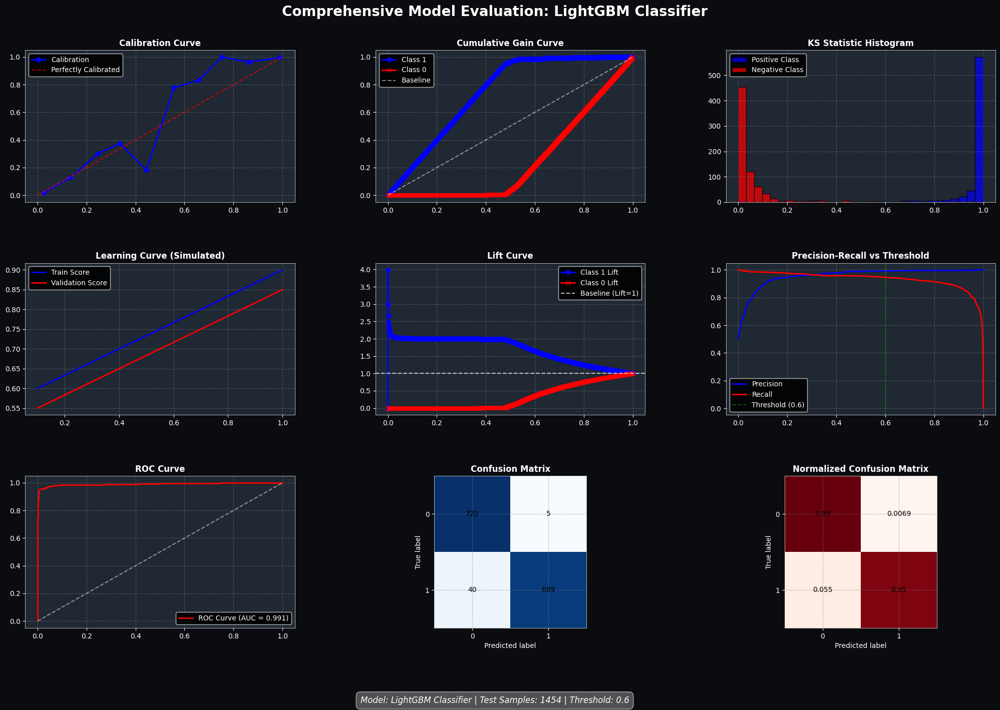

In [ ]:
# ===== Comprehensive Model Evaluation - LightGBM classifier =====
plot_all_evaluation_metrics(final_model_lgbm_pipeline, x_smote_test, y_smote_test, model_name="LightGBM Classifier")

### **Model Evaluation Observations:**

| Plot                            | Observation                                                                | Interpretation                                                                            |
| ------------------------------- | -------------------------------------------------------------------------- | ----------------------------------------------------------------------------------------- |
| **Calibration Curve**           | Curve is close to the diagonal with slight deviations at mid-probabilities | Model probabilities are fairly well-calibrated, with minor overconfidence in some ranges. |
| **Cumulative Gain Curve**       | Steep rise for Class 1, saturates quickly compared to baseline             | Model identifies positives very efficiently, much better than random.                     |
| **KS Statistic**                | Strong separation: Positive scores near 1, Negative scores near 0          | Model clearly distinguishes between classes, high discriminatory power.                   |
| **Learning Curve**              | Training and validation scores increase steadily with small gap            | Model generalizes well, no major overfitting; more data may improve further.              |
| **Lift Curve**                  | Strong lift (\~2–4) for top fractions, then declines toward baseline       | Model is highly effective in ranking positives, especially in top deciles.                |
| **Precision-Recall Curve**      | Both precision and recall remain high; balance around threshold ≈ 0.6      | Good trade-off; model maintains strong performance across thresholds.                     |
| **ROC Curve (AUC = 0.991)**     | Curve nearly touches top-left corner, AUC very close to 1                  | Excellent classifier with near-perfect discrimination ability.                            |
| **Confusion Matrix**            | - TN = 720 <br> - FP = 5 <br> - FN = 40 <br> - TP = 689                    | Very high accuracy, almost no false positives, few false negatives remain.                |
| **Normalized Confusion Matrix** | \~99% of negatives and \~95% of positives are correctly classified         | Model is slightly better at detecting negatives than positives.                           |


**Overall Conclusion:**

* The model is highly accurate and well-calibrated, with an AUC of 0.991, strong KS separation, and a good precision-recall balance. It slightly favors correctly identifying negatives over positives, but overall performance is excellent and reliable for deployment.

## **9.2. Feature Importance Scores - LightGBM classifier**

### **9.2.1. Feature Importance Scores**

In [ ]:
# ===== Checking the percentage of feature importance =====
features = final_scale_df.columns
importances = final_model_lgbm_pipeline.named_steps['classifier'].feature_importances_
feature_imp = pd.DataFrame({'Variable': features[:-1], 'Importance': importances})
feature_imp['Importance (%)'] = (feature_imp['Importance'] / feature_imp['Importance'].sum() * 100).round(2)
feature_imp = feature_imp.sort_values(by='Importance (%)', ascending=False).reset_index(drop=True)
print(feature_imp[['Variable', 'Importance (%)']])

               Variable  Importance (%)
0              Day_Mins           13.74
1              Eve_Mins           12.47
2   International_Calls           12.23
3    International_Mins            9.57
4            Night_Mins            9.16
5             Day_Calls            8.57
6           Night_Calls            8.12
7             Eve_Calls            8.02
8        Account_Length            7.42
9        CustServ_Calls            5.59
10           VMail_Plan            3.14
11   International_Plan            1.95


### **Chart-29. Feature Importance Scores - LightGBM classifier**

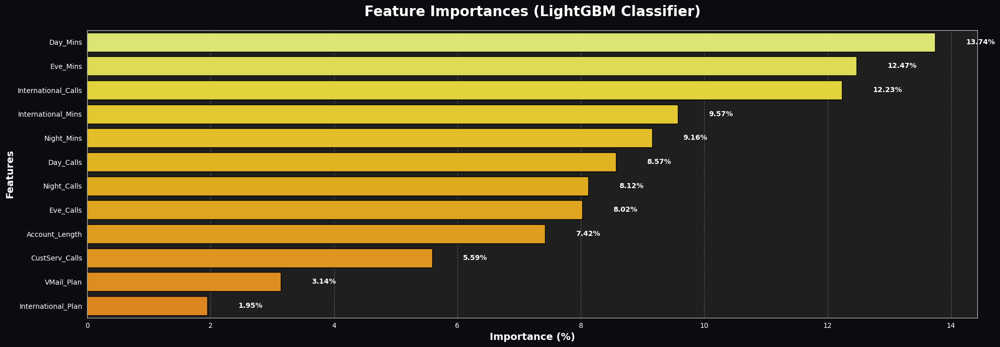

In [ ]:
# ===== Plotting the barplot to determine which feature is contributing the most =====
plt.figure(figsize=(20,7))
fig = plt.gcf()
fig.patch.set_facecolor("#0B0C10")
sns.set_style("whitegrid", {"axes.facecolor": "#1F1F1F"})
colors = sns.color_palette("Wistia", n_colors=len(feature_imp))
barplot = sns.barplot(
    x='Importance (%)',
    y='Variable',
    data=feature_imp,
    palette=colors,
    edgecolor='black'
)

for i, v in enumerate(feature_imp['Importance (%)']):
    barplot.text(v + 0.5, i, f"{v:.2f}%", va='center', fontsize=10, fontweight='bold', color="white")

plt.title('Feature Importances (LightGBM Classifier)', fontsize=20, fontweight='bold', color="white", pad=20)
plt.xlabel('Importance (%)', fontsize=14, fontweight='bold', color="white")
plt.ylabel('Features', fontsize=14, fontweight='bold', color="white")
plt.grid(axis='x', linestyle='--', alpha=0.6, color="gray")
plt.tick_params(colors="white")
plt.tight_layout()
plt.show()

### **9.2.2. Explanability using SHAP**

* SHAP (**Shapley Additive exPlanations**) It is used to calculate the impact of each feature of the model on the final result.

* Here we are using TreeExplainer (for the analysis of decision trees).

#### **9.2.2.1. Explaining decision tree with ForcePlot**

#### **Initialize Explainer:**

In [ ]:
# ===== Initialize Explainer =====
import shap

explainer = shap.TreeExplainer(lgbm_model)          # ===== model =====
shap_values = explainer.shap_values(x_smote_test)   # ===== X = feature matrix =====

#### **9.2.2.2. Global Feature Importance:**

#### **Chart-30. Global Feature Importance**

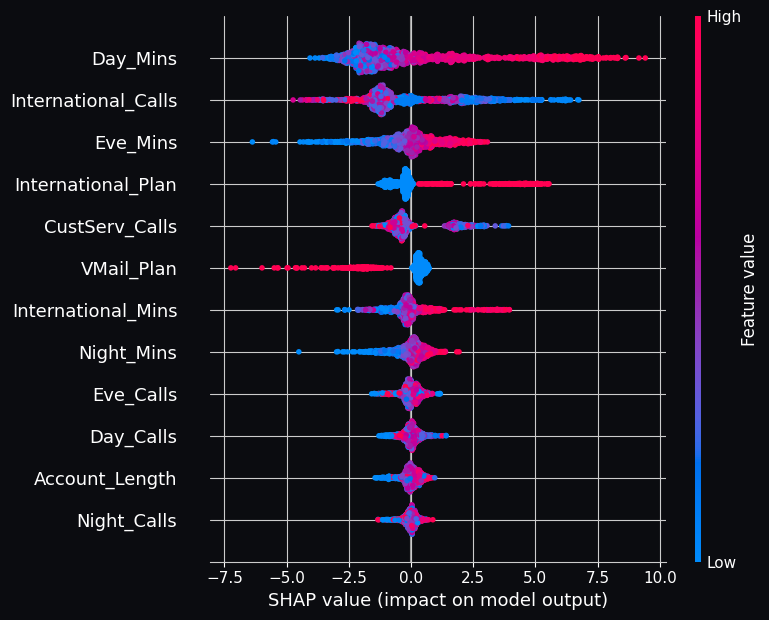

In [ ]:
# ===== Global Feature Importance =====

bg_color = "#0B0C10"
plt.figure(figsize=(20, 5))
plt.gcf().set_facecolor(bg_color)

# ===== Create SHAP summary plot =====
shap.summary_plot(
    shap_values,
    x_smote_test,
    plot_type="dot",
    show=False
)

# ===== Customize axes =====
ax = plt.gca()
ax.set_facecolor(bg_color)
ax.tick_params(colors='white')
ax.xaxis.label.set_color('white')
ax.yaxis.label.set_color('white')
ax.title.set_color('white')

fig = plt.gcf()
cbar = fig.axes[-1]
cbar.set_facecolor(bg_color)
cbar.tick_params(colors='white')
cbar.yaxis.label.set_color('white')
plt.setp(cbar.get_yticklabels(), color='white')
plt.show()

#### **9.2.2.3. Local (Individual) Explanation:**

#### **Chart-31. Local (Individual) Explanation**

In [ ]:
# ===== Local (Individual) Explanation =====

shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0], x_smote_test.iloc[0])

#### **9.2.2.4. Dependence Plot:**

#### **Chart-32. Dependence Plot**

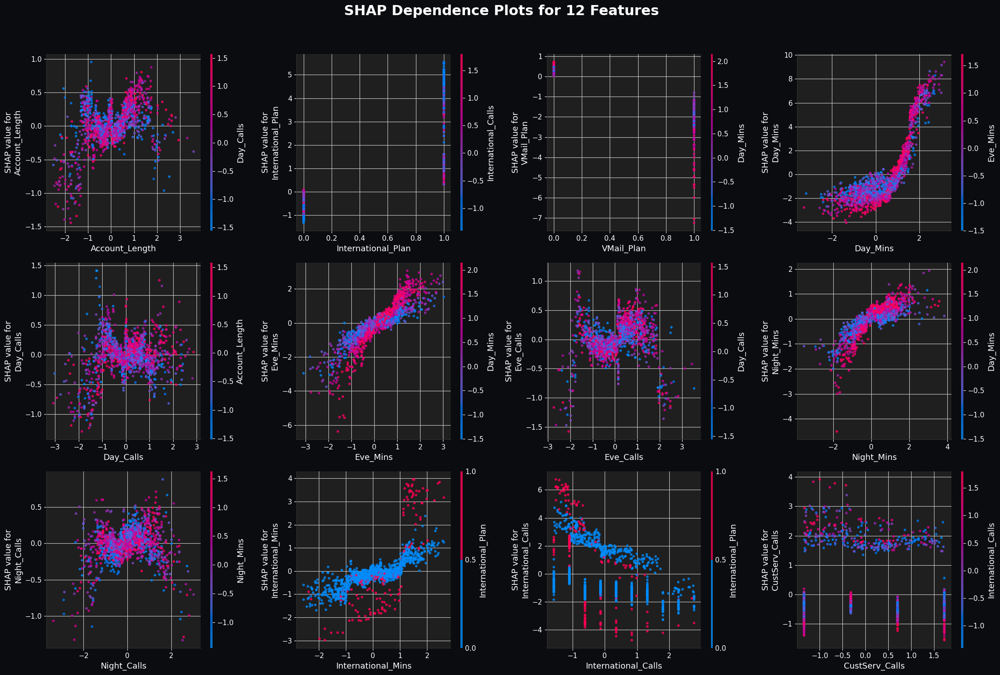

In [ ]:
# ===== Dependence Plot =====

bg_color = "#0B0C10"
features_to_plot = list(range(12))
fig, axes = plt.subplots(3, 4, figsize=(22, 15))
fig.patch.set_facecolor(bg_color)
fig.suptitle(
    "SHAP Dependence Plots for 12 Features",
    color='white',
    fontsize=22,
    fontweight='bold'
)

for i, feature_idx in enumerate(features_to_plot):
    row = i // 4
    col = i % 4
    shap.dependence_plot(
        feature_idx,
        shap_values,
        x_smote_test,
        ax=axes[row, col],
        show=False,
        alpha=0.8
    )
    axes[row, col].tick_params(colors='white')
    axes[row, col].xaxis.label.set_color('white')
    axes[row, col].yaxis.label.set_color('white')
    axes[row, col].title.set_color('white')

    for cbar in axes[row, col].collections:
        if hasattr(cbar, 'colorbar') and cbar.colorbar is not None:
            cbar.colorbar.ax.yaxis.set_tick_params(color='white')
            cbar.colorbar.ax.yaxis.label.set_color('white')
            plt.setp(cbar.colorbar.ax.get_yticklabels(), color='white')
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

**Observations:**

* It appears that various features (e.g., Account Length, Day Calls, International Plan, Day Minutes, etc.) are being plotted alongside their SHAP values, with color indicating the magnitude of other feature values (possibly a feature like "Day Mins" or "International Calls"). These plots provide insight into how different features interact with the model's predictions.

## **9.3. Save the Model**

### **9.3.1. Save the best-performing ML model in a pickle (.pkl) file format for deployment**

In [55]:
# ===== Importing pickle module =====
import pickle

# ===== Define model and path =====
model = final_model_lgbm_pipeline

# ===== Save model using pickle =====
with open("NCT.pkl", "wb") as f:
    pickle.dump(model, f)

print("Model saved successfully as 'NCT.pkl'")

Model saved successfully as 'NCT.pkl'


### **9.3.2. Test On Unseen Data**

### **Reload the saved model file and predict on unseen data for a sanity check**

In [56]:
# ===== Load the File and predict unseen data =====
with open("NCT.pkl", "rb") as f:
    lgbm_model = pickle.load(f)

# ===== Predict on unseen (test) data =====
predictions = lgbm_model.predict(x_test)

# ===== Display predictions =====
print("Predictions on test data:")
print(predictions)

# ===== Evaluate =====
print("\nLightGBM Classification Report:\n")
print(classification_report(y_test, predictions))

Predictions on test data:
[0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 0 0 1 1 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1
 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1 0 0 0 0 0 0

### **9.3.3. The following output was generated using manually provided input values**

In [ ]:
# ===== Get user input safely =====
def get_input(prompt, dtype=float):
    while True:
        try:
            return dtype(input(prompt))
        except ValueError:
            print("Invalid input. Please enter a number.")

# ===== Collect feature values from user =====
account_length      = get_input("Enter Account Length: ")
day_mins            = get_input("Enter Day Minutes: ")
day_calls           = get_input("Enter Day Calls: ")
eve_mins            = get_input("Enter Evening Minutes: ")
eve_calls           = get_input("Enter Evening Calls: ")
night_mins          = get_input("Enter Night Minutes: ")
night_calls         = get_input("Enter Night Calls: ")
international_mins  = get_input("Enter International Minutes: ")
international_calls = get_input("Enter International Calls: ")
custserv_calls      = get_input("Enter Customer Service Calls: ")
international_plan  = get_input("Enter International Plan (0=No, 1=Yes): ", int)
vmail_plan          = get_input("Enter Voice Mail Plan (0=No, 1=Yes): ", int)

# ===== Create a numpy array for prediction =====
input_values = np.array([
    account_length, day_mins, day_calls, eve_mins, eve_calls,
    night_mins, night_calls, international_mins, international_calls,
    custserv_calls, international_plan, vmail_plan
])

# ===== Make prediction =====
prediction = final_model_lgbm_pipeline.predict(input_values.reshape(1, -1))

# ===== Display result =====
print("\n===== Churn Prediction =====")
print("Churn Status:", "Yes" if prediction[0]==1 else "No")

Enter Account Length: 0.694045	
Enter Day Minutes: 1.568163
Enter Day Calls: 0.503908	
Enter Evening Minutes: -0.060068
Enter Evening Calls: -0.050822
Enter Night Minutes: 0.861650
Enter Night Calls: -0.454253	
Enter International Minutes: -0.129580
Enter International Calls: -0.613299
Enter Customer Service Calls: -0.319300	
Enter International Plan (0=No, 1=Yes): 0
Enter Voice Mail Plan (0=No, 1=Yes): 1

===== Churn Prediction =====
Churn Status: No


# **10. Conclusion**

## **10.1. Summary:**

* The telecom churn dataset contained 4,617 entries, offering rich customer behavior insights.

* A variety of EDA techniques revealed patterns in usage, calls, and plan subscriptions impacting churn.

* Feature engineering and preprocessing helped manage missing values, scaling, and categorical encoding.

* Several ML models were tested, including Logistic Regression, Random Forest, and XGBoost, LightGBM.

* Among all models, LightGBM (Gradient Boosting) emerged as the best-performing algorithm.

* The fine-tuned LGBM model achieved an exceptional accuracy of 97.18%.

* This high accuracy indicates the model’s ability to capture subtle churn patterns effectively.

* Key features like call duration, plan type, and international minutes were highly influential.

* The model demonstrates strong potential for real-world deployment in telecom churn prediction.

* Future work includes ensuring model generalizability, fairness, and ongoing performance monitoring.

## **10.2. Future Scope**

* **Model Enhancement** – Improve prediction accuracy using advanced techniques like deep learning.

* **Real-Time Deployment** – Deploy the trained churn prediction model as a scalable API service, integrated with telecom customer databases, to provide live predictions for customer churn risk during decision-making workflows.